In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'

In [2]:
fidcov = np.load('Run_062718/bolp_20p0_0.npz')
fidvd = np.load('Run_062718/bolp_20p0_0_vd.npz')

In [3]:
print fidcov.files
print fidvd.files

['func_all', 'param', 'func_all_cov']
['vpf', 'deltasigma']


In [47]:
np.logspace(-1,1.5,20)

array([  0.1       ,   0.13538762,   0.18329807,   0.24816289,
         0.33598183,   0.45487779,   0.61584821,   0.83378222,
         1.12883789,   1.52830673,   2.06913808,   2.80135676,
         3.79269019,   5.13483291,   6.95192796,   9.41204967,
        12.74274986,  17.2521055 ,  23.35721469,  31.6227766 ])

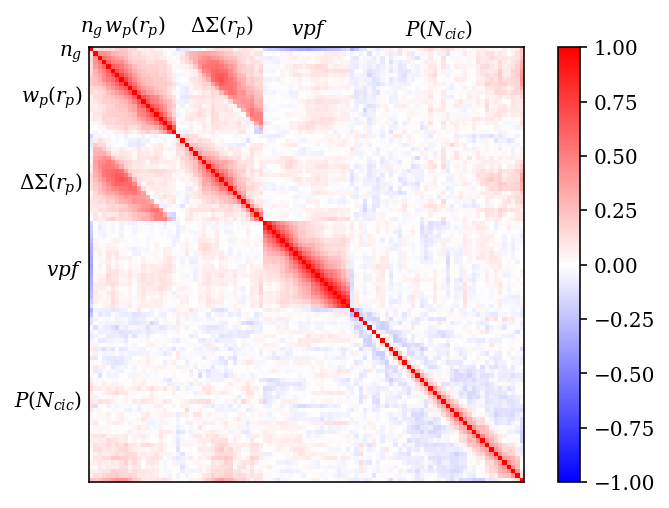

In [38]:
cov1 = np.cov(fidcov['func_all'].T)
plt.imshow((cov1.T/np.sqrt(np.diag(cov1))).T/np.sqrt(np.diag(cov1)),cmap='bwr',vmin=-1,vmax=1)
plt.xticks((0,10,30,50,80),(r'$n_g$',r'$w_p(r_p)$',r'$\Delta\Sigma(r_p)$',r'$vpf$',r'$P(N_{cic})$'))
plt.yticks((0,10,30,50,80),(r'$n_g$',r'$w_p(r_p)$',r'$\Delta\Sigma(r_p)$',r'$vpf$',r'$P(N_{cic})$'))
plt.tick_params(length=0,labeltop='on',labelbottom='off')
plt.colorbar()

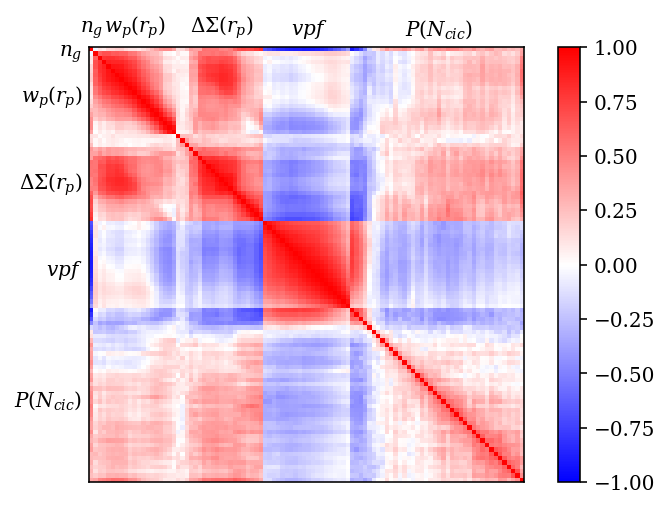

In [39]:
cov2 = cov1 + fidcov['func_all_cov'][0]
plt.imshow((cov2.T/np.sqrt(np.diag(cov2))).T/np.sqrt(np.diag(cov2)),cmap='bwr',vmin=-1,vmax=1)
plt.xticks((0,10,30,50,80),(r'$n_g$',r'$w_p(r_p)$',r'$\Delta\Sigma(r_p)$',r'$vpf$',r'$P(N_{cic})$'))
plt.yticks((0,10,30,50,80),(r'$n_g$',r'$w_p(r_p)$',r'$\Delta\Sigma(r_p)$',r'$vpf$',r'$P(N_{cic})$'))
plt.tick_params(length=0,labeltop='on',labelbottom='off')
plt.colorbar()

In [4]:
cov = fidcov['func_all_cov'][0]+np.cov(fidcov['func_all'].T)
cov[40:60,40:60] += np.cov(fidvd['vpf'].T)
cov[20:40,20:40] += np.cov(fidvd['deltasigma'].T)

In [5]:
cov

array([[  2.07253280e-08,  -1.16377097e-04,   2.62352081e-04, ...,
          9.51204481e-09,   8.13235812e-09,   9.11575885e-08],
       [ -1.16377097e-04,   3.80050232e+02,   1.94527591e+02, ...,
          5.34038680e-04,   8.75999775e-04,   1.31582767e-02],
       [  2.62352081e-04,   1.94527591e+02,   2.51491907e+02, ...,
          7.32575410e-04,   8.56953461e-04,   1.40691902e-02],
       ..., 
       [  9.51204481e-09,   5.34038680e-04,   7.32575410e-04, ...,
          5.45284639e-08,   3.50625273e-08,   1.58748074e-07],
       [  8.13235812e-09,   8.75999775e-04,   8.56953461e-04, ...,
          3.50625273e-08,   4.95442435e-08,   1.85497544e-07],
       [  9.11575885e-08,   1.31582767e-02,   1.40691902e-02, ...,
          1.58748074e-07,   1.85497544e-07,   3.48223441e-06]])

In [36]:
max(np.linalg.eigvals(cov))
#Try making cut at eigval=1e-2

958.6537855103013

In [9]:
cov_w = cov[:20,:20]
cov_wd = cov[:40,:40]
cov_wv = np.block([[cov[:20,:20],cov[:20,40:60]],\
              [cov[40:60,:20],cov[40:60,40:60]]])
cov_wc = np.block([[cov[:20,:20],cov[:20,60:]],\
              [cov[60:,:20],cov[60:,60:]]])
cov_wdv = cov[:60,:60]
cov_wdc = np.block([[cov[:40,:40],cov[:40,60:]],\
              [cov[60:,:40],cov[60:,60:]]])
cov_wvc = np.block([[cov[:20,:20],cov[:20,40:]],\
              [cov[40:,:20],cov[40:,40:]]])
cov_wdvc = cov
cov_d = cov[20:40,20:40]
cov_v = cov[40:60,40:60]
cov_c = cov[60:,60:]

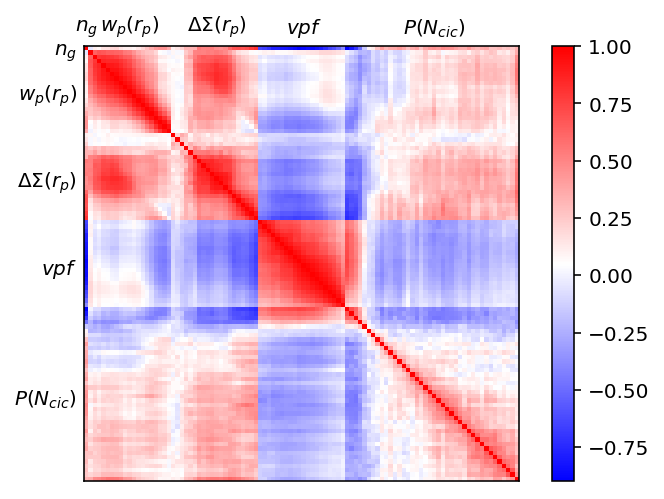

In [6]:
plt.imshow((cov.T/np.sqrt(np.diag(cov))).T/np.sqrt(np.diag(cov)),cmap='bwr')
plt.xticks((0,10,30,50,80),(r'$n_g$',r'$w_p(r_p)$',r'$\Delta\Sigma(r_p)$',r'$vpf$',r'$P(N_{cic})$'))
plt.yticks((0,10,30,50,80),(r'$n_g$',r'$w_p(r_p)$',r'$\Delta\Sigma(r_p)$',r'$vpf$',r'$P(N_{cic})$'))
plt.tick_params(length=0,labeltop='on',labelbottom='off')
plt.colorbar()

In [44]:
print np.linalg.eigvals(cov)[:5]
print np.linalg.eigvals(cov_w)[:5]
print np.linalg.eigvals(cov_d)[:5]
print np.linalg.eigvals(cov_v)[:5]
print np.linalg.eigvals(cov_c)[:5]

[ 958.65378551  149.1012553    61.60155028   32.96141497   20.57037401]
[ 958.40574934  149.0828733    61.584288     32.93916421   20.5650599 ]
[ 1.05344563  0.48930451  0.35802855  0.22543131  0.11106468]
[  2.52563886e-04   2.14353419e-05   6.75785777e-06   3.78118709e-06
   2.45355414e-06]
[  2.39753212e-05   5.25301837e-06   3.65646831e-06   3.43847594e-06
   3.15565635e-06]


In [67]:
print np.linalg.eig(cov)[0]
print np.linalg.eig(cov)[1][:5]
print '-------------------'
print np.linalg.eig(cov_w)[1][:5]
print '-------------------'
print np.linalg.eig(cov_d)[1][:5]
print '-------------------'
print np.linalg.eig(cov_v)[1][:5]
print '-------------------'
print np.linalg.eig(cov_c)[1][:5]

[  9.58653786e+02   1.49101255e+02   6.16015503e+01   3.29614150e+01
   2.05703740e+01   1.52643536e+01   7.55903328e+00   5.99031124e+00
   3.48705085e+00   1.90138071e+00   1.17726567e+00   9.59983494e-01
   7.73639818e-01   4.99576047e-01   4.31275634e-01   3.86882090e-01
   2.42938468e-01   1.89505930e-01   1.50425127e-01   1.20708084e-01
   9.89268381e-02   8.01292332e-02   5.80707074e-02   4.59529588e-02
   4.00096609e-02   3.00645745e-02   1.56794178e-02   7.87220338e-03
   5.63337334e-03   4.84303865e-03   2.05216887e-03   1.70714790e-03
   9.56106686e-04   8.11514233e-04   7.09433830e-04   5.69730636e-04
   3.13579754e-04   1.76525766e-04   1.48667447e-04   6.84203195e-05
   1.38421908e-05   6.00783616e-06   4.17262034e-06   3.40757761e-06
   3.29594640e-06   2.95417254e-06   2.73438657e-06   2.42806994e-06
   2.22506190e-06   2.09984232e-06   1.69197378e-06   1.66972705e-06
   1.33432864e-06   1.24910327e-06   1.21828441e-06   1.07669627e-06
   8.99255514e-07   8.19168895e-07

In [14]:
np.linalg.eigvals(cov_d)

array([  1.05344563e+00,   4.89304507e-01,   3.58028554e-01,
         2.25431312e-01,   1.11064680e-01,   6.68715341e-02,
         4.14006425e-02,   2.71541557e-02,   1.43357002e-02,
         8.94188990e-03,   6.64814436e-03,   4.94791433e-03,
         2.96610283e-03,   2.41511668e-03,   1.43085402e-03,
         1.80522112e-04,   3.53031304e-04,   1.04253477e-03,
         8.02457641e-04,   6.22311464e-04])

In [8]:
inv_cov_w3 = np.linalg.pinv(cov_w,rcond=1./)
inv_cov_wd3 = np.linalg.pinv(cov_wd,rcond=1e-3)
inv_cov_wv3 = np.linalg.pinv(cov_wv,rcond=1e-3)
inv_cov_wc3 = np.linalg.pinv(cov_wc,rcond=1e-3)
inv_cov_wdv3 = np.linalg.pinv(cov_wdv,rcond=1e-3)
inv_cov_wdc3 = np.linalg.pinv(cov_wdc,rcond=1e-3)
inv_cov_wvc3 = np.linalg.pinv(cov_wvc,rcond=1e-3)
inv_cov_wdvc3 = np.linalg.pinv(cov_wdvc,rcond=1e-3)
inv_covs_3 = [inv_cov_w3,inv_cov_wd3,inv_cov_wv3,inv_cov_wc3,inv_cov_wdv3,inv_cov_wdc3,inv_cov_wvc3,inv_cov_wdvc3]

In [9]:
inv_cov_w4 = np.linalg.pinv(cov_w,rcond=1e-4)
inv_cov_wd4 = np.linalg.pinv(cov_wd,rcond=1e-4)
inv_cov_wv4 = np.linalg.pinv(cov_wv,rcond=1e-4)
inv_cov_wc4 = np.linalg.pinv(cov_wc,rcond=1e-4)
inv_cov_wdv4 = np.linalg.pinv(cov_wdv,rcond=1e-4)
inv_cov_wdc4 = np.linalg.pinv(cov_wdc,rcond=1e-4)
inv_cov_wvc4 = np.linalg.pinv(cov_wvc,rcond=1e-4)
inv_cov_wdvc4 = np.linalg.pinv(cov_wdvc,rcond=1e-4)
inv_covs_4 = [inv_cov_w4,inv_cov_wd4,inv_cov_wv4,inv_cov_wc4,inv_cov_wdv4,inv_cov_wdc4,inv_cov_wvc4,inv_cov_wdvc4]

In [61]:
inv_cov_w5 = np.linalg.pinv(cov_w,rcond=1e-5)
inv_cov_wd5 = np.linalg.pinv(cov_wd,rcond=1e-5)
inv_cov_wv5 = np.linalg.pinv(cov_wv,rcond=1e-5)
inv_cov_wc5 = np.linalg.pinv(cov_wc,rcond=1e-5)
inv_cov_wdv5 = np.linalg.pinv(cov_wdv,rcond=1e-5)
inv_cov_wdc5 = np.linalg.pinv(cov_wdc,rcond=1e-5)
inv_cov_wvc5 = np.linalg.pinv(cov_wvc,rcond=1e-5)
inv_cov_wdvc5 = np.linalg.pinv(cov_wdvc,rcond=1e-5)

inv_cov_d5 = np.linalg.pinv(cov_d,rcond=1e-2)
inv_cov_v5 = np.linalg.pinv(cov_v,rcond=0.01)
inv_cov_c5 = np.linalg.pinv(cov_c,rcond=0.001)

inv_covs_5 = [inv_cov_w5,inv_cov_wd5,inv_cov_wv5,inv_cov_wc5,inv_cov_wdv5,inv_cov_wdc5,inv_cov_wvc5,inv_cov_wdvc5,\
             inv_cov_d5,inv_cov_c5]

In [11]:
inv_cov_w6 = np.linalg.pinv(cov_w,rcond=1e-6)
inv_cov_wd6 = np.linalg.pinv(cov_wd,rcond=1e-6)
inv_cov_wv6 = np.linalg.pinv(cov_wv,rcond=1e-6)
inv_cov_wc6 = np.linalg.pinv(cov_wc,rcond=1e-6)
inv_cov_wdv6 = np.linalg.pinv(cov_wdv,rcond=1e-6)
inv_cov_wdc6 = np.linalg.pinv(cov_wdc,rcond=1e-6)
inv_cov_wvc6 = np.linalg.pinv(cov_wvc,rcond=1e-6)
inv_cov_wdvc6 = np.linalg.pinv(cov_wdvc,rcond=1e-6)
inv_covs_6 = [inv_cov_w6,inv_cov_wd6,inv_cov_wv6,inv_cov_wc6,inv_cov_wdv6,inv_cov_wdc6,inv_cov_wvc6,inv_cov_wdvc6]

In [12]:
inv_cov_w8 = np.linalg.pinv(cov_w,rcond=1e-8)
inv_cov_wd8 = np.linalg.pinv(cov_wd,rcond=1e-8)
inv_cov_wv8 = np.linalg.pinv(cov_wv,rcond=1e-8)
inv_cov_wc8 = np.linalg.pinv(cov_wc,rcond=1e-8)
inv_cov_wdv8 = np.linalg.pinv(cov_wdv,rcond=1e-8)
inv_cov_wdc8 = np.linalg.pinv(cov_wdc,rcond=1e-8)
inv_cov_wvc8 = np.linalg.pinv(cov_wvc,rcond=1e-8)
inv_cov_wdvc8 = np.linalg.pinv(cov_wdvc,rcond=1e-8)
inv_covs_8 = [inv_cov_w8,inv_cov_wd8,inv_cov_wv8,inv_cov_wc8,inv_cov_wdv8,inv_cov_wdc8,inv_cov_wvc8,inv_cov_wdvc8]

In [17]:
dfdp = np.load('Run_062718/dfdp_bolp_20p0_um0_epan_alpha07_deg1.npz')

In [18]:
print dfdp.files

['dfdp_483', 'dfdp_236', 'dfdp_44', 'dfdp_962', 'dfdp_948', 'dfdp_518', 'dfdp_623', 'dfdp_157', 'dfdp_563', 'dfdp_706', 'dfdp_53', 'dfdp_831', 'dfdp_725']


In [51]:
def chop_dfdp(dfdp,comp):
    if comp=='w':
        return dfdp[:,:20]
    elif comp=='wd':
        return dfdp[:,:40]
    elif comp=='wv':
        return np.block([dfdp[:,:20],dfdp[:,40:60]])
    elif comp=='wc':
        return np.block([dfdp[:,:20],dfdp[:,60:]])
    elif comp=='wdv':
        return dfdp[:,:60]
    elif comp=='wdc':
        return np.block([dfdp[:,:40],dfdp[:,60:]])
    elif comp=='wvc':
        return np.block([dfdp[:,:20],dfdp[:,40:]])
    elif comp=='wdvc':
        return dfdp
    elif comp=='d':
        return dfdp[:,20:40]
    elif comp=='v':
        return dfdp[:,40:60]
    elif comp=='c':
        return dfdp[:,60:]

In [20]:
def calc_fisher(dfdp, invcov):
    fmatrix = np.dot(dfdp,np.dot(invcov,dfdp.T))
    return fmatrix

In [21]:
def calc_1sigma(fisher):
    return np.sqrt(np.linalg.inv(fisher).diagonal())

In [57]:
def all_fisher(name,inv_cov):
    fisher_list = []
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'w'),inv_cov[0]))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wd'),inv_cov[1]))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wv'),inv_cov[2]))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wc'),inv_cov[3]))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wdv'),inv_cov[4]))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wdc'),inv_cov[5]))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wvc'),inv_cov[6]))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wdvc'),inv_cov[7]))
    
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'d'),inv_cov[8]))
    #fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'v'),inv_cov[9]))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'c'),inv_cov[9]))

    return fisher_list

In [24]:
def all_1sigma(fisher_list):
    sigma_list = []
    for fisher in fisher_list:
        sigma_list.append(calc_1sigma(fisher))
    return np.array(sigma_list)

In [25]:
comb_list = [r'$w_p$',r'$w_p+\Delta\Sigma$',r'$w_p+VPF$',r'$w_p+P(N_{cic})$',\
             r'$w_p+\Delta\Sigma+VPF$',r'$w_p+\Delta\Sigma+P(N_{cic})$',r'$w_p+VPF+P(N_{cic})$',\
             r'$w_p+\Delta\Sigma+VPF+P(N_{cic})$']

In [26]:
param_list = [r'$\alpha$', r'$logM_1$', r'$\sigma_{logM}$', r'$logM_0$', r'$logM_{min}$', r'$A_{cen}$', r'$A_{sat}$']

In [22]:
all_1sigma_236_3 = all_1sigma(all_fisher('dfdp_236',inv_covs_3))
all_1sigma_483_3 = all_1sigma(all_fisher('dfdp_483',inv_covs_3))
all_1sigma_518_3 = all_1sigma(all_fisher('dfdp_518',inv_covs_3))
all_1sigma_563_3 = all_1sigma(all_fisher('dfdp_563',inv_covs_3))
all_1sigma_831_3 = all_1sigma(all_fisher('dfdp_831',inv_covs_3))
all_1sigma_157_3 = all_1sigma(all_fisher('dfdp_157',inv_covs_3))
all_1sigma_44_3 = all_1sigma(all_fisher('dfdp_44',inv_covs_3))
all_1sigma_53_3 = all_1sigma(all_fisher('dfdp_53',inv_covs_3))
all_1sigma_623_3 = all_1sigma(all_fisher('dfdp_623',inv_covs_3))
all_1sigma_706_3 = all_1sigma(all_fisher('dfdp_706',inv_covs_3))
all_1sigma_725_3 = all_1sigma(all_fisher('dfdp_725',inv_covs_3))
all_1sigma_948_3 = all_1sigma(all_fisher('dfdp_948',inv_covs_3))
all_1sigma_962_3 = all_1sigma(all_fisher('dfdp_962',inv_covs_3))

In [23]:
all_1sigma_236_4 = all_1sigma(all_fisher('dfdp_236',inv_covs_4))
all_1sigma_483_4 = all_1sigma(all_fisher('dfdp_483',inv_covs_4))
all_1sigma_518_4 = all_1sigma(all_fisher('dfdp_518',inv_covs_4))
all_1sigma_563_4 = all_1sigma(all_fisher('dfdp_563',inv_covs_4))
all_1sigma_831_4 = all_1sigma(all_fisher('dfdp_831',inv_covs_4))
all_1sigma_157_4 = all_1sigma(all_fisher('dfdp_157',inv_covs_4))
all_1sigma_44_4 = all_1sigma(all_fisher('dfdp_44',inv_covs_4))
all_1sigma_53_4 = all_1sigma(all_fisher('dfdp_53',inv_covs_4))
all_1sigma_623_4 = all_1sigma(all_fisher('dfdp_623',inv_covs_4))
all_1sigma_706_4 = all_1sigma(all_fisher('dfdp_706',inv_covs_4))
all_1sigma_725_4 = all_1sigma(all_fisher('dfdp_725',inv_covs_4))
all_1sigma_948_4 = all_1sigma(all_fisher('dfdp_948',inv_covs_4))
all_1sigma_962_4 = all_1sigma(all_fisher('dfdp_962',inv_covs_4))

In [62]:
all_1sigma_236_5 = all_1sigma(all_fisher('dfdp_236',inv_covs_5))
all_1sigma_483_5 = all_1sigma(all_fisher('dfdp_483',inv_covs_5))
all_1sigma_518_5 = all_1sigma(all_fisher('dfdp_518',inv_covs_5))
all_1sigma_563_5 = all_1sigma(all_fisher('dfdp_563',inv_covs_5))
all_1sigma_831_5 = all_1sigma(all_fisher('dfdp_831',inv_covs_5))
all_1sigma_157_5 = all_1sigma(all_fisher('dfdp_157',inv_covs_5))
all_1sigma_44_5 = all_1sigma(all_fisher('dfdp_44',inv_covs_5))
all_1sigma_53_5 = all_1sigma(all_fisher('dfdp_53',inv_covs_5))
all_1sigma_623_5 = all_1sigma(all_fisher('dfdp_623',inv_covs_5))
all_1sigma_706_5 = all_1sigma(all_fisher('dfdp_706',inv_covs_5))
all_1sigma_725_5 = all_1sigma(all_fisher('dfdp_725',inv_covs_5))
all_1sigma_948_5 = all_1sigma(all_fisher('dfdp_948',inv_covs_5))
all_1sigma_962_5 = all_1sigma(all_fisher('dfdp_962',inv_covs_5))

In [25]:
all_1sigma_236_6 = all_1sigma(all_fisher('dfdp_236',inv_covs_6))
all_1sigma_483_6 = all_1sigma(all_fisher('dfdp_483',inv_covs_6))
all_1sigma_518_6 = all_1sigma(all_fisher('dfdp_518',inv_covs_6))
all_1sigma_563_6 = all_1sigma(all_fisher('dfdp_563',inv_covs_6))
all_1sigma_831_6 = all_1sigma(all_fisher('dfdp_831',inv_covs_6))
all_1sigma_157_6 = all_1sigma(all_fisher('dfdp_157',inv_covs_6))
all_1sigma_44_6 = all_1sigma(all_fisher('dfdp_44',inv_covs_6))
all_1sigma_53_6 = all_1sigma(all_fisher('dfdp_53',inv_covs_6))
all_1sigma_623_6 = all_1sigma(all_fisher('dfdp_623',inv_covs_6))
all_1sigma_706_6 = all_1sigma(all_fisher('dfdp_706',inv_covs_6))
all_1sigma_725_6 = all_1sigma(all_fisher('dfdp_725',inv_covs_6))
all_1sigma_948_6 = all_1sigma(all_fisher('dfdp_948',inv_covs_6))
all_1sigma_962_6 = all_1sigma(all_fisher('dfdp_962',inv_covs_6))

In [26]:
all_1sigma_236_8 = all_1sigma(all_fisher('dfdp_236',inv_covs_8))
all_1sigma_483_8 = all_1sigma(all_fisher('dfdp_483',inv_covs_8))
all_1sigma_518_8 = all_1sigma(all_fisher('dfdp_518',inv_covs_8))
all_1sigma_563_8 = all_1sigma(all_fisher('dfdp_563',inv_covs_8))
all_1sigma_831_8 = all_1sigma(all_fisher('dfdp_831',inv_covs_8))
all_1sigma_157_8 = all_1sigma(all_fisher('dfdp_157',inv_covs_8))
all_1sigma_44_8 = all_1sigma(all_fisher('dfdp_44',inv_covs_8))
all_1sigma_53_8 = all_1sigma(all_fisher('dfdp_53',inv_covs_8))
all_1sigma_623_8 = all_1sigma(all_fisher('dfdp_623',inv_covs_8))
all_1sigma_706_8 = all_1sigma(all_fisher('dfdp_706',inv_covs_8))
all_1sigma_725_8 = all_1sigma(all_fisher('dfdp_725',inv_covs_8))
all_1sigma_948_8 = all_1sigma(all_fisher('dfdp_948',inv_covs_8))
all_1sigma_962_8 = all_1sigma(all_fisher('dfdp_962',inv_covs_8))

In [30]:
from matplotlib import rcParams
rcParams['font.family'] = 'serif'
rcParams['mathtext.fontset'] = 'dejavuserif'
rcParams['mathtext.rm'] = 'serif'
rcParams['mathtext.it'] = 'serif:italic'
rcParams['mathtext.bf'] = 'serif:bold'

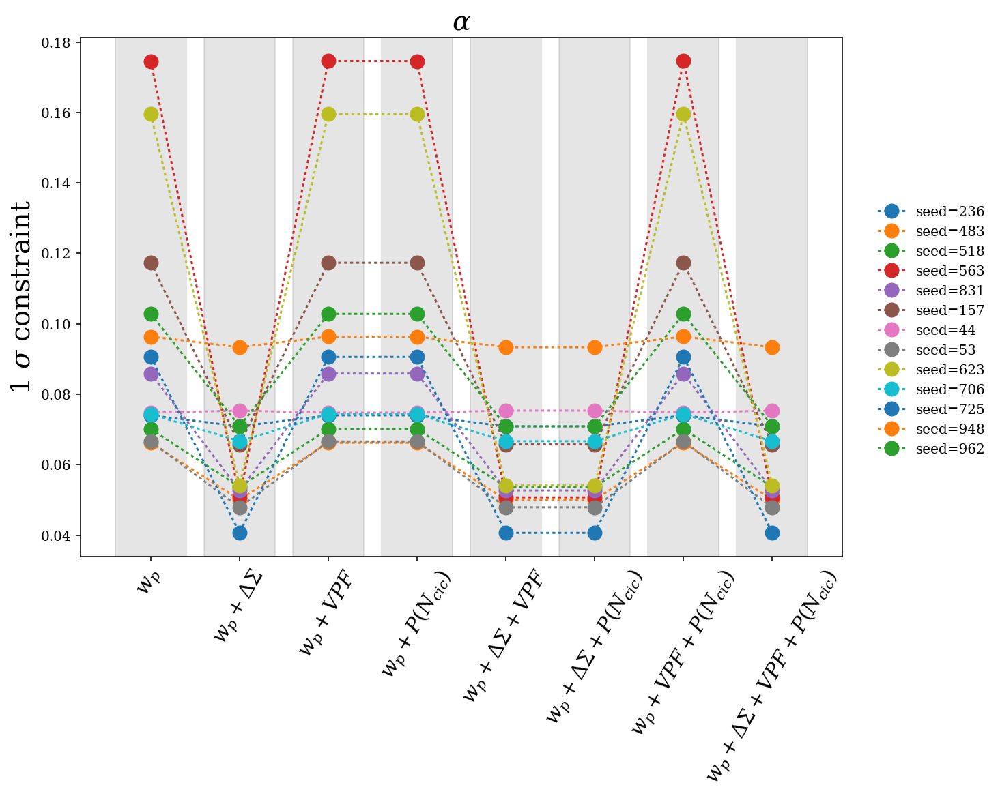

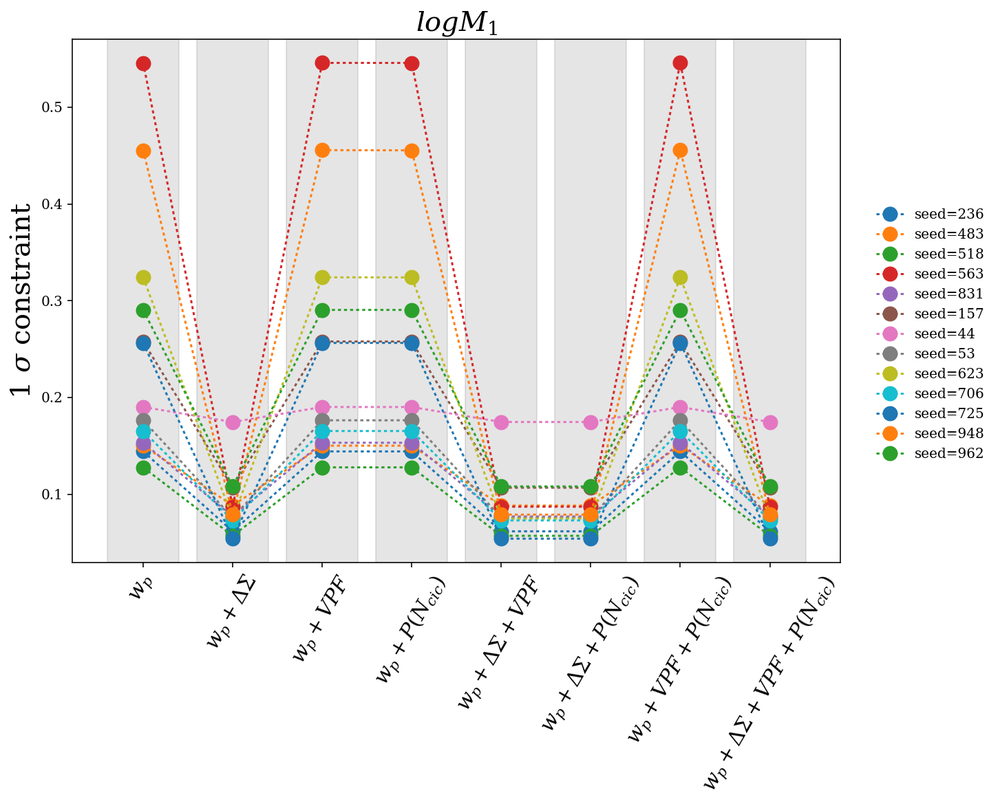

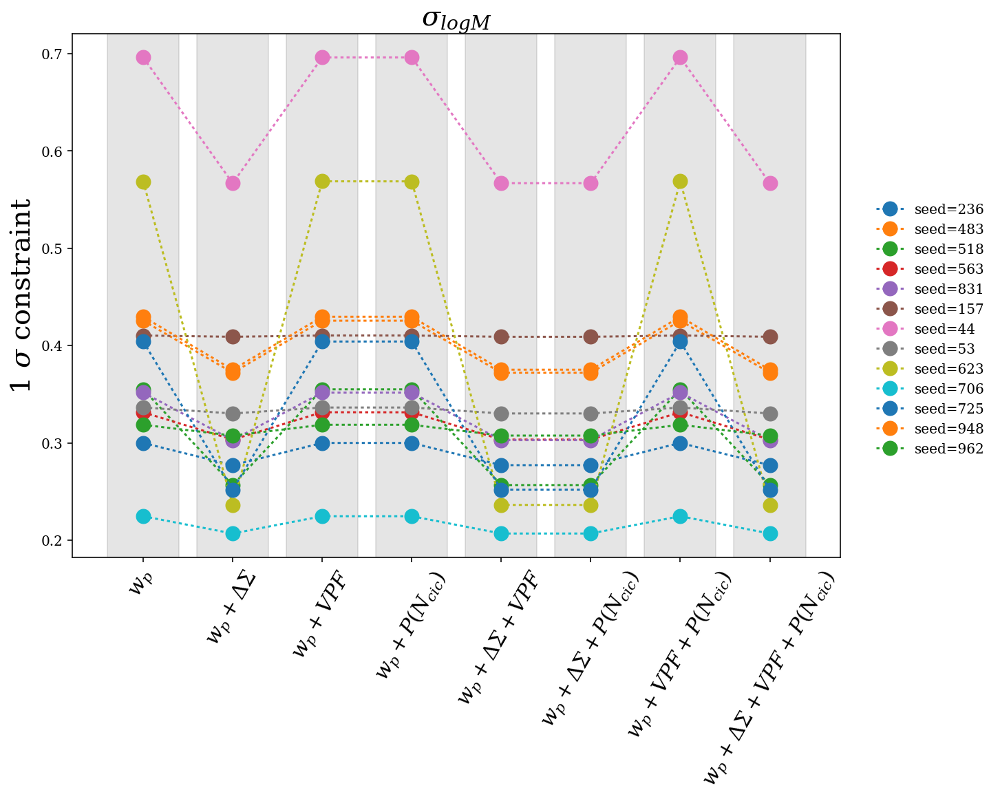

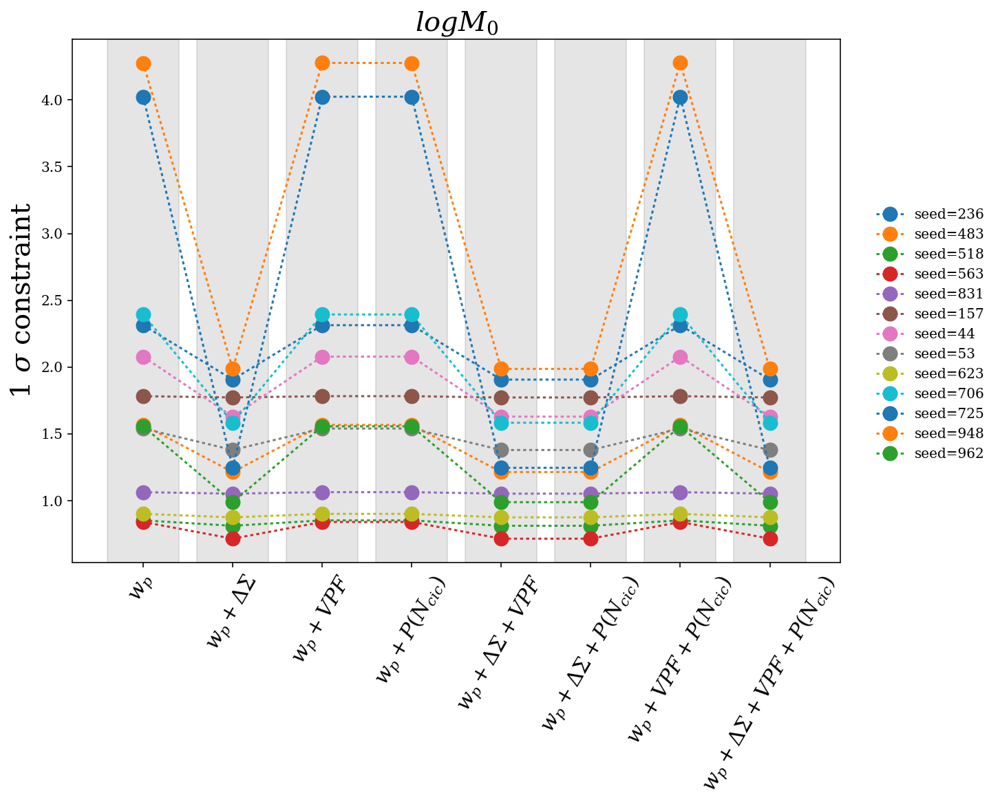

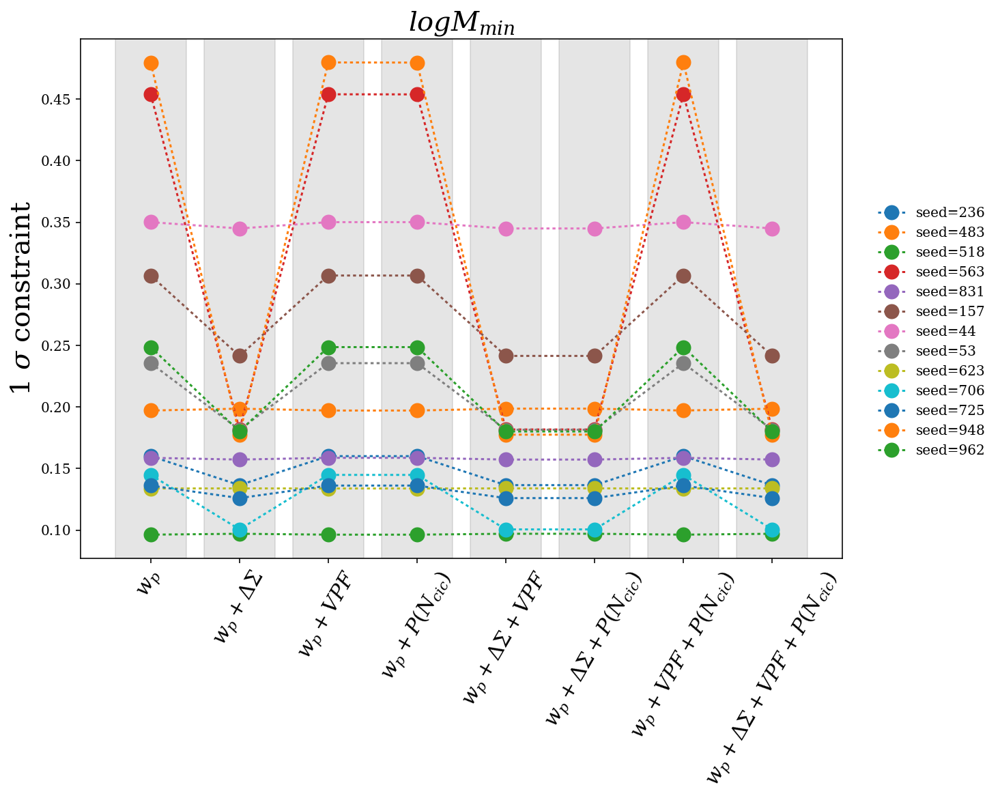

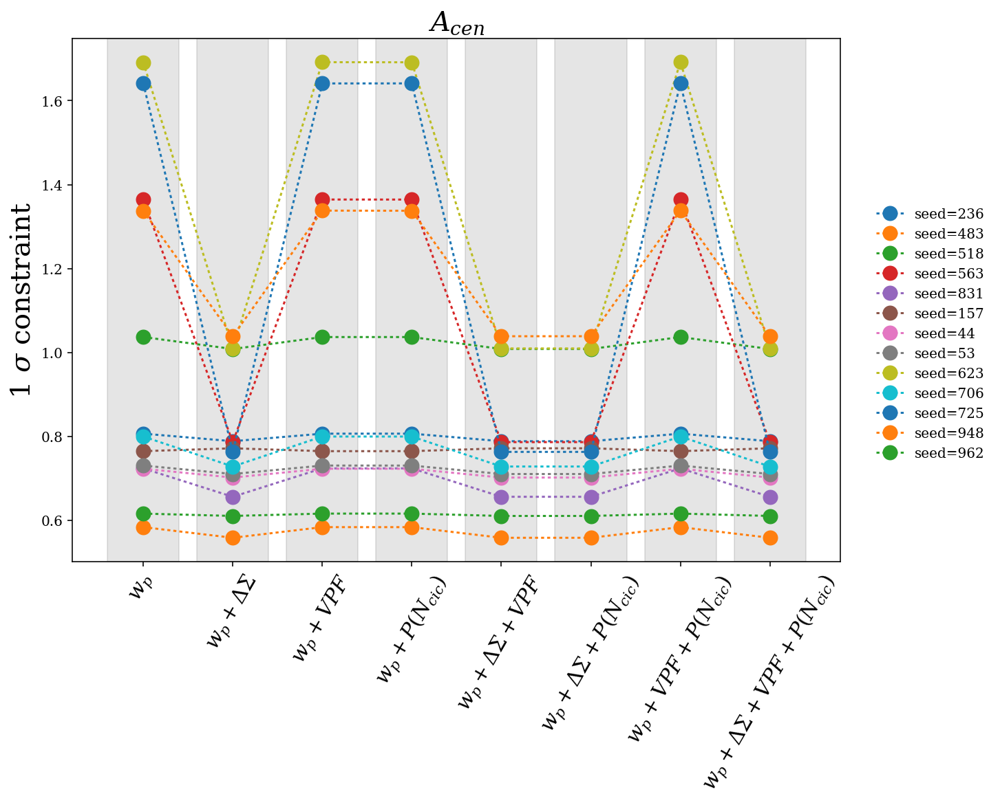

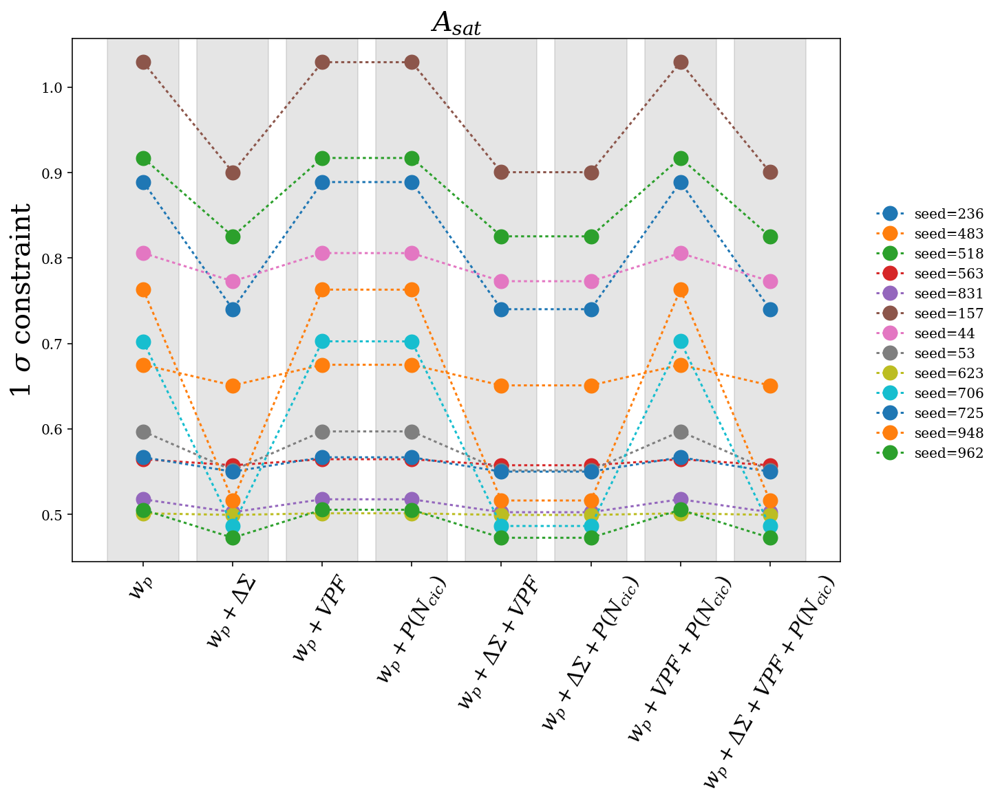

In [28]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236_3[:,i],'o:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483_3[:,i],'o:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518_3[:,i],'o:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563_3[:,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831_3[:,i],'o:',markersize=10,label='seed=831')
    plt.plot(range(1,9),all_1sigma_157_3[:,i],'o:',markersize=10,label='seed=157')
    plt.plot(range(1,9),all_1sigma_44_3[:,i],'o:',markersize=10,label='seed=44')
    plt.plot(range(1,9),all_1sigma_53_3[:,i],'o:',markersize=10,label='seed=53')
    plt.plot(range(1,9),all_1sigma_623_3[:,i],'o:',markersize=10,label='seed=623')
    plt.plot(range(1,9),all_1sigma_706_3[:,i],'o:',markersize=10,label='seed=706')
    plt.plot(range(1,9),all_1sigma_725_3[:,i],'o:',markersize=10,label='seed=725')
    plt.plot(range(1,9),all_1sigma_948_3[:,i],'o:',markersize=10,label='seed=948')
    plt.plot(range(1,9),all_1sigma_962_3[:,i],'o:',markersize=10,label='seed=962')
    plt.ylabel(r'$1\ \sigma\ \mathrm{constraint}$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

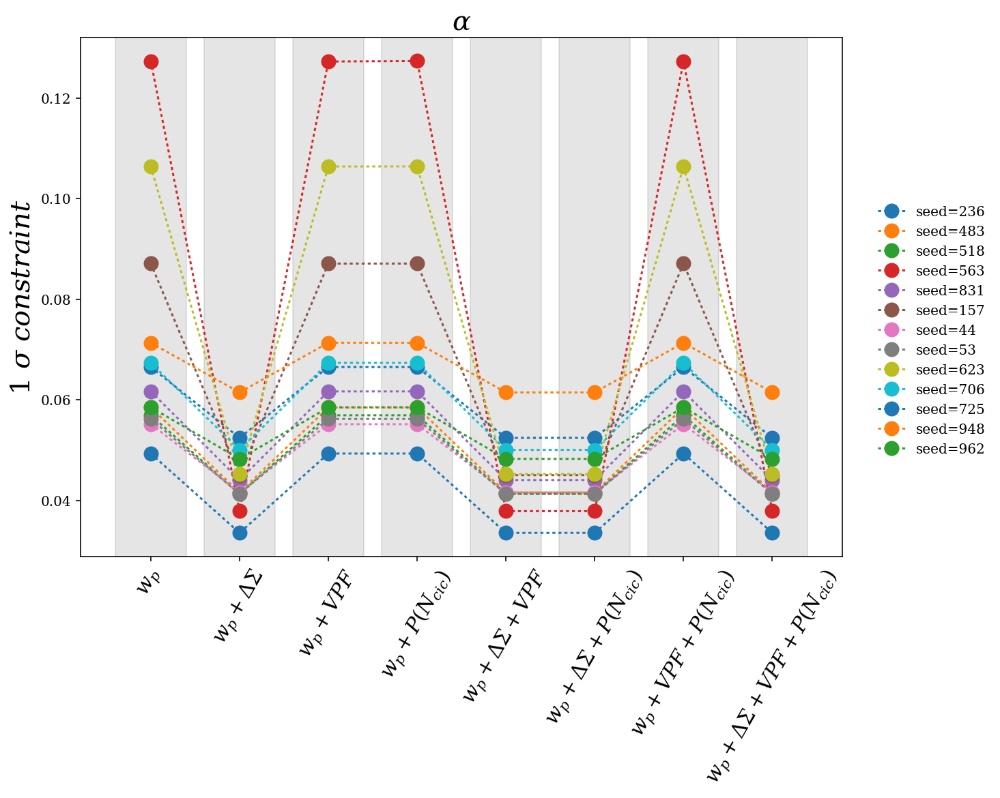

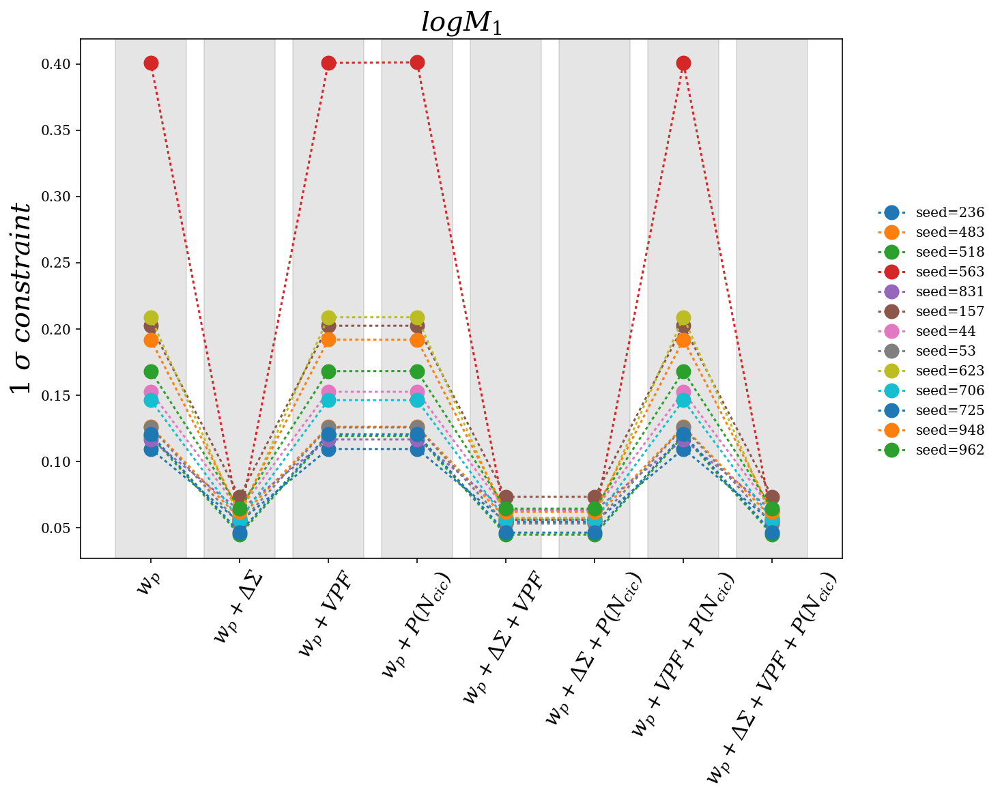

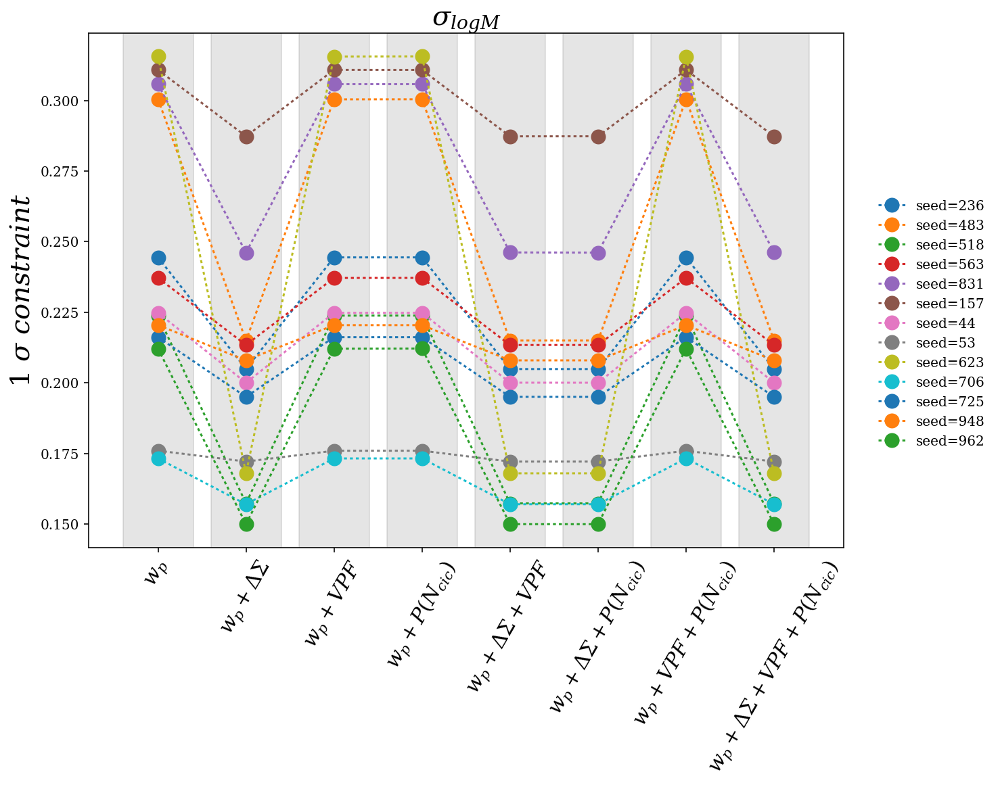

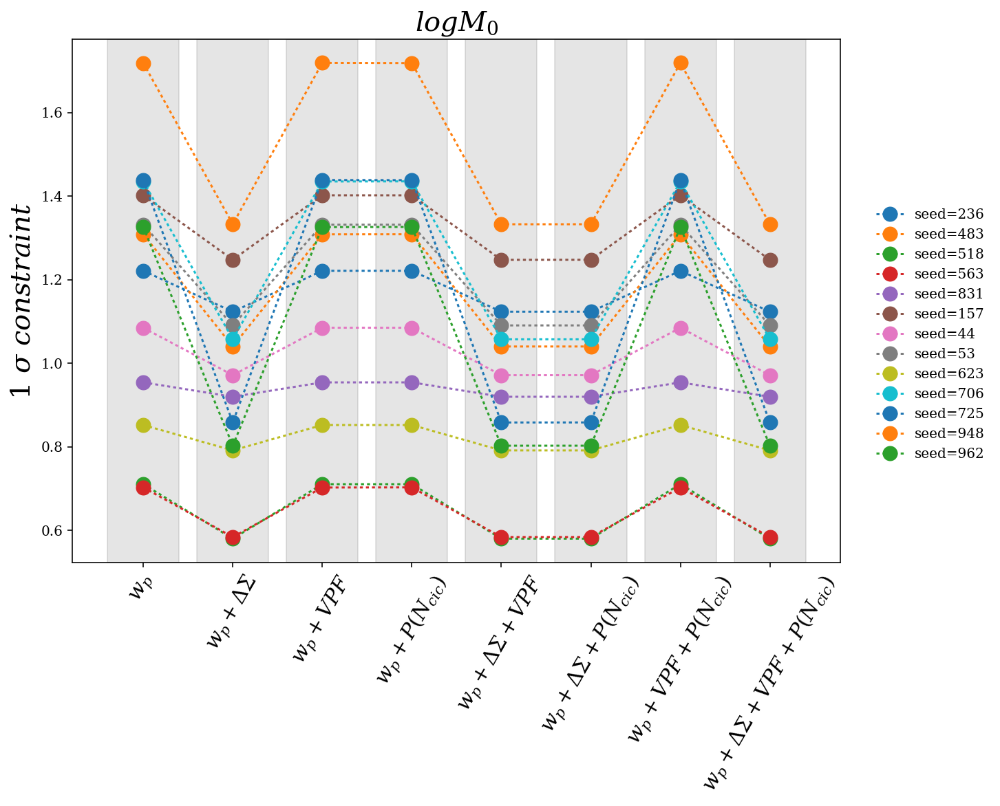

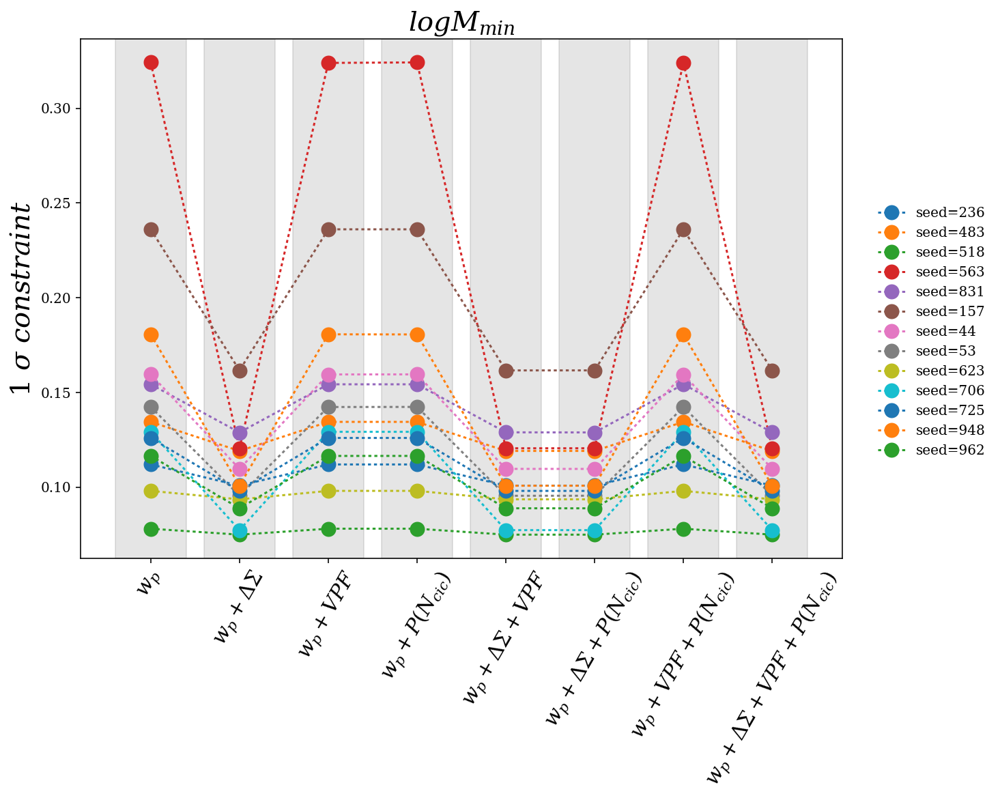

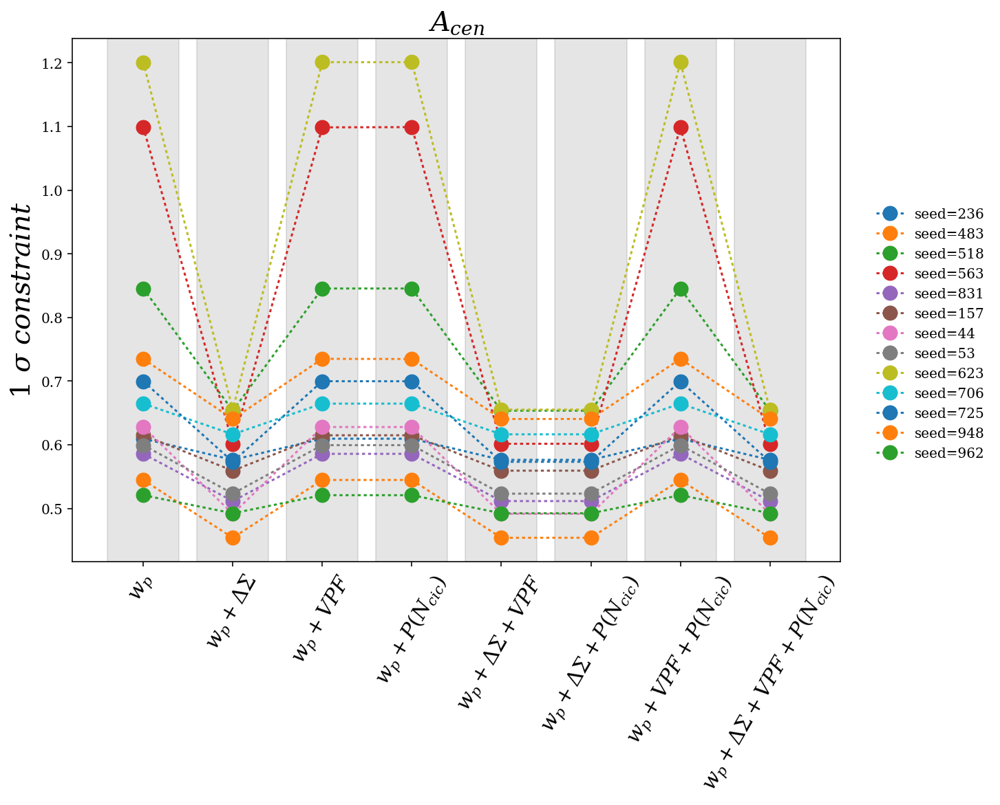

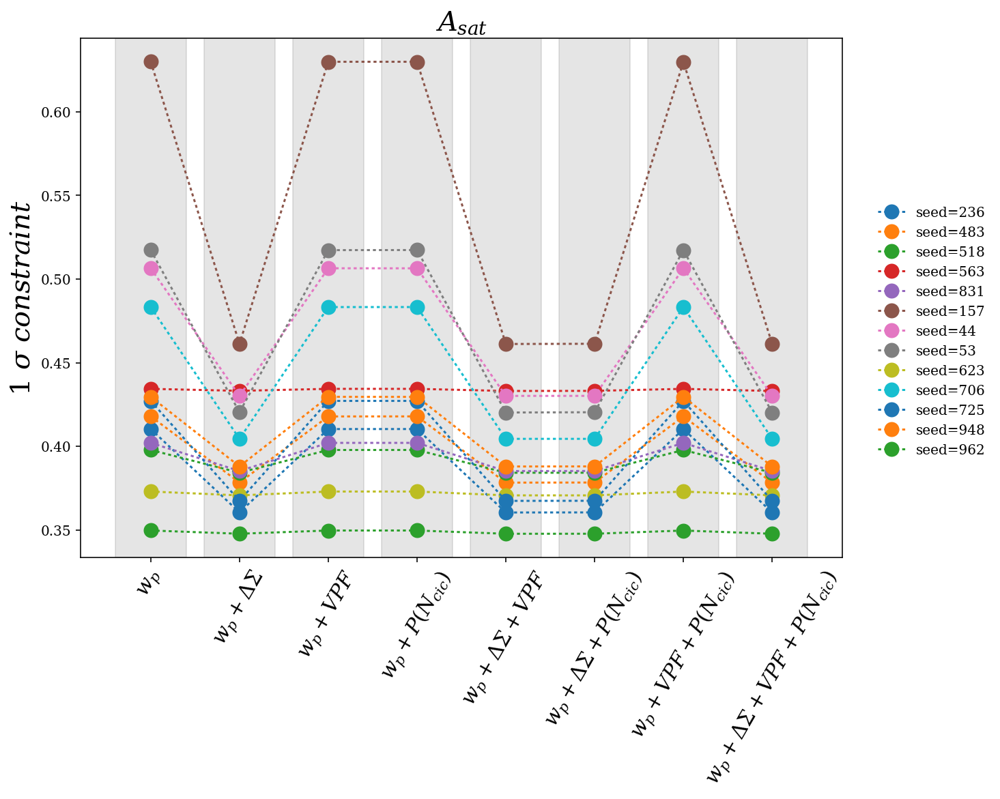

In [29]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236_4[:,i],'o:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483_4[:,i],'o:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518_4[:,i],'o:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563_4[:,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831_4[:,i],'o:',markersize=10,label='seed=831')
    plt.plot(range(1,9),all_1sigma_157_4[:,i],'o:',markersize=10,label='seed=157')
    plt.plot(range(1,9),all_1sigma_44_4[:,i],'o:',markersize=10,label='seed=44')
    plt.plot(range(1,9),all_1sigma_53_4[:,i],'o:',markersize=10,label='seed=53')
    plt.plot(range(1,9),all_1sigma_623_4[:,i],'o:',markersize=10,label='seed=623')
    plt.plot(range(1,9),all_1sigma_706_4[:,i],'o:',markersize=10,label='seed=706')
    plt.plot(range(1,9),all_1sigma_725_4[:,i],'o:',markersize=10,label='seed=725')
    plt.plot(range(1,9),all_1sigma_948_4[:,i],'o:',markersize=10,label='seed=948')
    plt.plot(range(1,9),all_1sigma_962_4[:,i],'o:',markersize=10,label='seed=962')
    plt.ylabel(r'$1\ \sigma\ constraint$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

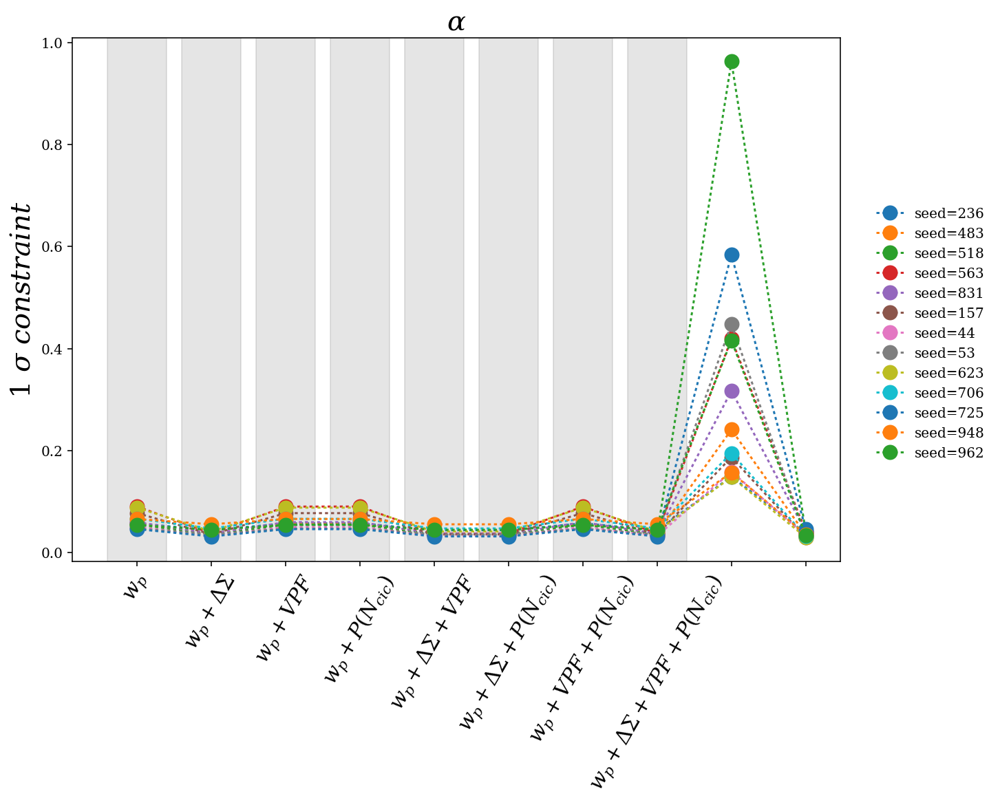

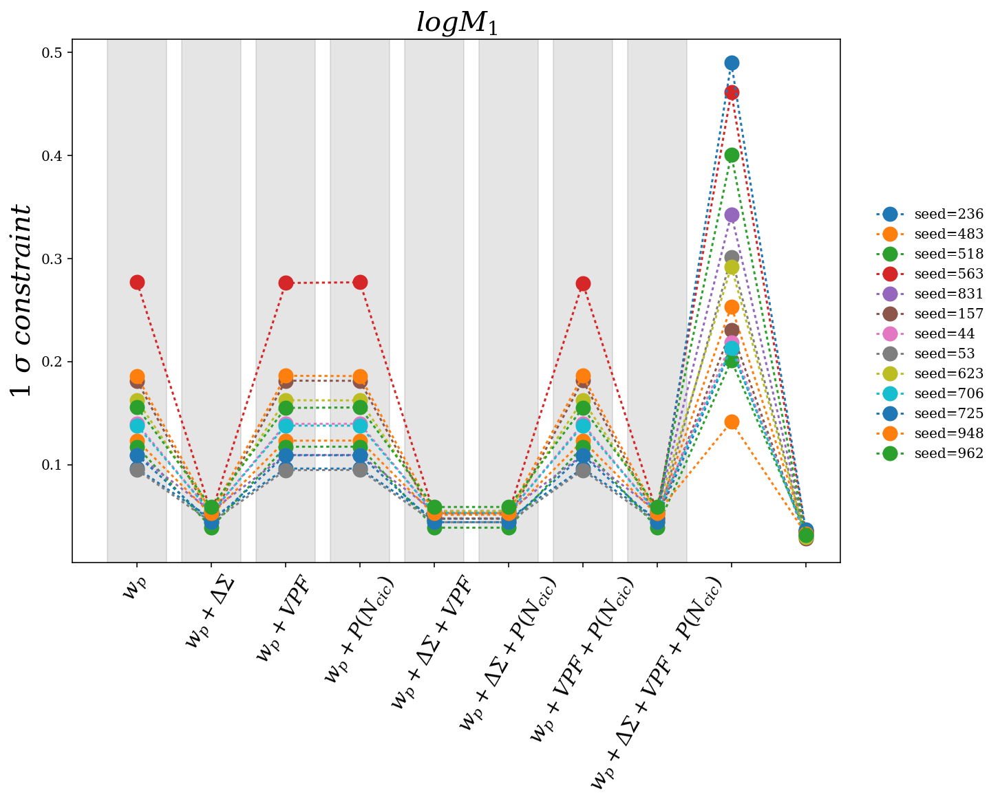

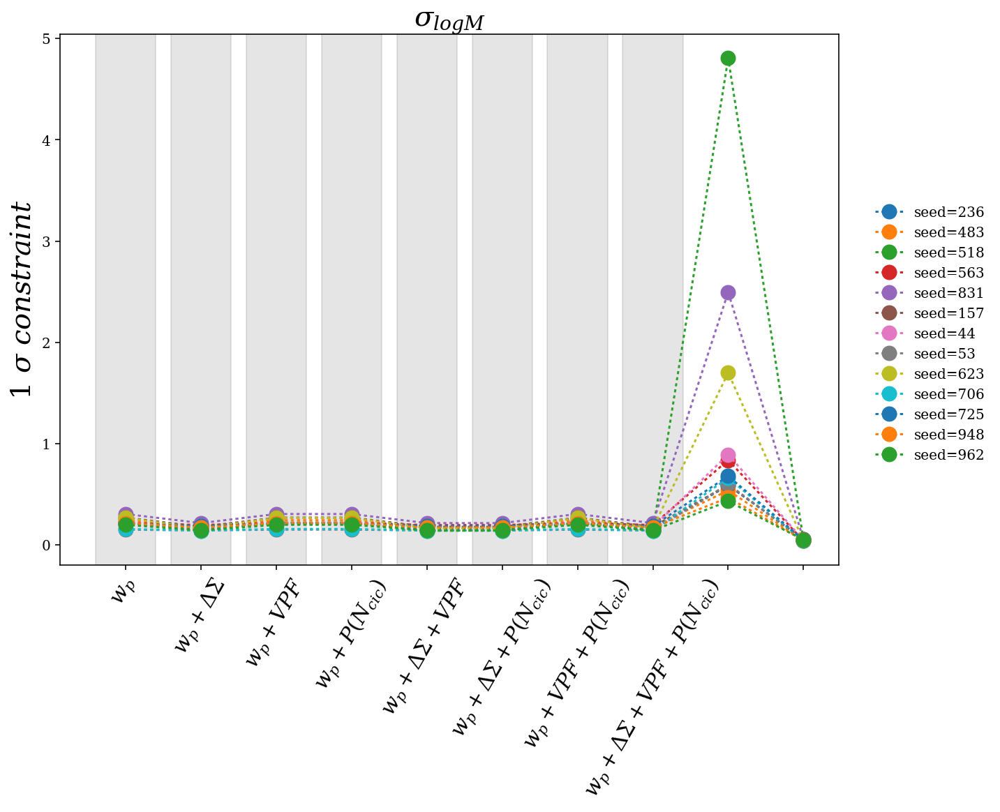

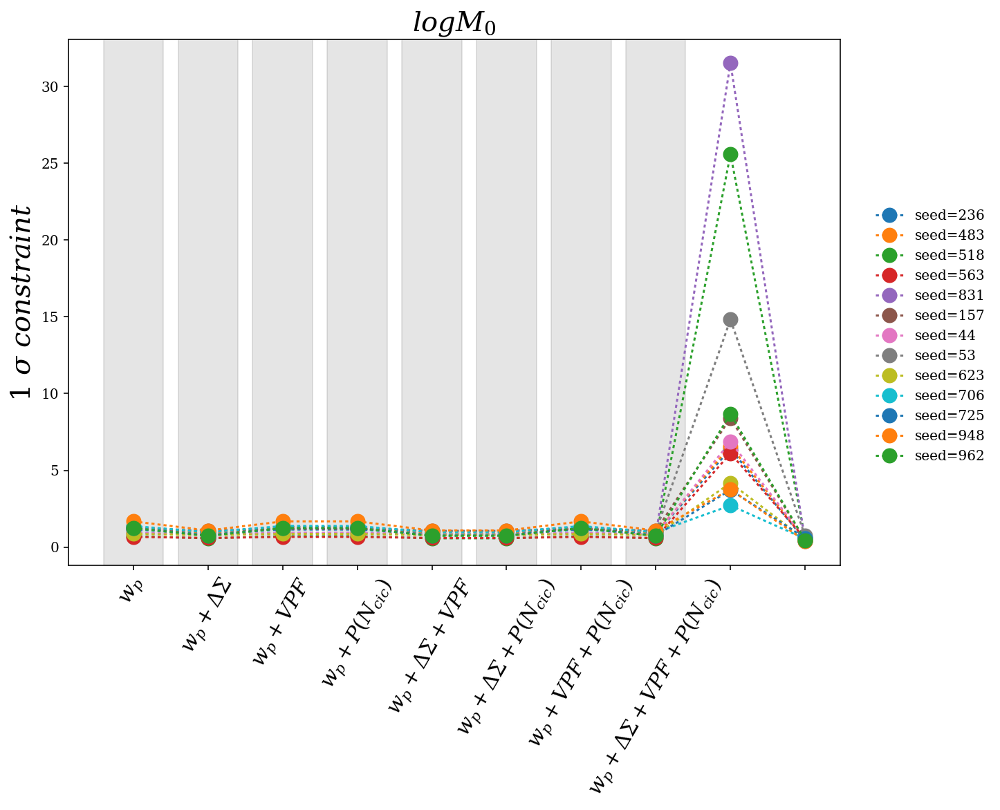

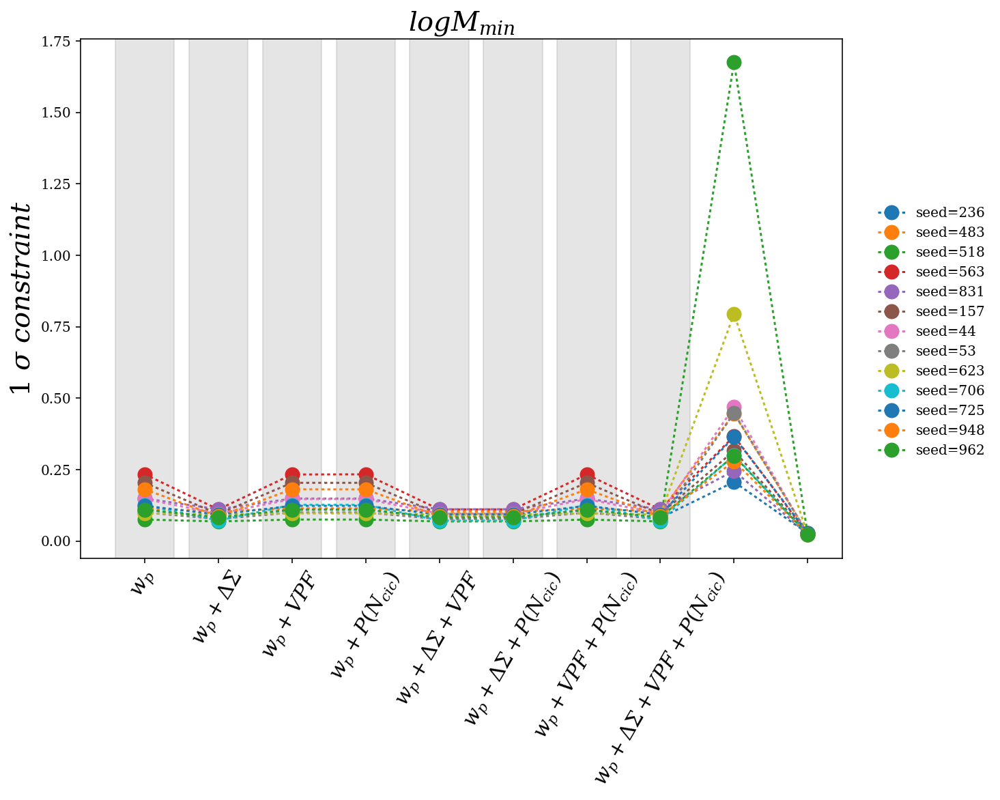

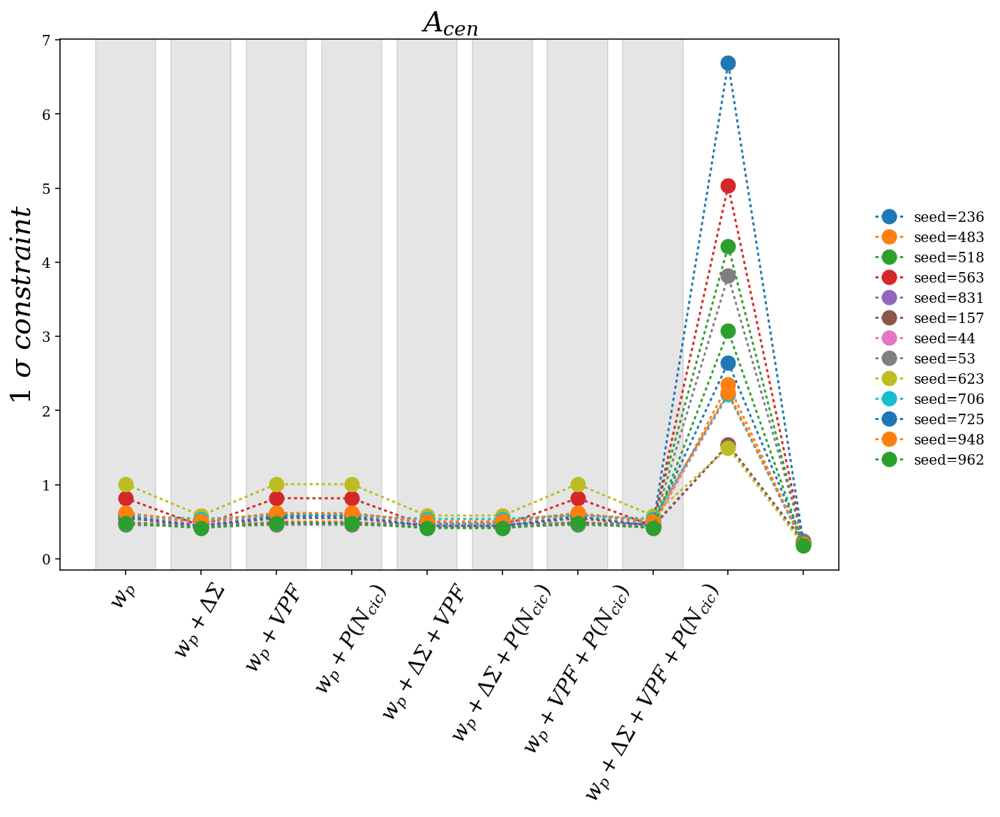

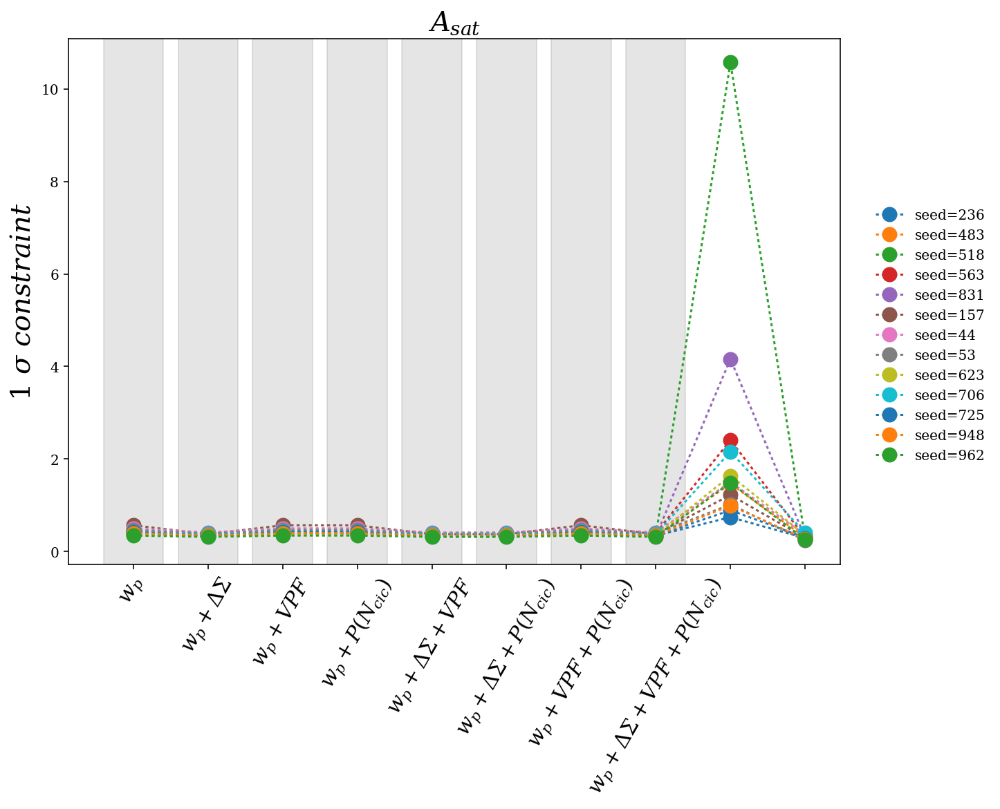

In [63]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,11),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,11),all_1sigma_236_5[:,i],'o:',markersize=10,label='seed=236')
    plt.plot(range(1,11),all_1sigma_483_5[:,i],'o:',markersize=10,label='seed=483')
    plt.plot(range(1,11),all_1sigma_518_5[:,i],'o:',markersize=10,label='seed=518')
    plt.plot(range(1,11),all_1sigma_563_5[:,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,11),all_1sigma_831_5[:,i],'o:',markersize=10,label='seed=831')
    plt.plot(range(1,11),all_1sigma_157_5[:,i],'o:',markersize=10,label='seed=157')
    plt.plot(range(1,11),all_1sigma_44_5[:,i],'o:',markersize=10,label='seed=44')
    plt.plot(range(1,11),all_1sigma_53_5[:,i],'o:',markersize=10,label='seed=53')
    plt.plot(range(1,11),all_1sigma_623_5[:,i],'o:',markersize=10,label='seed=623')
    plt.plot(range(1,11),all_1sigma_706_5[:,i],'o:',markersize=10,label='seed=706')
    plt.plot(range(1,11),all_1sigma_725_5[:,i],'o:',markersize=10,label='seed=725')
    plt.plot(range(1,11),all_1sigma_948_5[:,i],'o:',markersize=10,label='seed=948')
    plt.plot(range(1,11),all_1sigma_962_5[:,i],'o:',markersize=10,label='seed=962')
    plt.ylabel(r'$1\ \sigma\ constraint$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

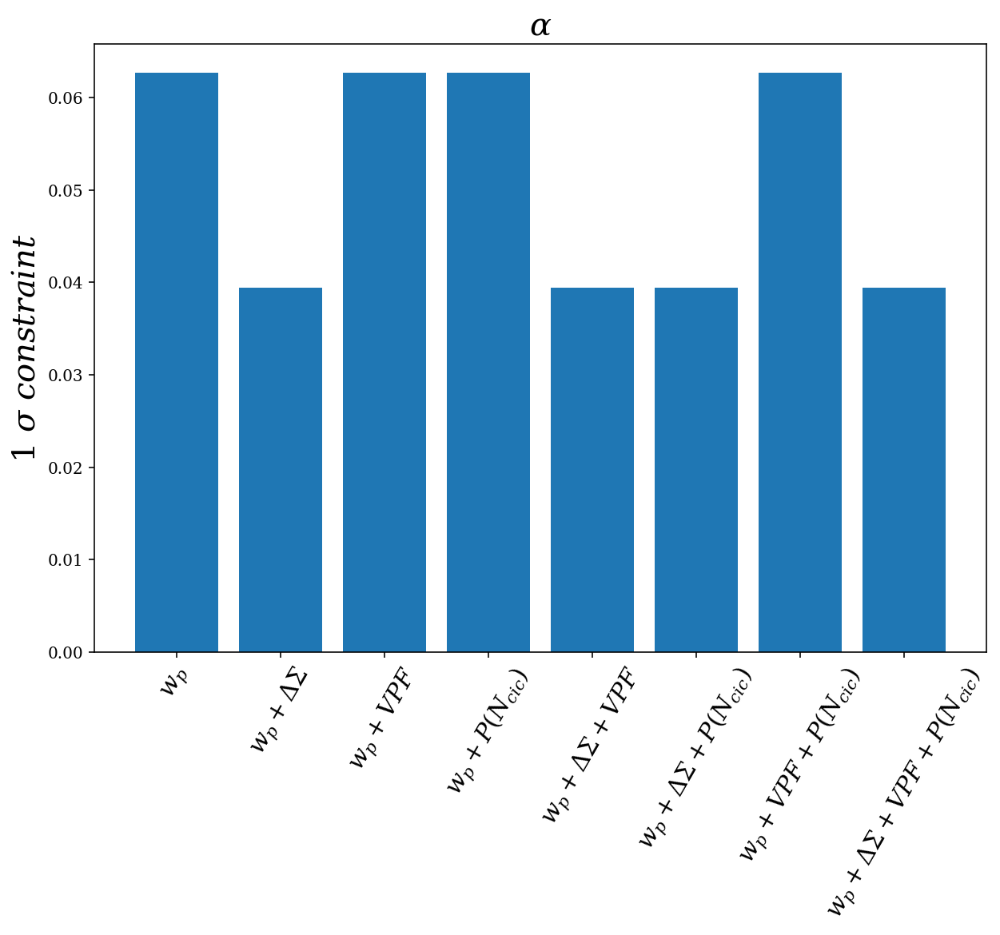

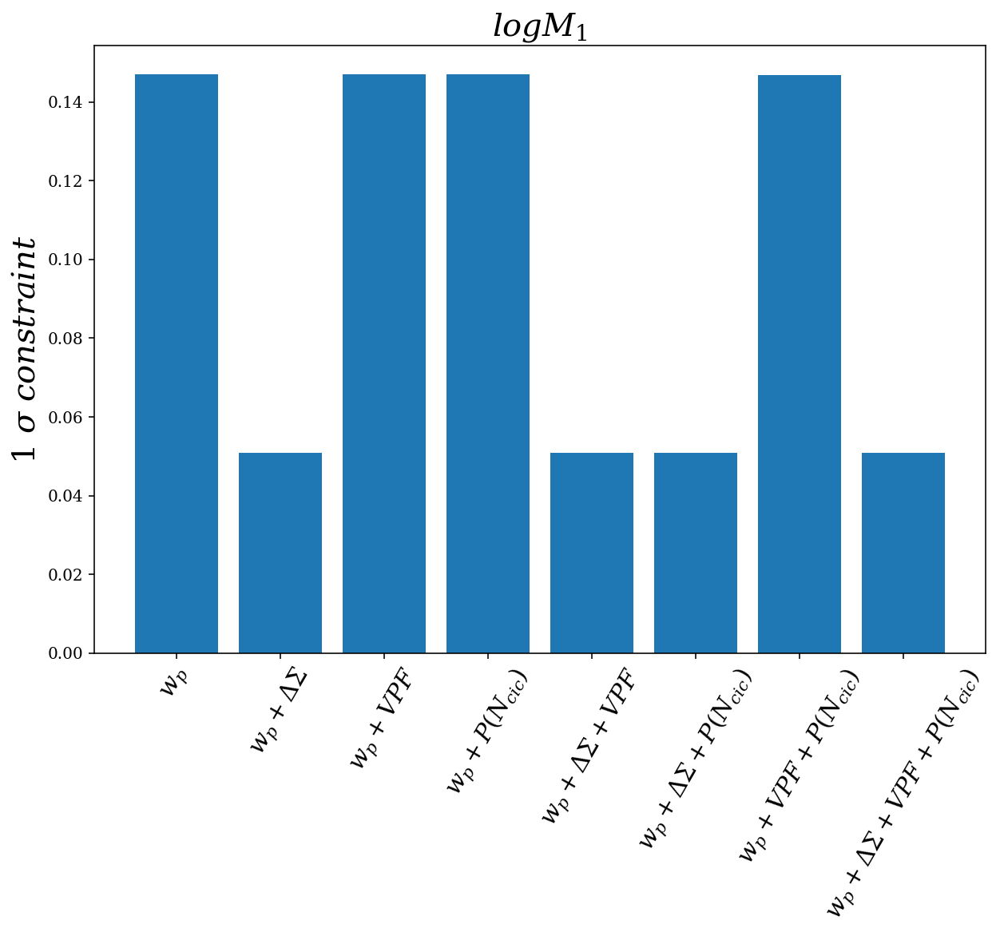

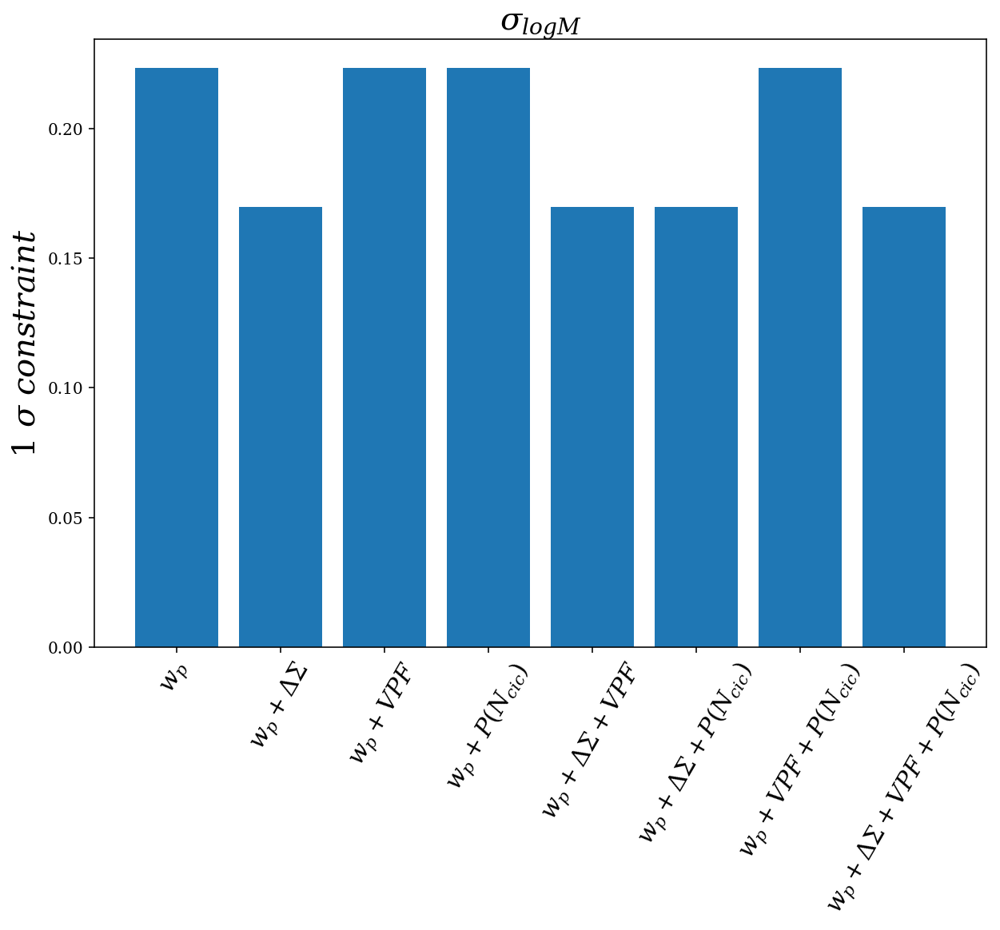

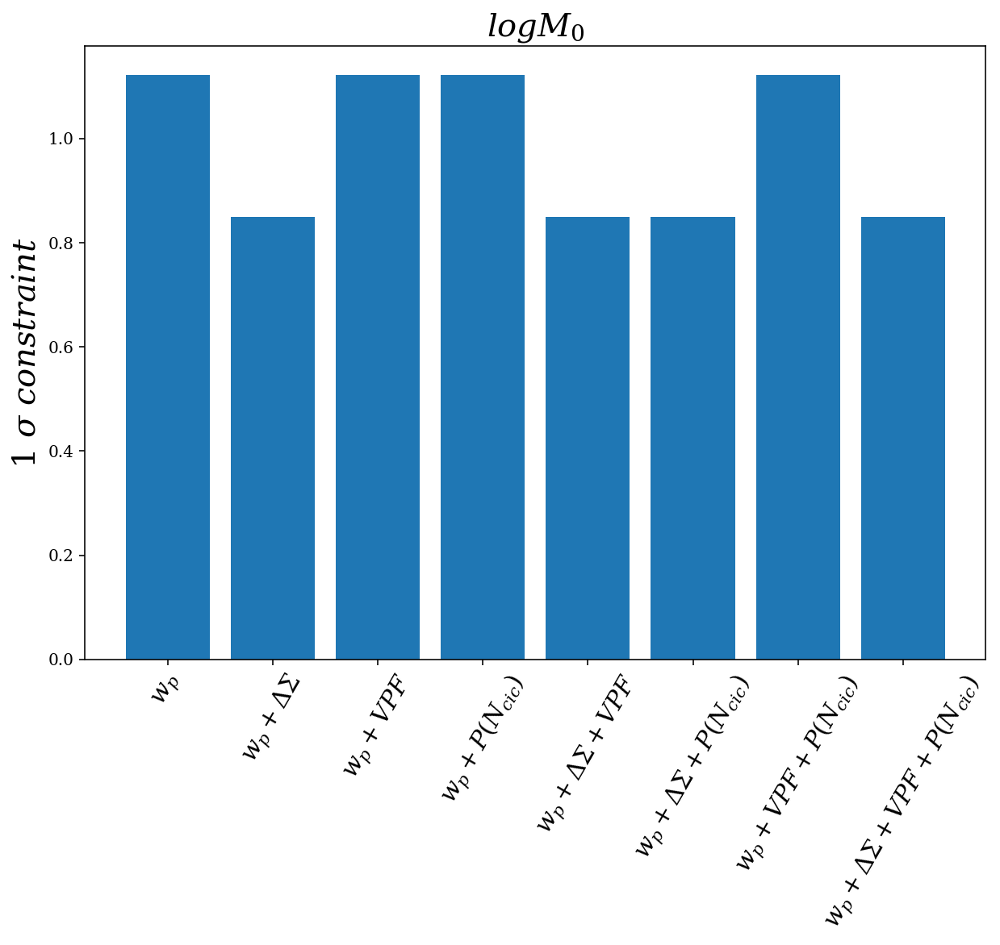

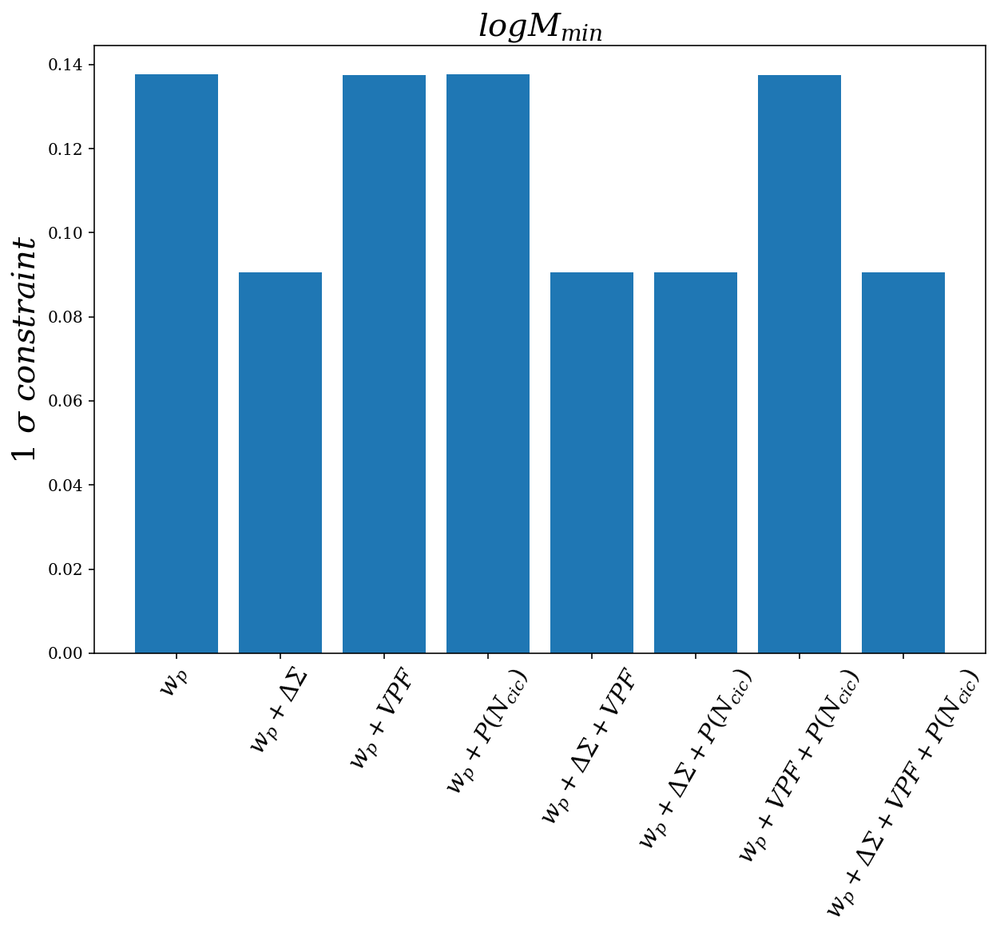

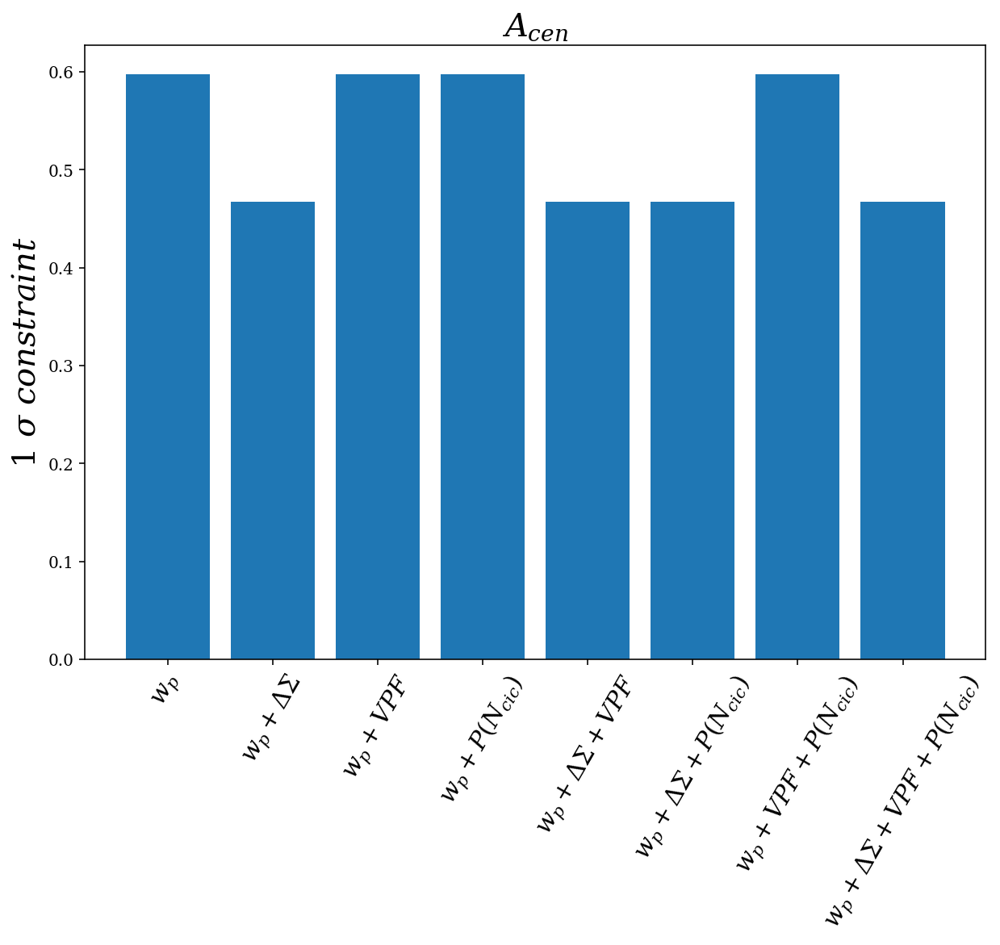

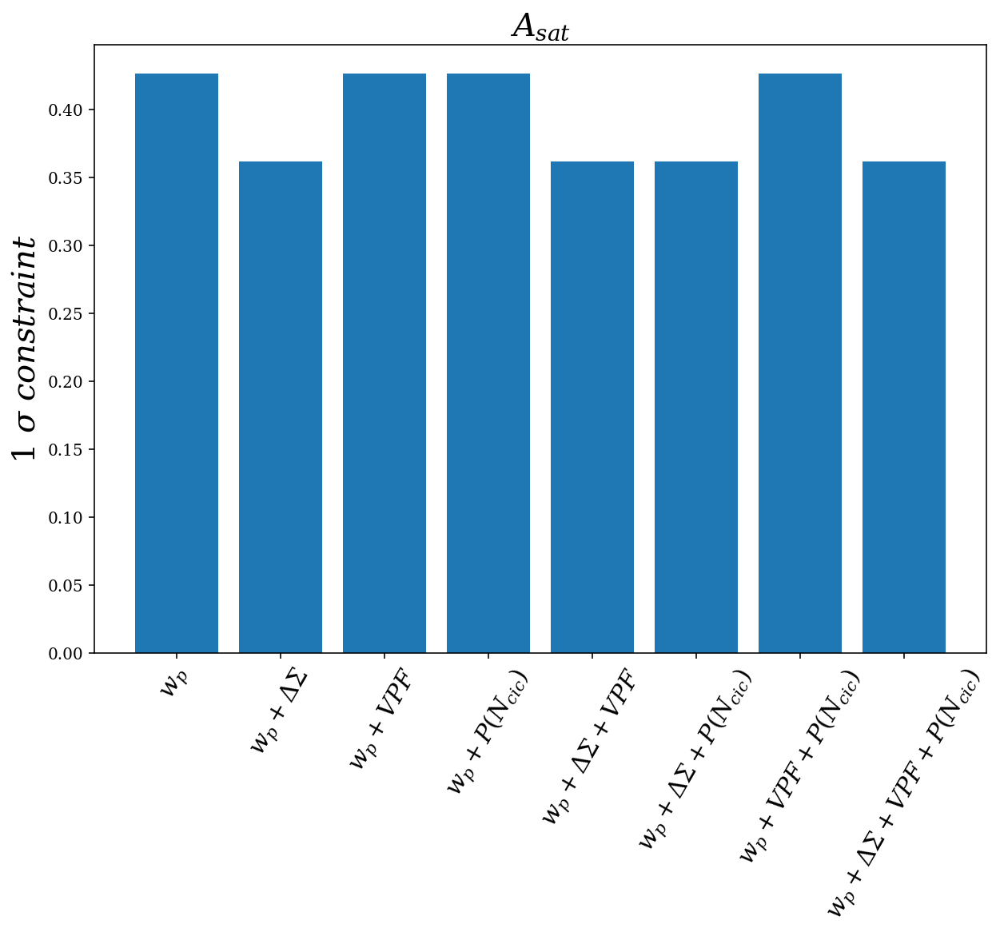

In [48]:
all_1sigma_5_average = np.mean(np.stack((all_1sigma_236_5,all_1sigma_483_5,all_1sigma_518_5,\
                                         all_1sigma_563_5,all_1sigma_831_5,all_1sigma_157_5,\
                                         all_1sigma_44_5,all_1sigma_53_5,all_1sigma_623_5,\
                                         all_1sigma_706_5,all_1sigma_725_5,all_1sigma_948_5,\
                                         all_1sigma_962_5)),axis=0)
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.bar(range(1,9),all_1sigma_5_average[:,i])
    plt.ylabel(r'$1\ \sigma\ constraint$',fontsize=20)
    #plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

In [44]:
all_1sigma_5_average

array([[ 0.06268724,  0.14698536,  0.2233018 ,  1.12204103,  0.13763367,
         0.5970868 ,  0.42610396],
       [ 0.0394669 ,  0.05089166,  0.16964478,  0.85005394,  0.09063606,
         0.46697007,  0.36154422],
       [ 0.0626537 ,  0.14690057,  0.22328613,  1.1218203 ,  0.13754285,
         0.59741057,  0.42621708],
       [ 0.06268664,  0.14698106,  0.22329801,  1.12202455,  0.13762636,
         0.59709529,  0.42609694],
       [ 0.0394502 ,  0.05084937,  0.16964874,  0.85010763,  0.09062636,
         0.46697648,  0.36161582],
       [ 0.03946417,  0.05088088,  0.16963864,  0.85006339,  0.09062785,
         0.46695681,  0.3615367 ],
       [ 0.06265306,  0.14689609,  0.22328232,  1.12180351,  0.1375354 ,
         0.59741907,  0.42621   ],
       [ 0.03944746,  0.05083843,  0.16964214,  0.85011684,  0.09061772,
         0.46696315,  0.36160785]])

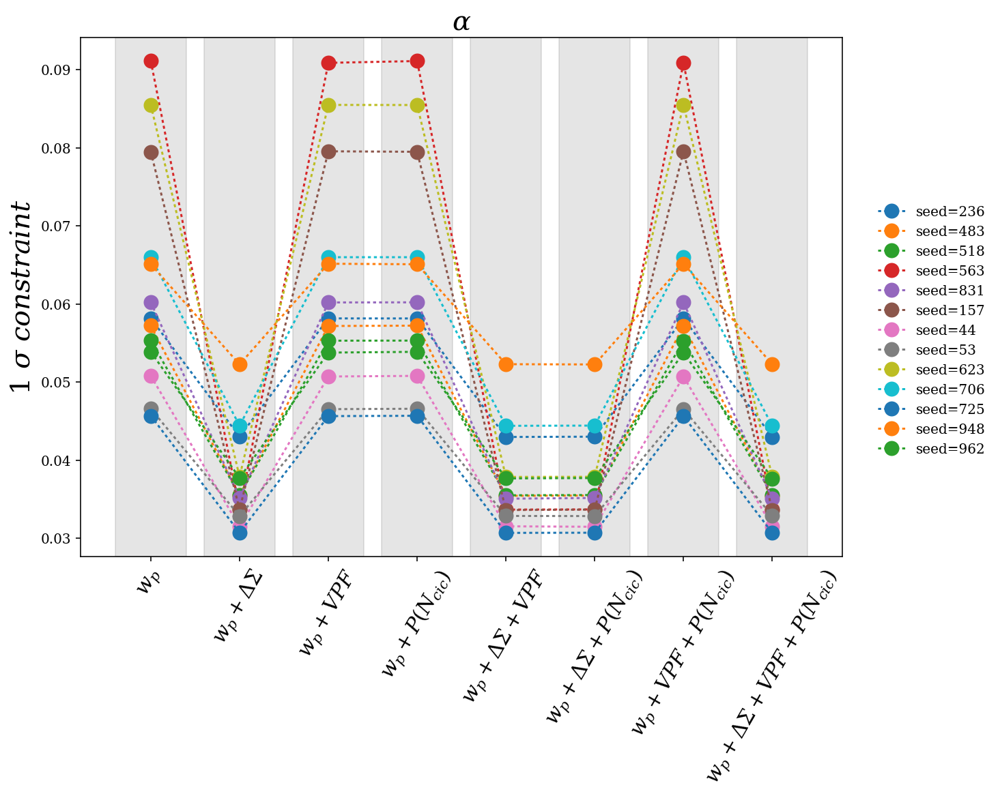

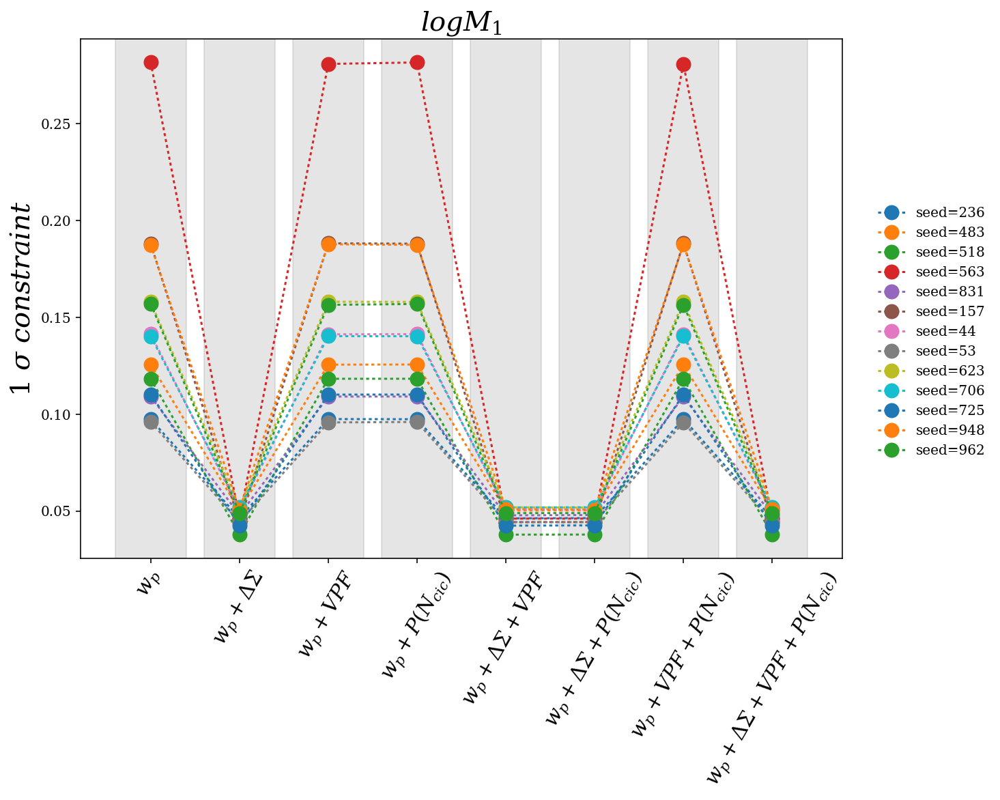

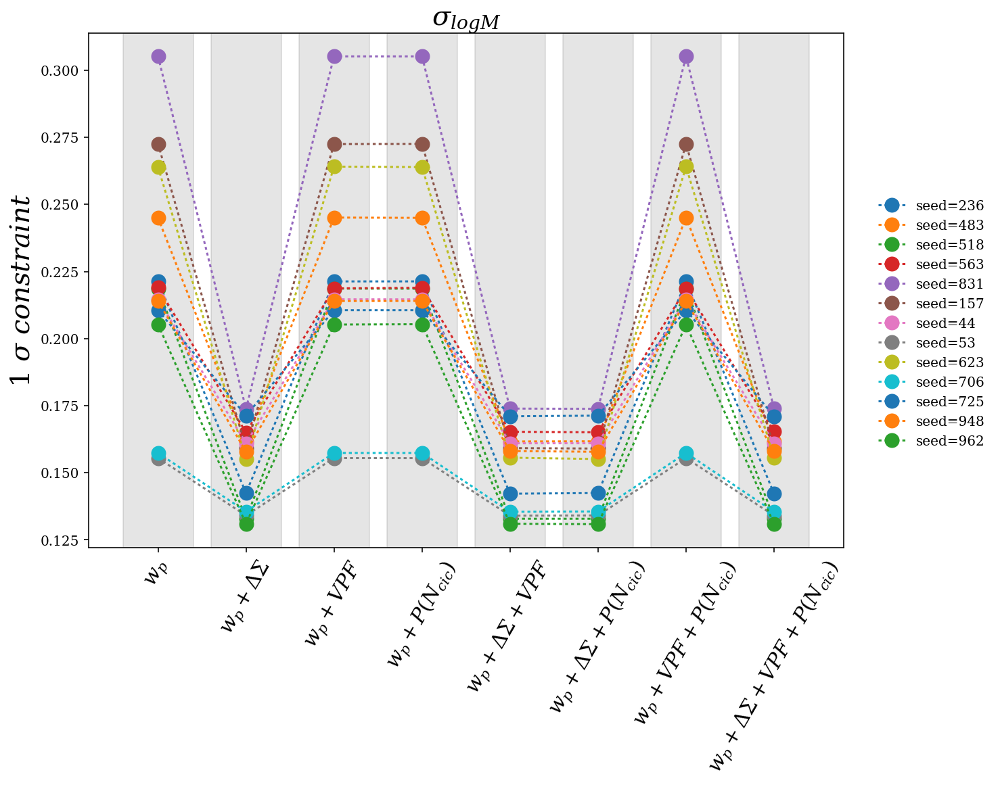

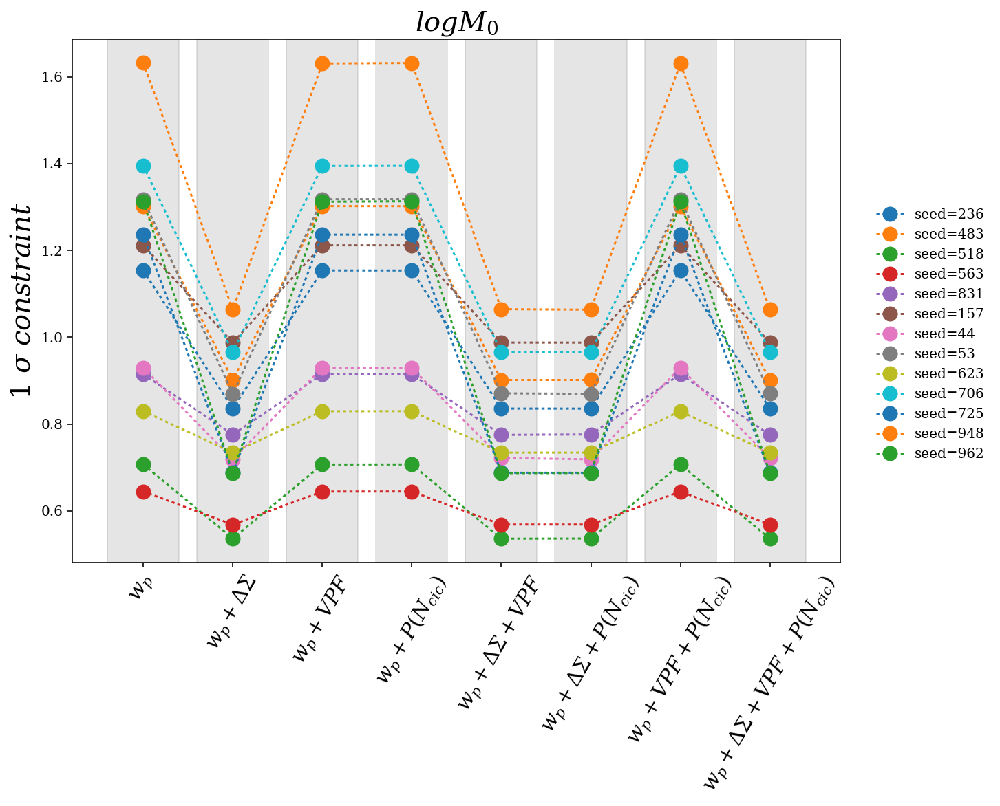

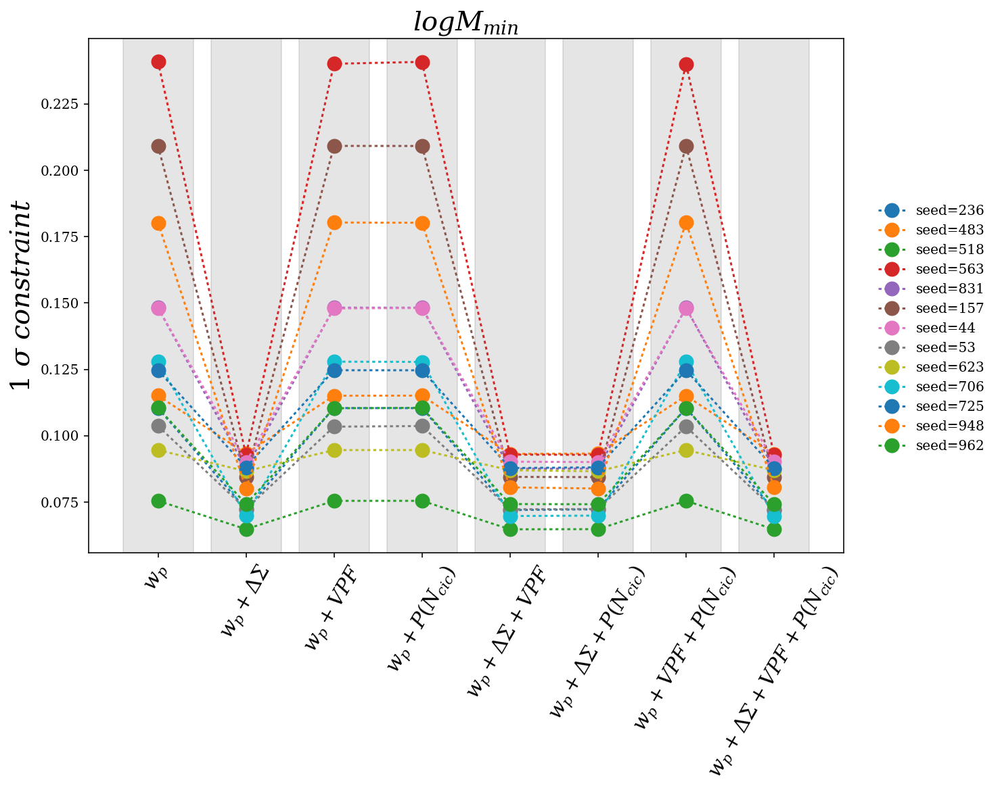

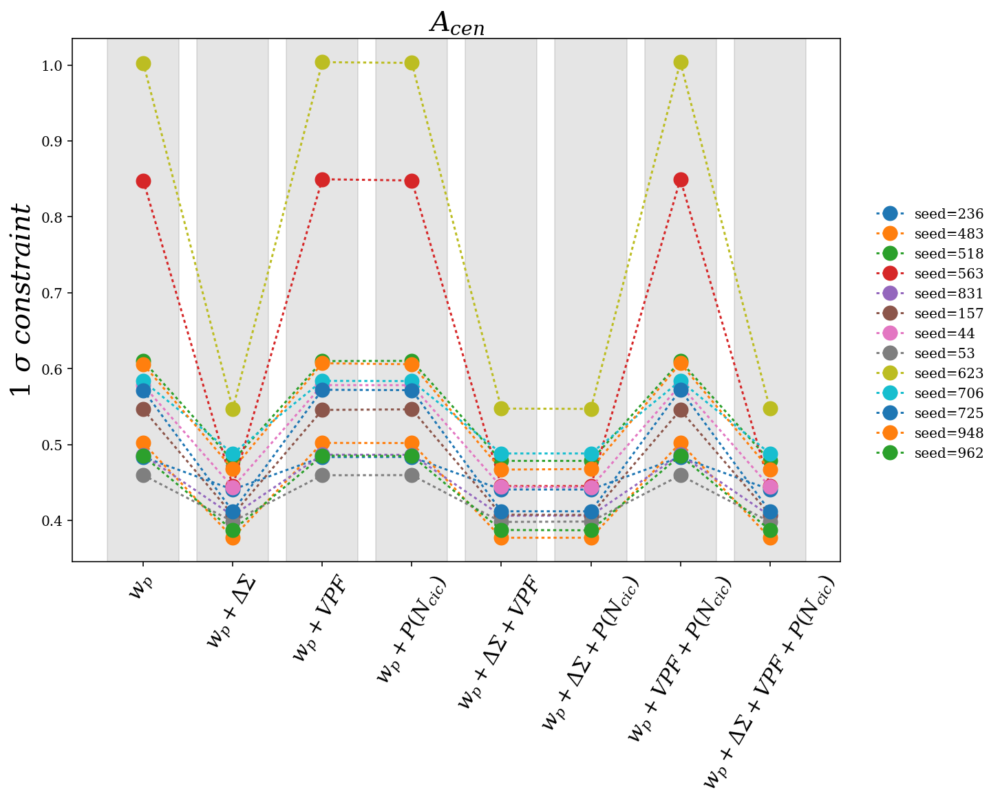

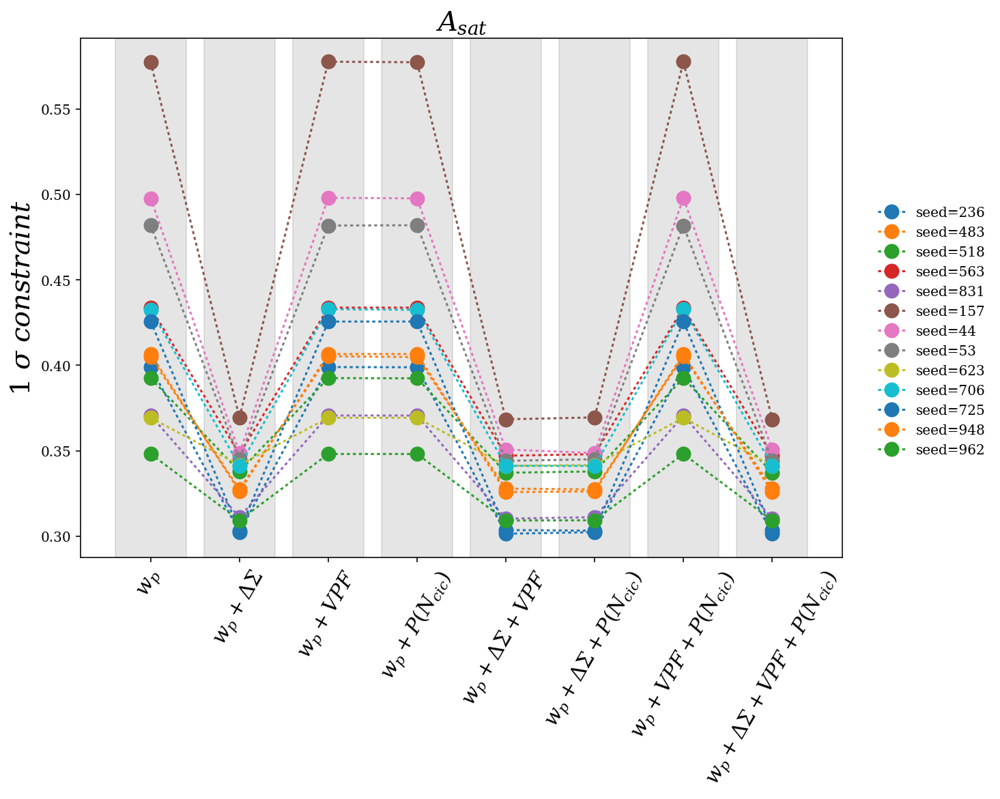

In [31]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236_6[:,i],'o:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483_6[:,i],'o:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518_6[:,i],'o:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563_6[:,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831_6[:,i],'o:',markersize=10,label='seed=831')
    plt.plot(range(1,9),all_1sigma_157_6[:,i],'o:',markersize=10,label='seed=157')
    plt.plot(range(1,9),all_1sigma_44_6[:,i],'o:',markersize=10,label='seed=44')
    plt.plot(range(1,9),all_1sigma_53_6[:,i],'o:',markersize=10,label='seed=53')
    plt.plot(range(1,9),all_1sigma_623_6[:,i],'o:',markersize=10,label='seed=623')
    plt.plot(range(1,9),all_1sigma_706_6[:,i],'o:',markersize=10,label='seed=706')
    plt.plot(range(1,9),all_1sigma_725_6[:,i],'o:',markersize=10,label='seed=725')
    plt.plot(range(1,9),all_1sigma_948_6[:,i],'o:',markersize=10,label='seed=948')
    plt.plot(range(1,9),all_1sigma_962_6[:,i],'o:',markersize=10,label='seed=962')
    plt.ylabel(r'$1\ \sigma\ constraint$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

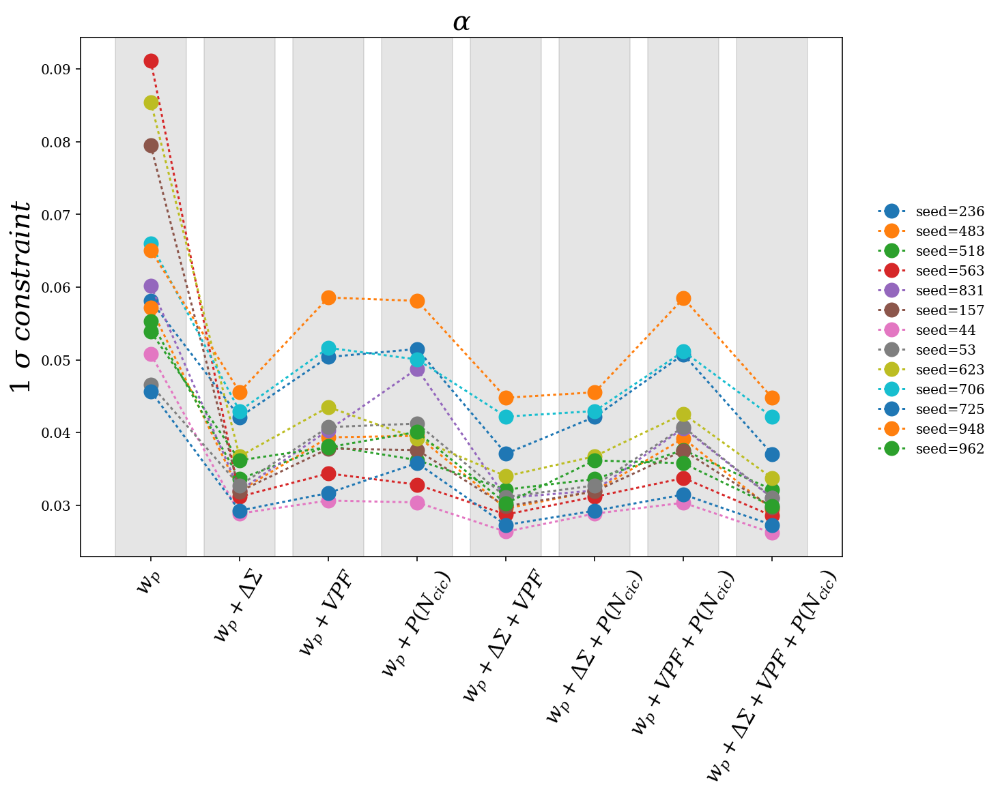

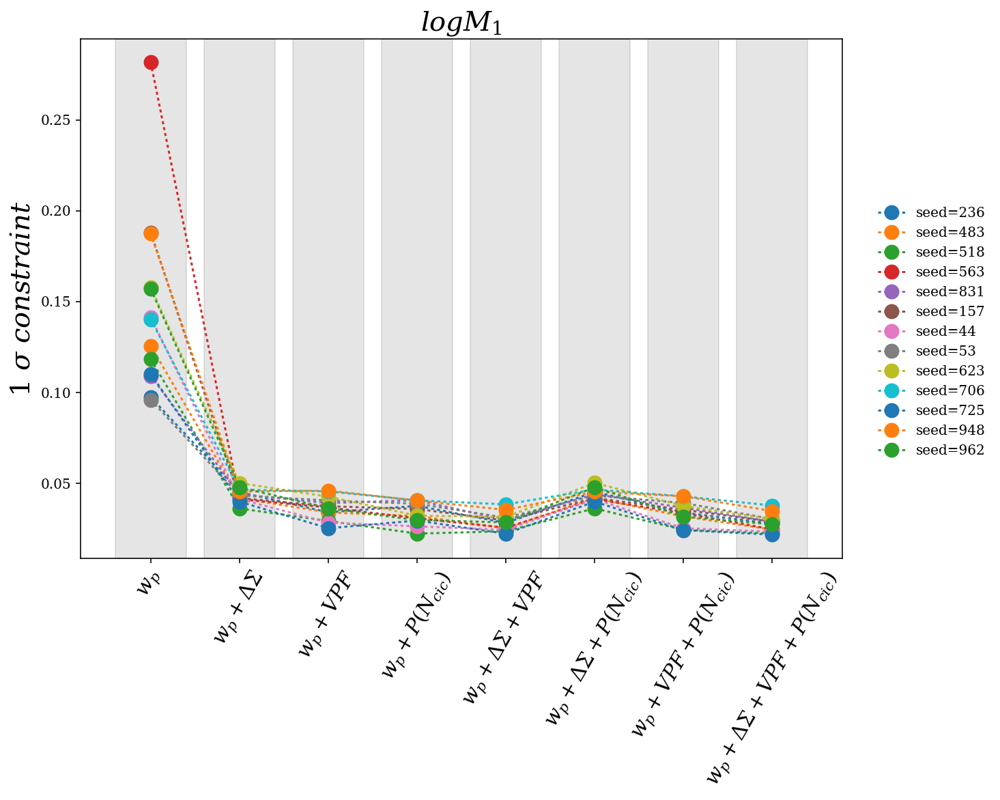

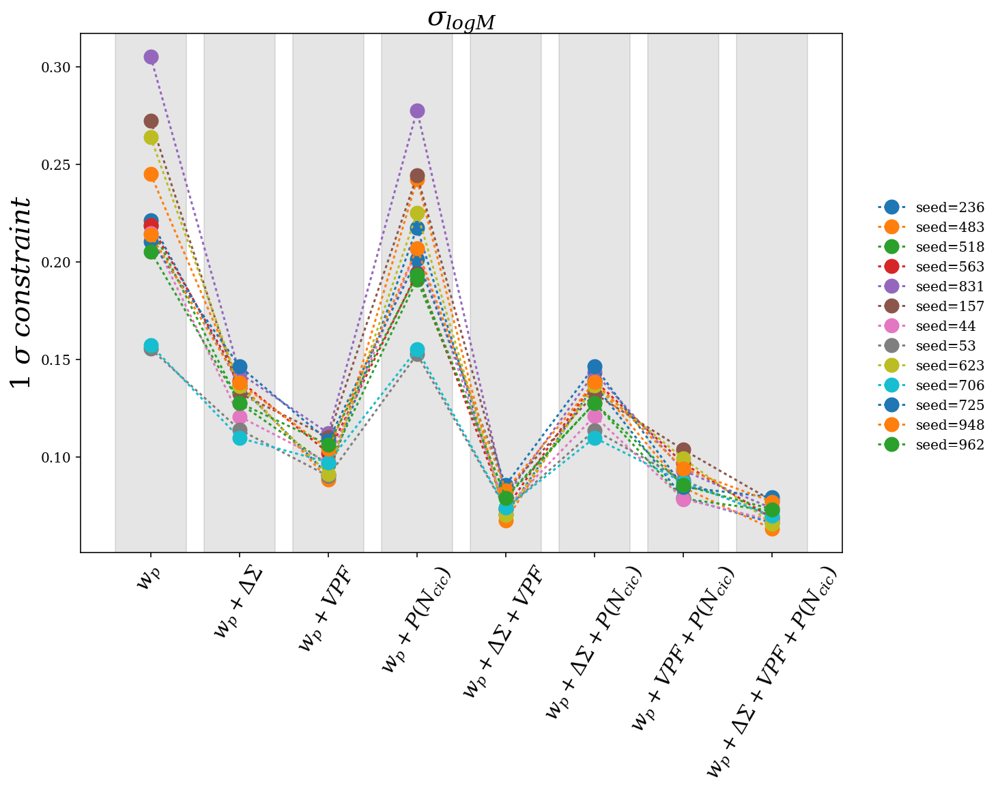

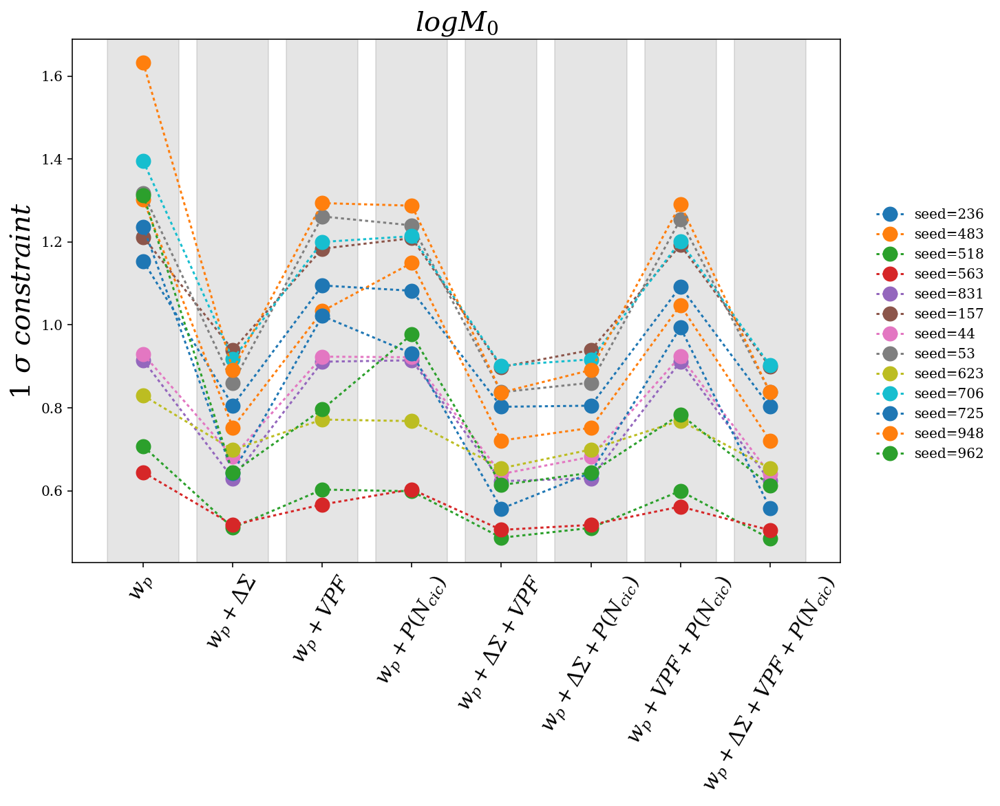

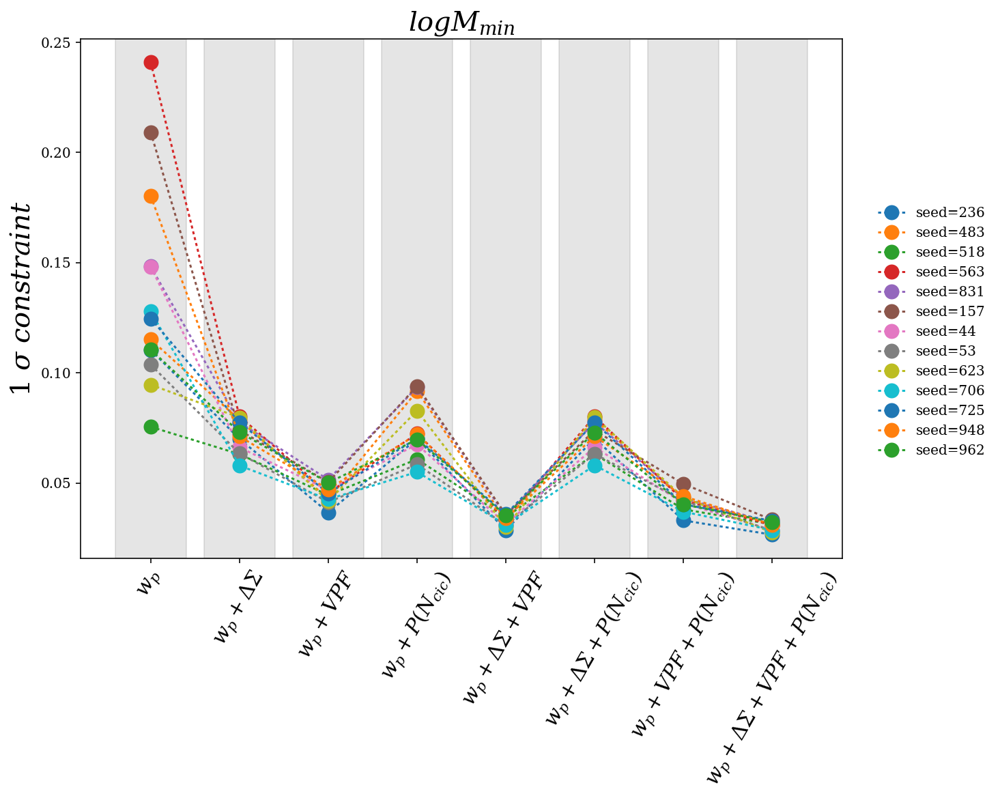

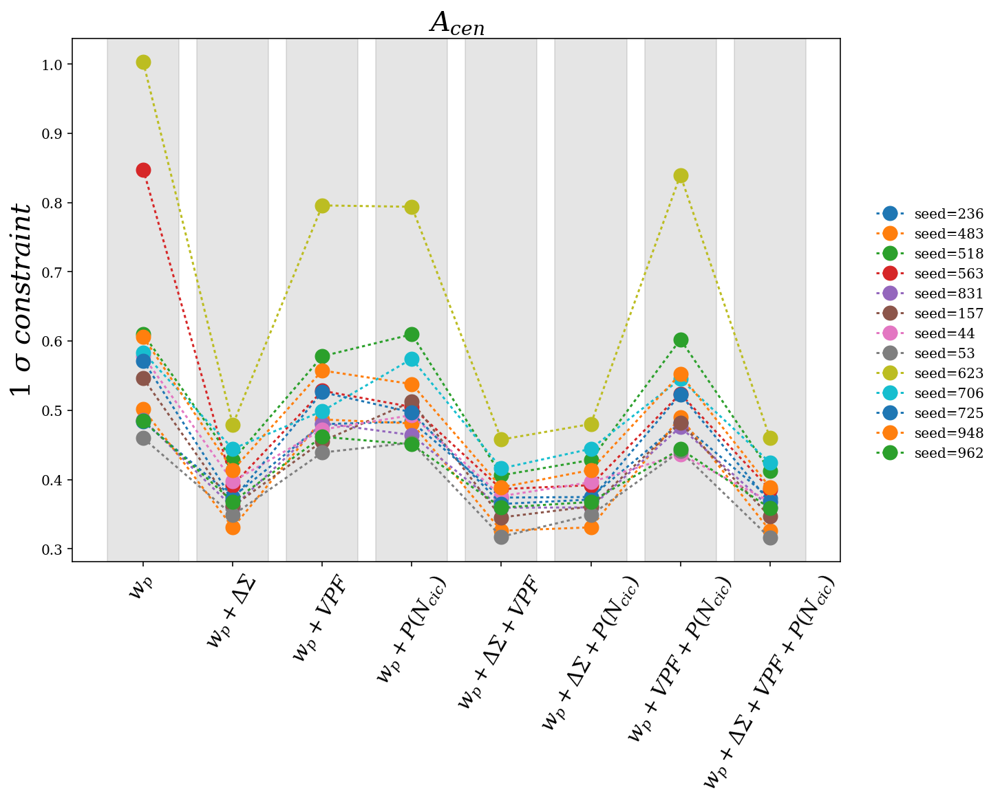

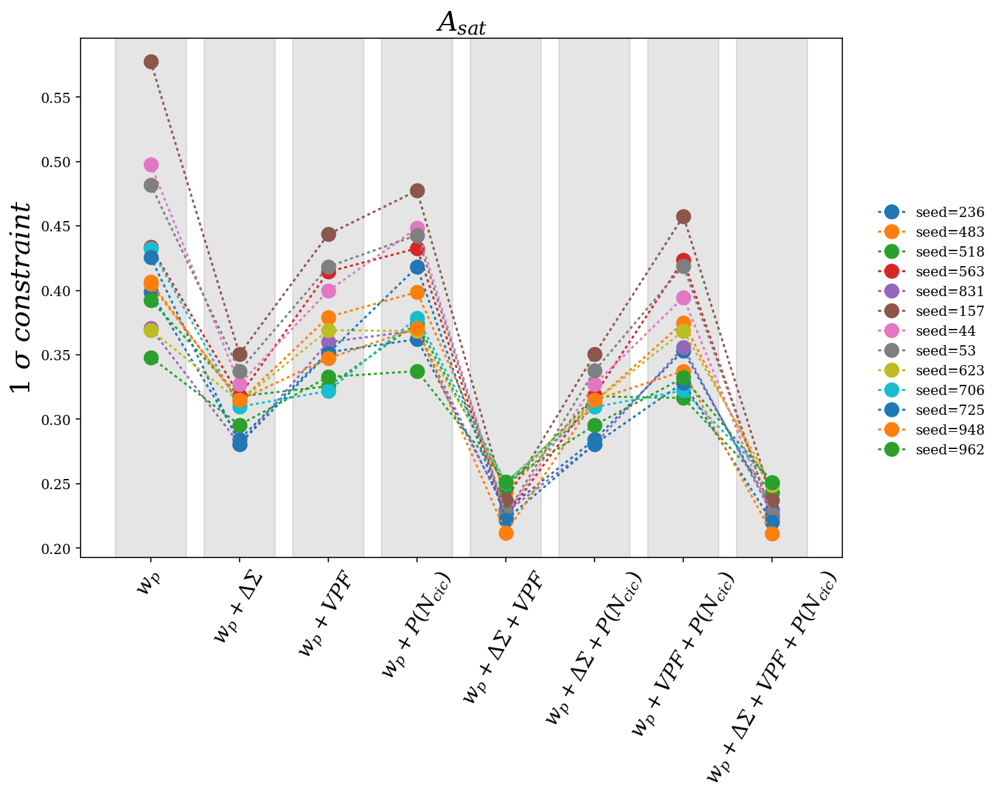

In [32]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236_8[:,i],'o:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483_8[:,i],'o:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518_8[:,i],'o:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563_8[:,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831_8[:,i],'o:',markersize=10,label='seed=831')
    plt.plot(range(1,9),all_1sigma_157_8[:,i],'o:',markersize=10,label='seed=157')
    plt.plot(range(1,9),all_1sigma_44_8[:,i],'o:',markersize=10,label='seed=44')
    plt.plot(range(1,9),all_1sigma_53_8[:,i],'o:',markersize=10,label='seed=53')
    plt.plot(range(1,9),all_1sigma_623_8[:,i],'o:',markersize=10,label='seed=623')
    plt.plot(range(1,9),all_1sigma_706_8[:,i],'o:',markersize=10,label='seed=706')
    plt.plot(range(1,9),all_1sigma_725_8[:,i],'o:',markersize=10,label='seed=725')
    plt.plot(range(1,9),all_1sigma_948_8[:,i],'o:',markersize=10,label='seed=948')
    plt.plot(range(1,9),all_1sigma_962_8[:,i],'o:',markersize=10,label='seed=962')
    plt.ylabel(r'$1\ \sigma\ constraint$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

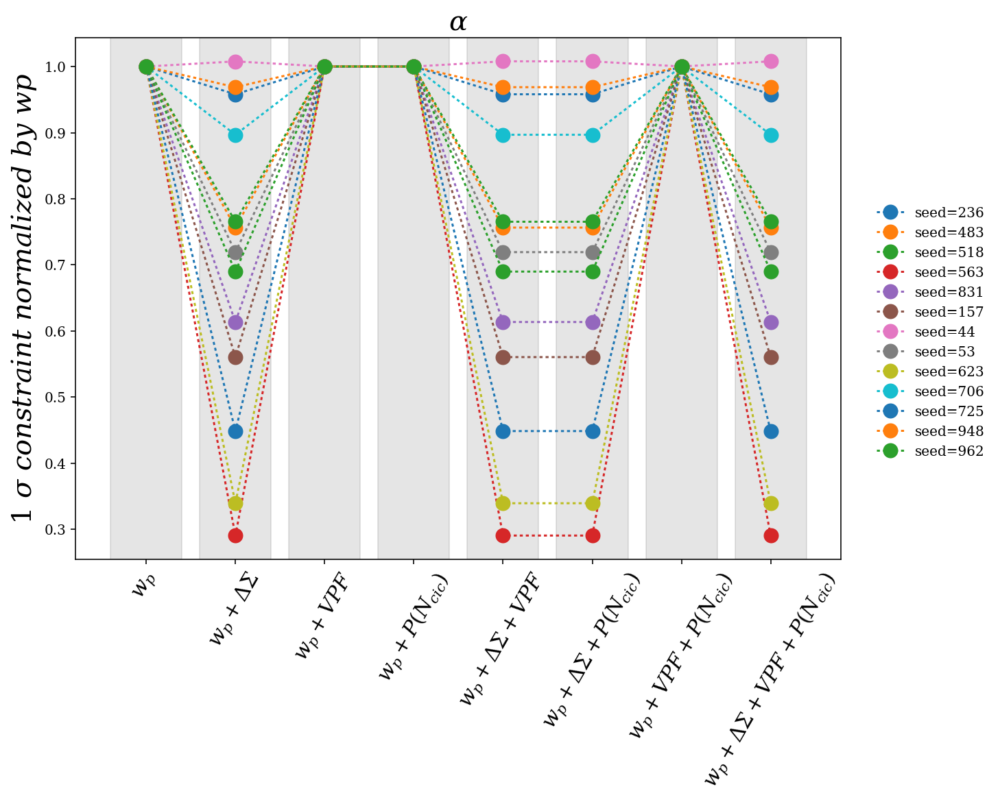

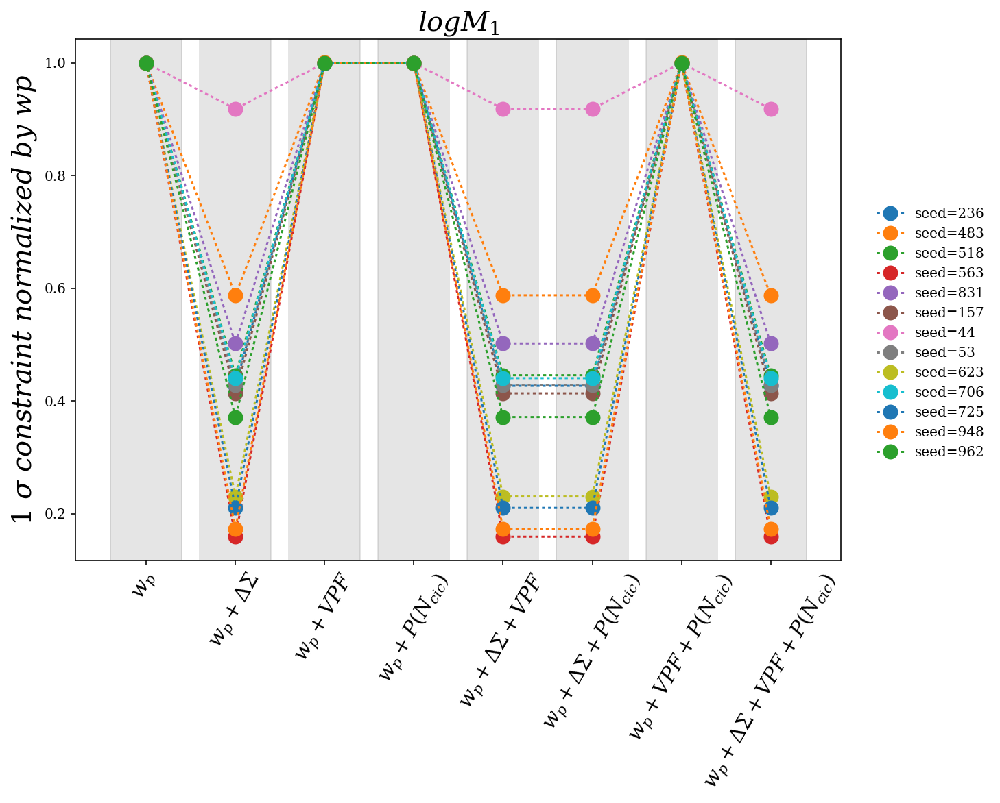

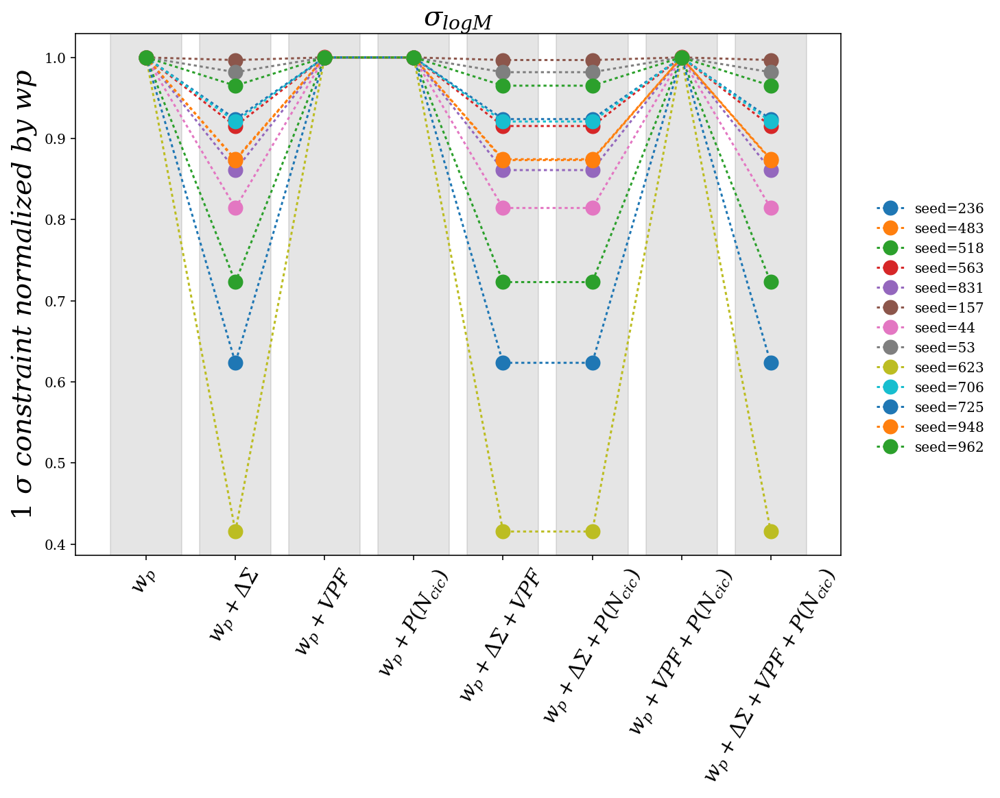

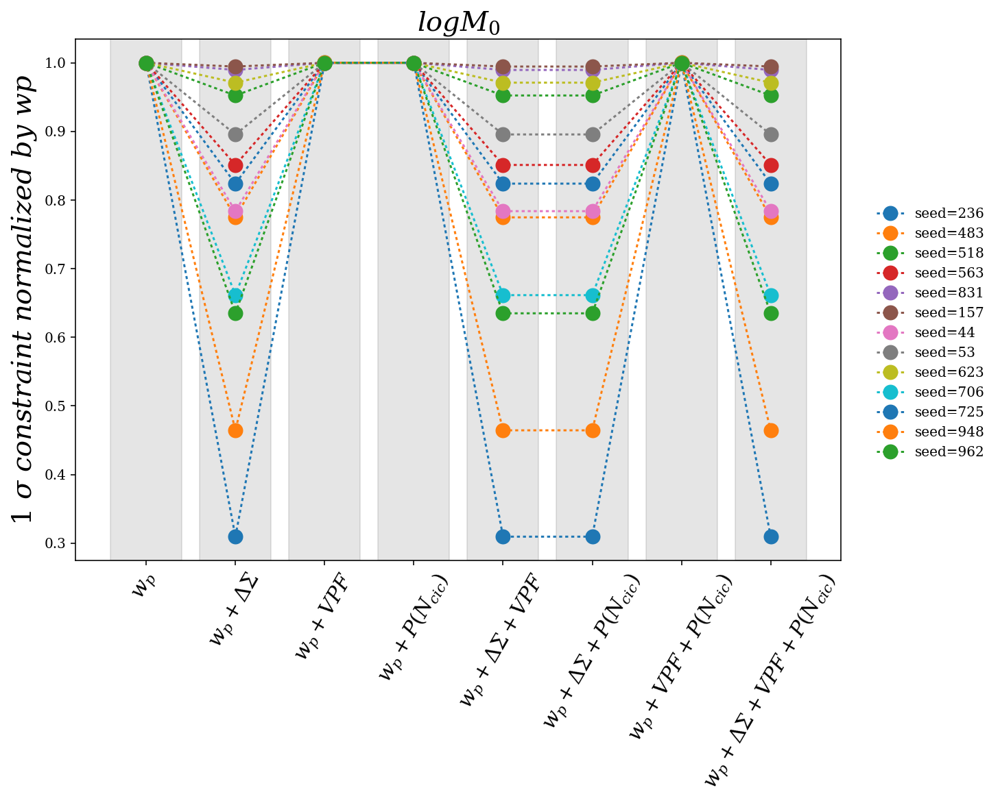

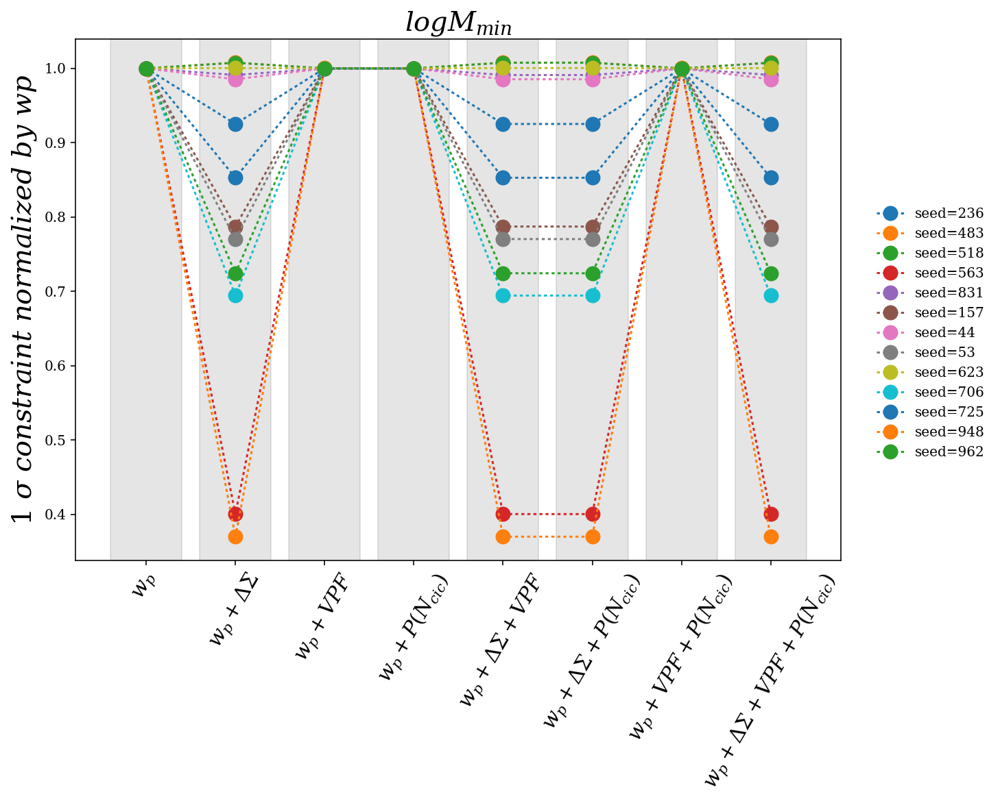

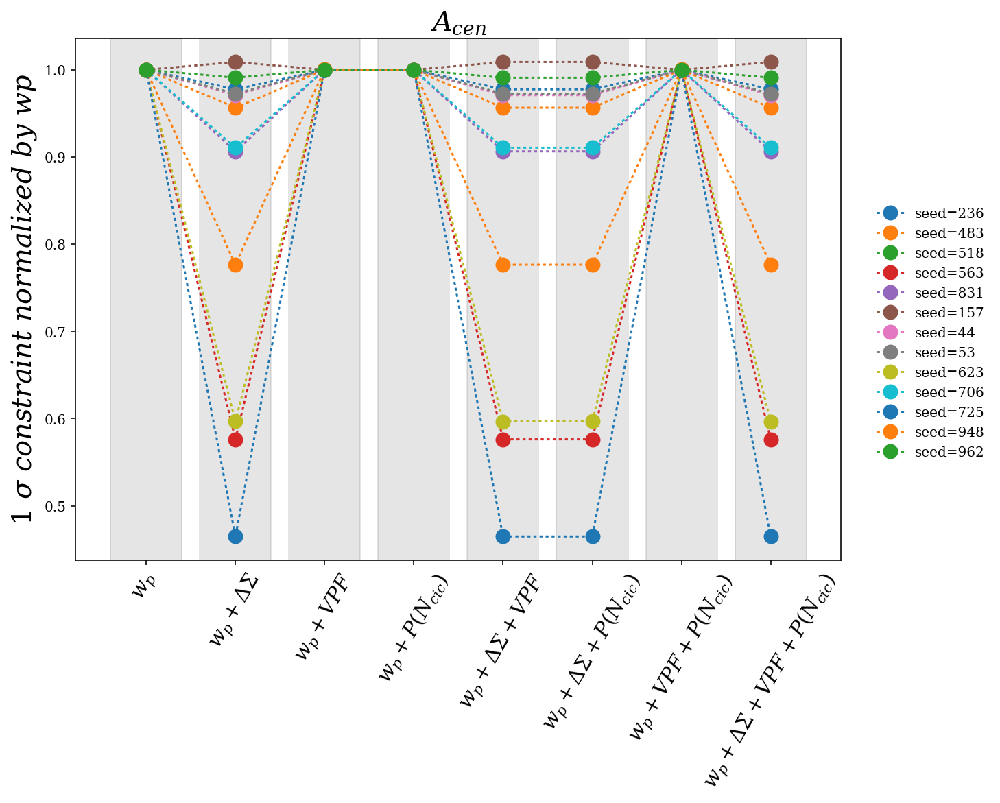

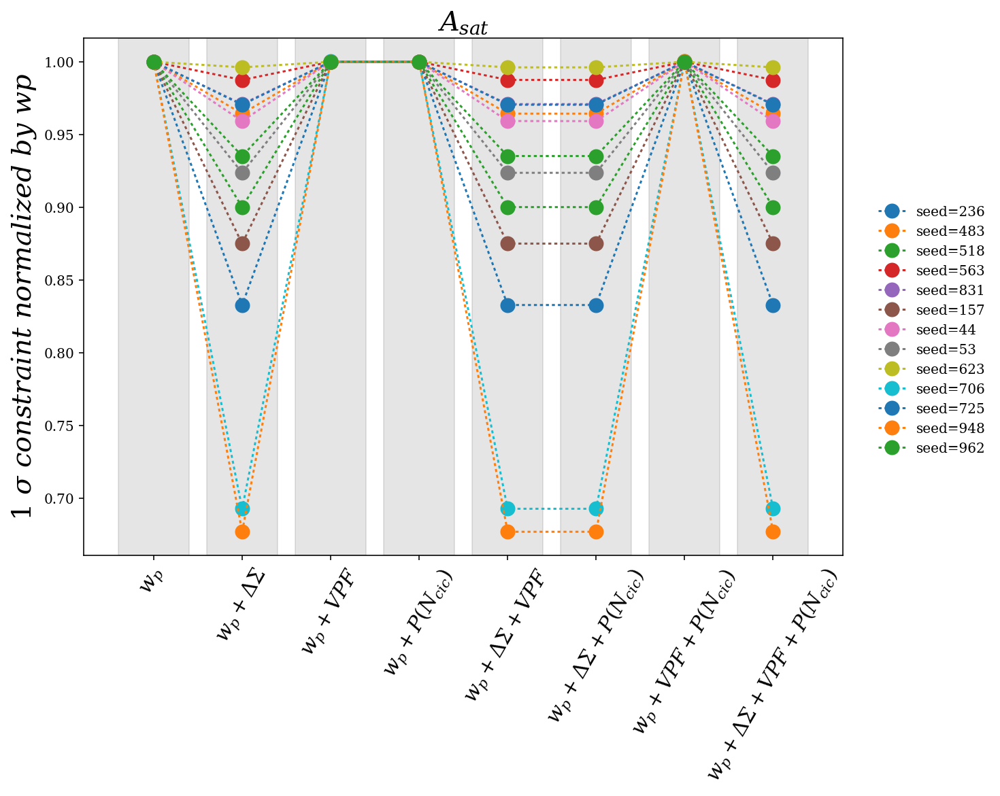

In [33]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236_3[:,i]/all_1sigma_236_3[0,i],'o:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483_3[:,i]/all_1sigma_483_3[0,i],'o:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518_3[:,i]/all_1sigma_518_3[0,i],'o:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563_3[:,i]/all_1sigma_563_3[0,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831_3[:,i]/all_1sigma_831_3[0,i],'o:',markersize=10,label='seed=831')
    plt.plot(range(1,9),all_1sigma_157_3[:,i]/all_1sigma_157_3[0,i],'o:',markersize=10,label='seed=157')
    plt.plot(range(1,9),all_1sigma_44_3[:,i]/all_1sigma_44_3[0,i],'o:',markersize=10,label='seed=44')
    plt.plot(range(1,9),all_1sigma_53_3[:,i]/all_1sigma_53_3[0,i],'o:',markersize=10,label='seed=53')
    plt.plot(range(1,9),all_1sigma_623_3[:,i]/all_1sigma_623_3[0,i],'o:',markersize=10,label='seed=623')
    plt.plot(range(1,9),all_1sigma_706_3[:,i]/all_1sigma_706_3[0,i],'o:',markersize=10,label='seed=706')
    plt.plot(range(1,9),all_1sigma_725_3[:,i]/all_1sigma_725_3[0,i],'o:',markersize=10,label='seed=725')
    plt.plot(range(1,9),all_1sigma_948_3[:,i]/all_1sigma_948_3[0,i],'o:',markersize=10,label='seed=948')
    plt.plot(range(1,9),all_1sigma_962_3[:,i]/all_1sigma_962_3[0,i],'o:',markersize=10,label='seed=962')
    plt.ylabel(r'$1\ \sigma\ constraint\ normalized\ by\ wp$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

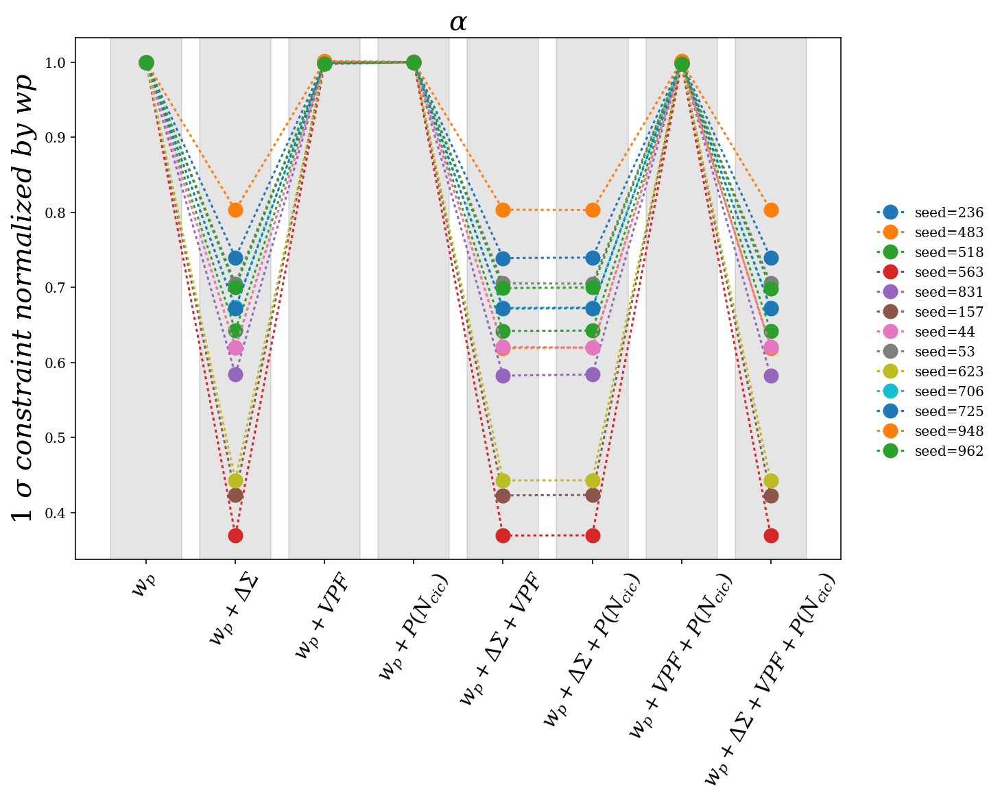

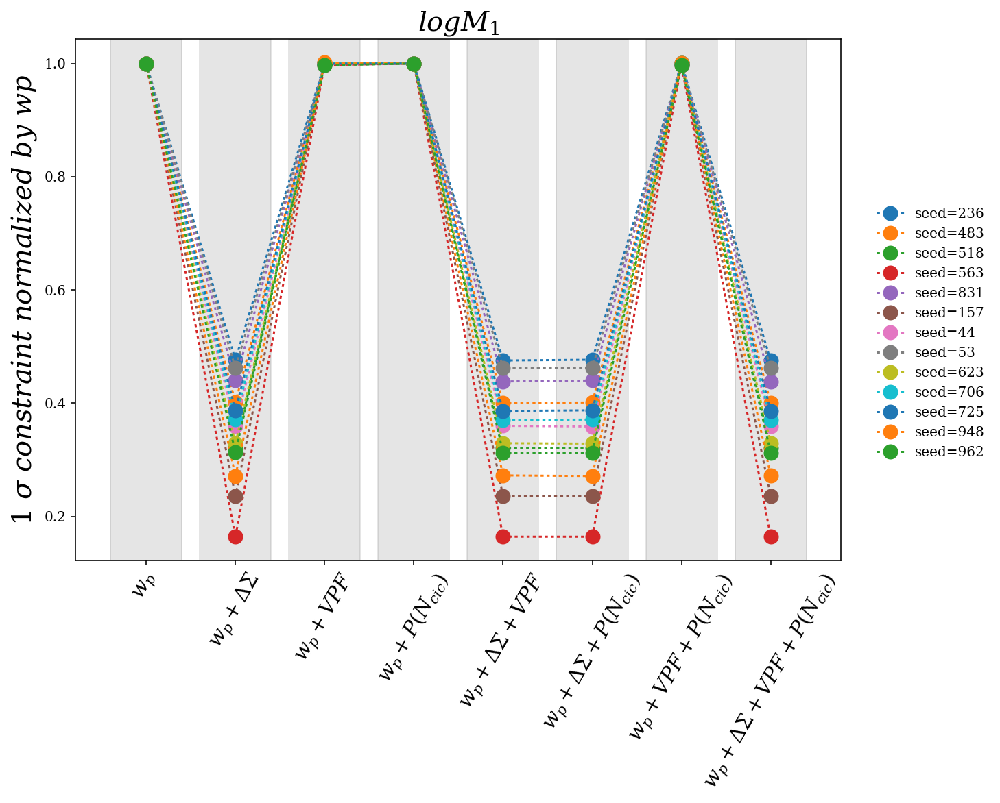

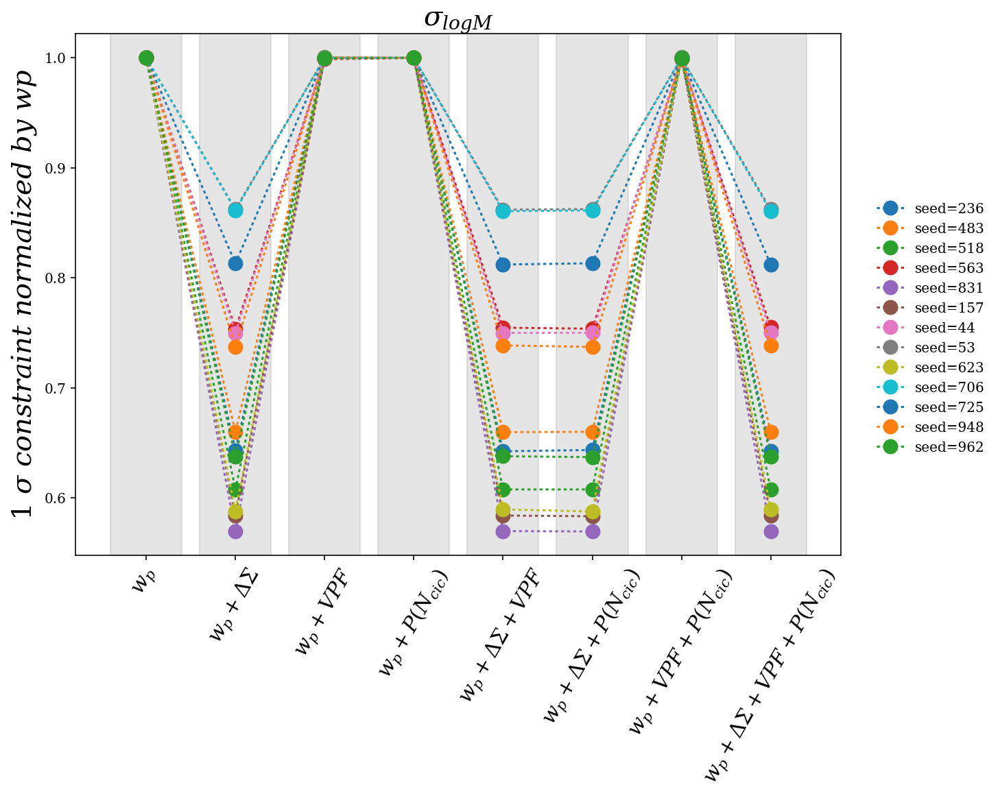

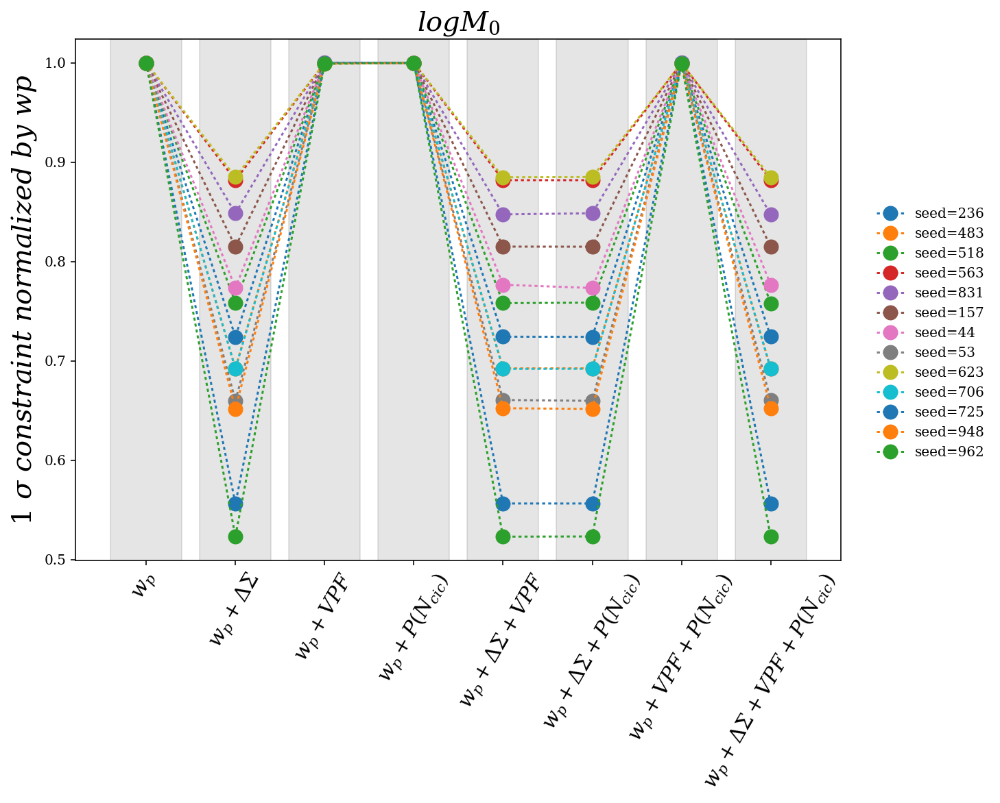

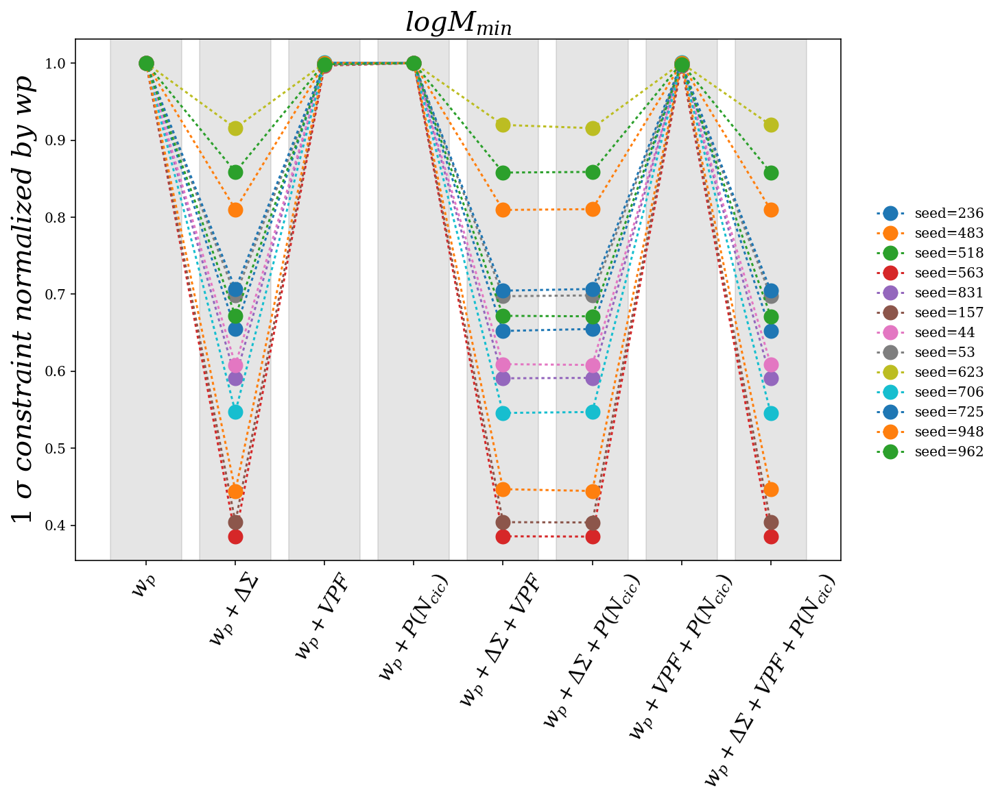

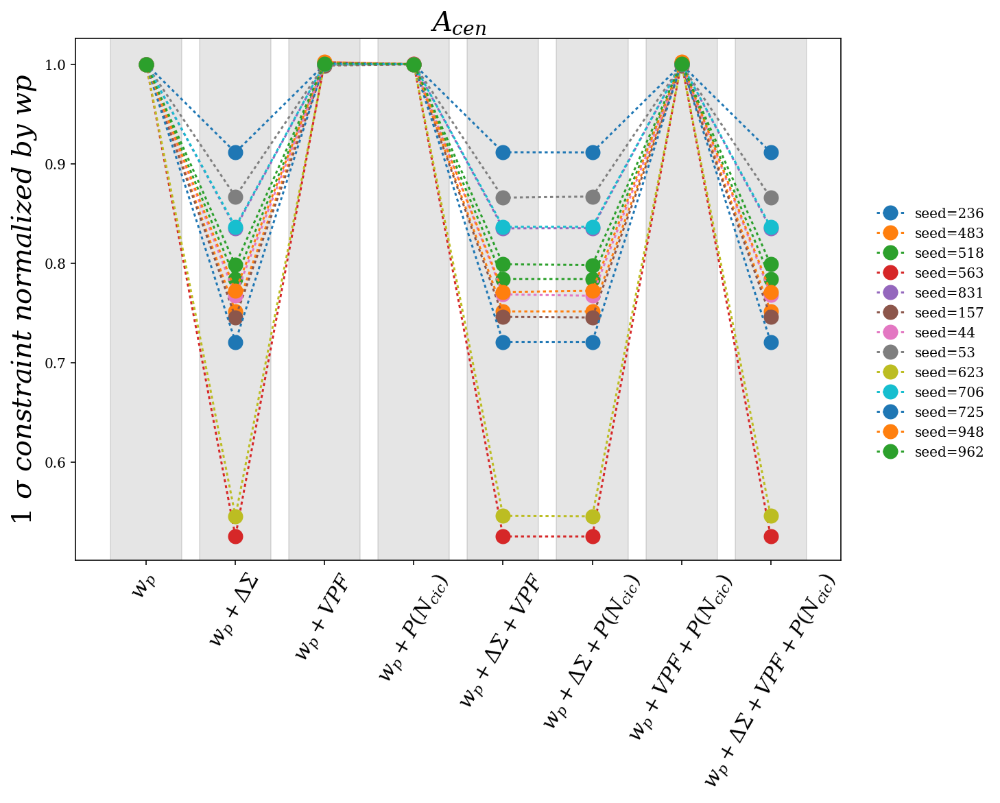

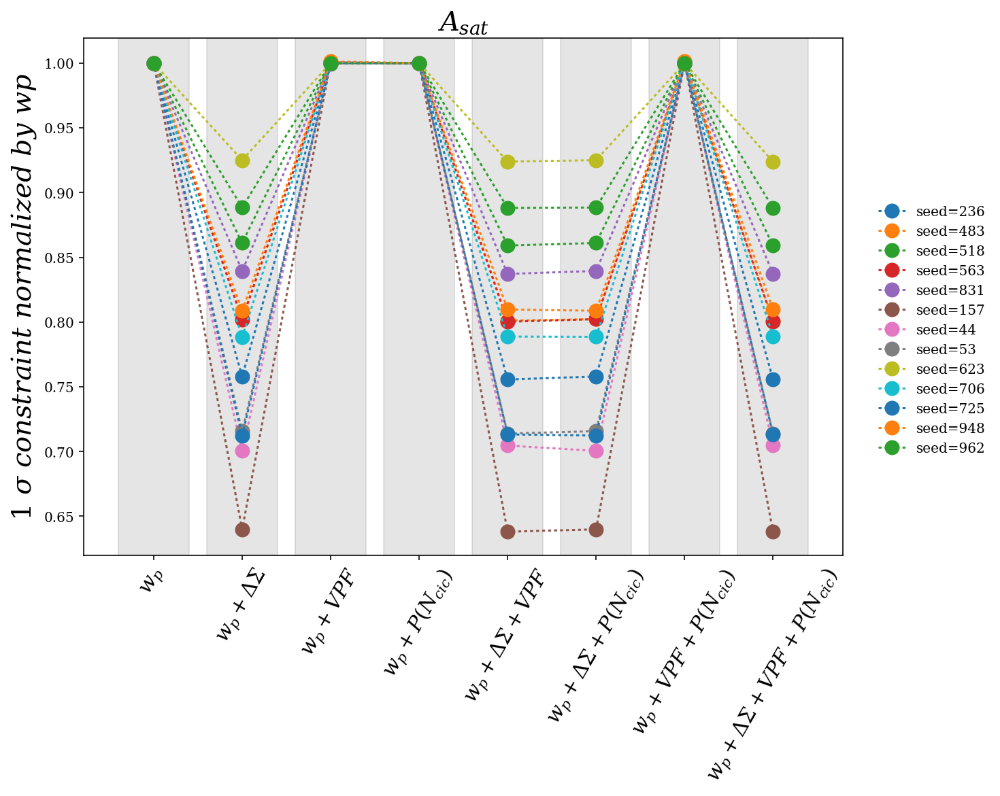

In [34]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236_6[:,i]/all_1sigma_236_6[0,i],'o:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483_6[:,i]/all_1sigma_483_6[0,i],'o:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518_6[:,i]/all_1sigma_518_6[0,i],'o:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563_6[:,i]/all_1sigma_563_6[0,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831_6[:,i]/all_1sigma_831_6[0,i],'o:',markersize=10,label='seed=831')
    plt.plot(range(1,9),all_1sigma_157_6[:,i]/all_1sigma_157_6[0,i],'o:',markersize=10,label='seed=157')
    plt.plot(range(1,9),all_1sigma_44_6[:,i]/all_1sigma_44_6[0,i],'o:',markersize=10,label='seed=44')
    plt.plot(range(1,9),all_1sigma_53_6[:,i]/all_1sigma_53_6[0,i],'o:',markersize=10,label='seed=53')
    plt.plot(range(1,9),all_1sigma_623_6[:,i]/all_1sigma_623_6[0,i],'o:',markersize=10,label='seed=623')
    plt.plot(range(1,9),all_1sigma_706_6[:,i]/all_1sigma_706_6[0,i],'o:',markersize=10,label='seed=706')
    plt.plot(range(1,9),all_1sigma_725_6[:,i]/all_1sigma_725_6[0,i],'o:',markersize=10,label='seed=725')
    plt.plot(range(1,9),all_1sigma_948_6[:,i]/all_1sigma_948_6[0,i],'o:',markersize=10,label='seed=948')
    plt.plot(range(1,9),all_1sigma_962_6[:,i]/all_1sigma_962_6[0,i],'o:',markersize=10,label='seed=962')
    plt.ylabel(r'$1\ \sigma\ constraint\ normalized\ by\ wp$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

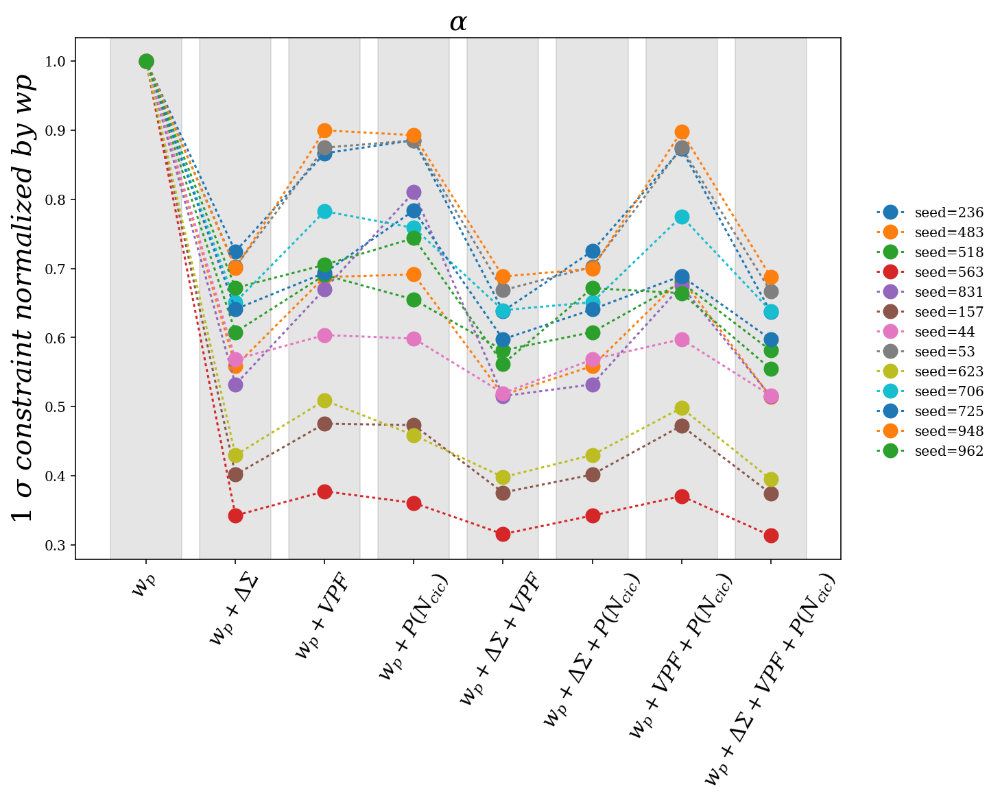

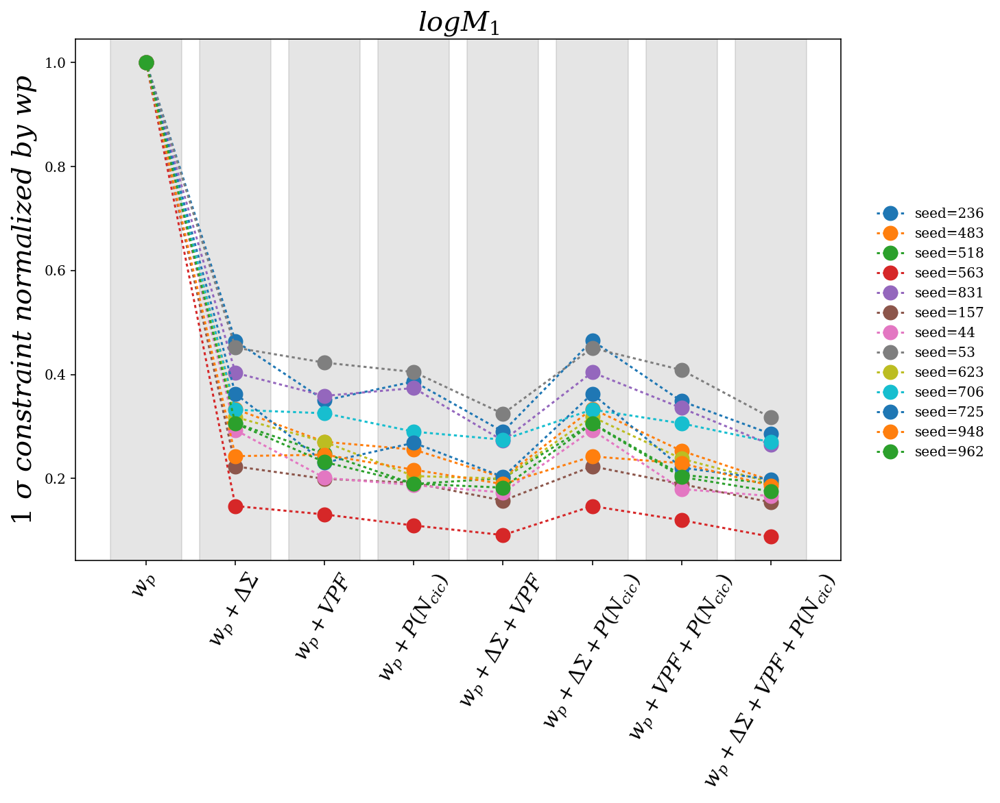

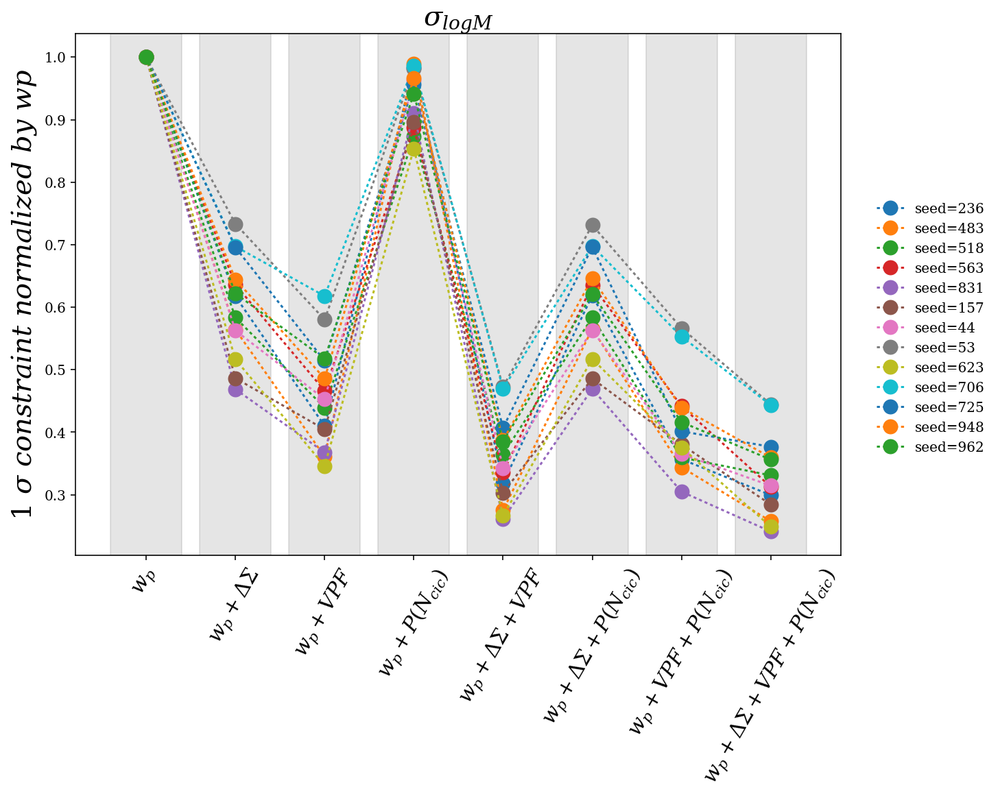

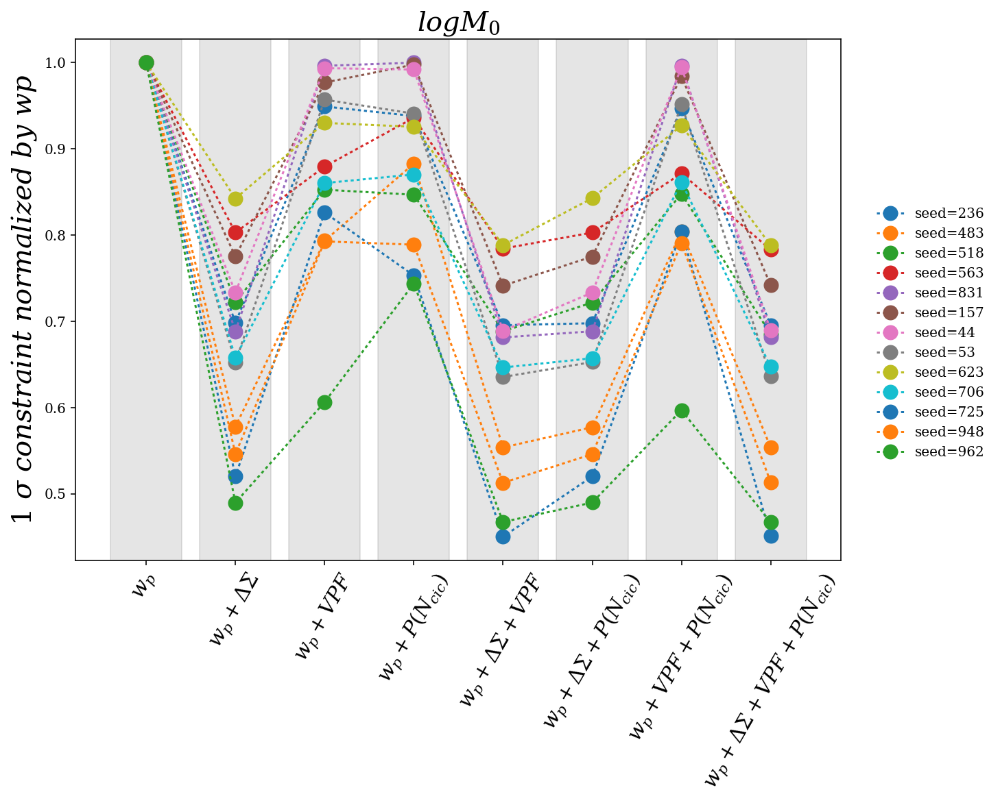

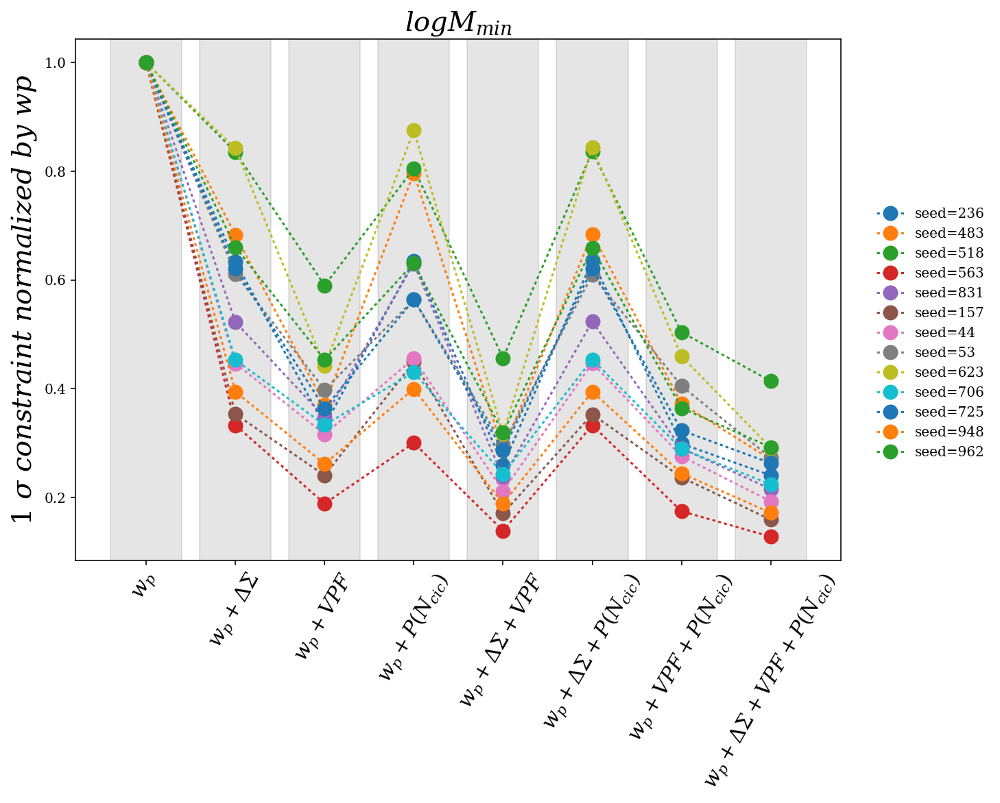

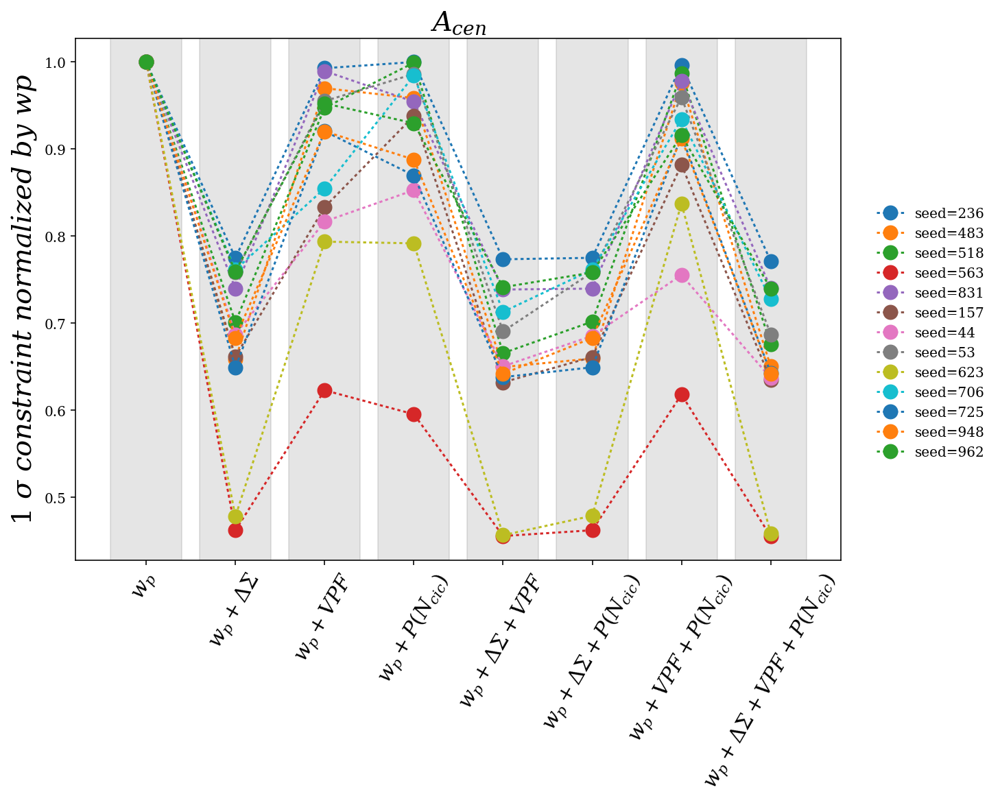

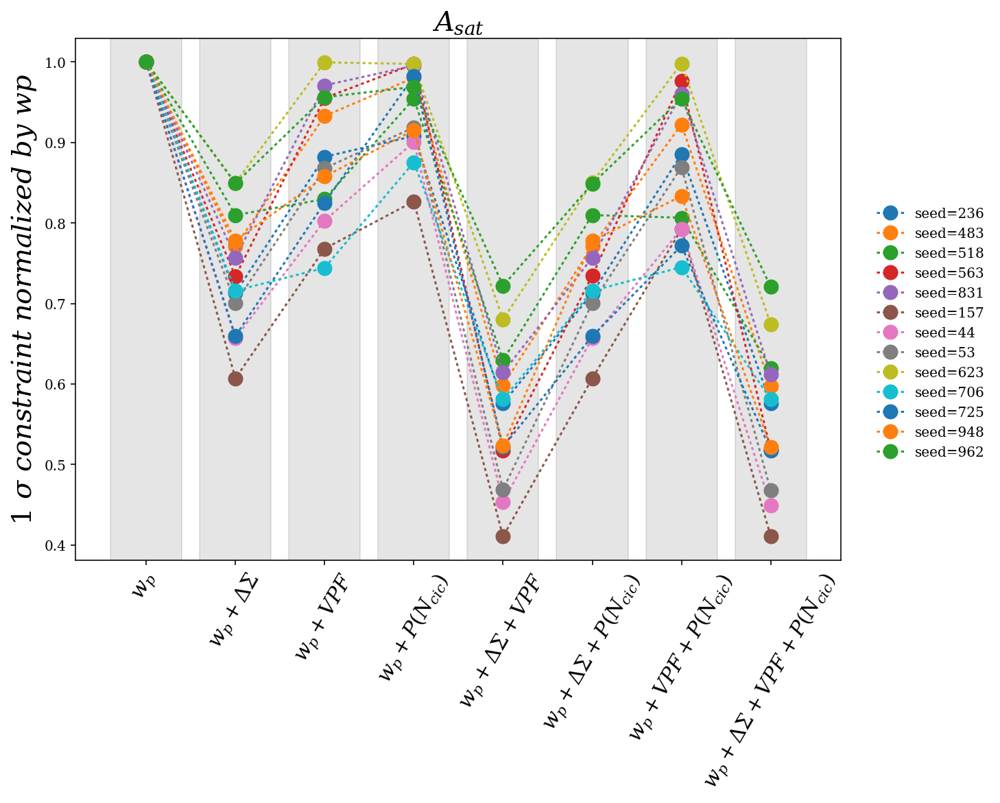

In [35]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236_8[:,i]/all_1sigma_236_8[0,i],'o:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483_8[:,i]/all_1sigma_483_8[0,i],'o:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518_8[:,i]/all_1sigma_518_8[0,i],'o:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563_8[:,i]/all_1sigma_563_8[0,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831_8[:,i]/all_1sigma_831_8[0,i],'o:',markersize=10,label='seed=831')
    plt.plot(range(1,9),all_1sigma_157_8[:,i]/all_1sigma_157_8[0,i],'o:',markersize=10,label='seed=157')
    plt.plot(range(1,9),all_1sigma_44_8[:,i]/all_1sigma_44_8[0,i],'o:',markersize=10,label='seed=44')
    plt.plot(range(1,9),all_1sigma_53_8[:,i]/all_1sigma_53_8[0,i],'o:',markersize=10,label='seed=53')
    plt.plot(range(1,9),all_1sigma_623_8[:,i]/all_1sigma_623_8[0,i],'o:',markersize=10,label='seed=623')
    plt.plot(range(1,9),all_1sigma_706_8[:,i]/all_1sigma_706_8[0,i],'o:',markersize=10,label='seed=706')
    plt.plot(range(1,9),all_1sigma_725_8[:,i]/all_1sigma_725_8[0,i],'o:',markersize=10,label='seed=725')
    plt.plot(range(1,9),all_1sigma_948_8[:,i]/all_1sigma_948_8[0,i],'o:',markersize=10,label='seed=948')
    plt.plot(range(1,9),all_1sigma_962_8[:,i]/all_1sigma_962_8[0,i],'o:',markersize=10,label='seed=962')
    plt.ylabel(r'$1\ \sigma\ constraint\ normalized\ by\ wp$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False,bbox_to_anchor=[1.03,0.7])

In [52]:
print all_1sigma_157_3
print '--------------'
print all_1sigma_157_4
print '--------------'
print all_1sigma_157_5
print '--------------'
print all_1sigma_157_6
print '--------------'
print all_1sigma_157_8

[[ 0.11732293  0.25778649  0.41044295  1.78213006  0.30668319  0.76473637
   1.02923819]
 [ 0.06575574  0.10666128  0.40911178  1.77230306  0.24142284  0.77156688
   0.90050619]
 [ 0.11734024  0.25781735  0.41045576  1.78221141  0.30671328  0.76473255
   1.02928469]
 [ 0.11732492  0.25779004  0.41044538  1.78214285  0.3066875   0.76473671
   1.02924916]
 [ 0.06576017  0.10667094  0.4091229   1.77235753  0.24143486  0.77156546
   0.90053119]
 [ 0.06575651  0.10666302  0.40911404  1.77231342  0.24142513  0.77156722
   0.9005115 ]
 [ 0.11734223  0.2578209   0.41045818  1.78222422  0.30671759  0.76473289
   1.02929566]
 [ 0.06576094  0.10667267  0.40912515  1.7723679   0.24143715  0.7715658
   0.90053651]]
--------------
[[ 0.08706341  0.20248428  0.31079049  1.40203271  0.23612917  0.61491901
   0.63000269]
 [ 0.0450135   0.07340809  0.28731148  1.2478457   0.1617086   0.55931694
   0.46134254]
 [ 0.08706389  0.20247124  0.31081062  1.40209163  0.23613543  0.61487927
   0.62996208]
 [ 0.0

In [8]:
def eig_analysis(cov):
    order = np.argsort(-np.linalg.eig(cov)[0])
    #plt.semilogy()
    plt.grid(axis=u'y')
    plt.plot(np.linalg.eig(cov)[0][order]/np.linalg.eig(cov)[0][order][0],'.')
    plt.xlabel('n')
    plt.ylabel('nth largest eigenvalue')
    print np.linalg.eig(cov)[0][order]/np.linalg.eig(cov)[0][order][0]

[  1.00000000e+00   1.55552983e-01   6.42570102e-02   3.43687047e-02
   2.14575715e-02   1.58900105e-02   7.86930180e-03   6.20926114e-03
   3.62974832e-03   1.97389588e-03   1.21681726e-03   8.10053040e-04
   4.84754173e-04   4.16582359e-04   1.95770534e-04   1.45577993e-04
   1.04439426e-04   5.87927748e-05   4.17045461e-05   1.44598085e-11]


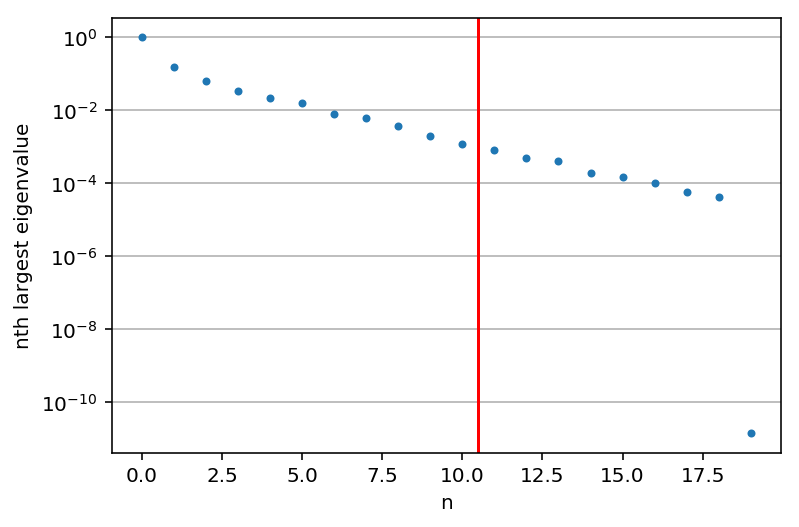

In [49]:
eig_analysis(cov_w)
plt.semilogy()
plt.axvline(10.5,color='r')
inv_cov_w = np.linalg.pinv(cov_w,rcond=1e-3)

[  1.00000000e+00   1.55531903e-01   6.42583910e-02   3.43830110e-02
   2.14575549e-02   1.59226753e-02   7.88503658e-03   6.24866851e-03
   3.63744453e-03   1.98338052e-03   1.22803925e-03   1.00138046e-03
   8.07002119e-04   5.21121918e-04   4.49875743e-04   4.03560514e-04
   2.53412297e-04   1.97677229e-04   1.56896896e-04   1.25906463e-04
   1.03192447e-04   8.35783639e-05   6.05548529e-05   4.78892007e-05
   4.17325697e-05   3.13582528e-05   1.63529757e-05   8.21123486e-06
   5.87589028e-06   5.05110120e-06   2.14041143e-06   1.77860957e-06
   9.95968703e-07   8.44884298e-07   7.37731198e-07   5.93010774e-07
   3.25827840e-07   1.83368475e-07   1.48948597e-07   2.11742620e-12]


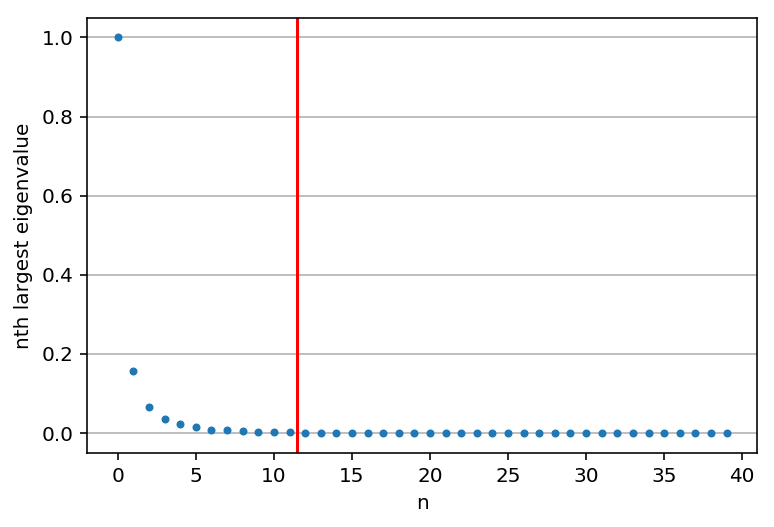

In [31]:
eig_analysis(cov_wd)
plt.axvline(11.5,color='r')
inv_cov_wd = np.linalg.pinv(cov_wd,rcond=1e-3)

[  1.00000000e+00   1.55552991e-01   6.42570106e-02   3.43687150e-02
   2.14575789e-02   1.58900295e-02   7.86931473e-03   6.20926251e-03
   3.62974883e-03   1.97390019e-03   1.21681804e-03   8.10058756e-04
   4.84754391e-04   4.16582901e-04   1.95771026e-04   1.45578195e-04
   1.04440059e-04   5.88007191e-05   4.17050962e-05   1.83243771e-07
   1.82703150e-08   6.57336254e-09   3.78170465e-09   2.38564517e-09
   1.44561092e-09   1.25520699e-09   7.35363181e-10   6.63770456e-10
   5.69169068e-10   4.92046717e-10   4.20049219e-10   3.44363122e-10
   2.89253816e-10   2.45396442e-10   1.59481826e-10   1.46174452e-10
   1.08757445e-10   8.50607279e-11   3.72251804e-11   2.68044982e-12]


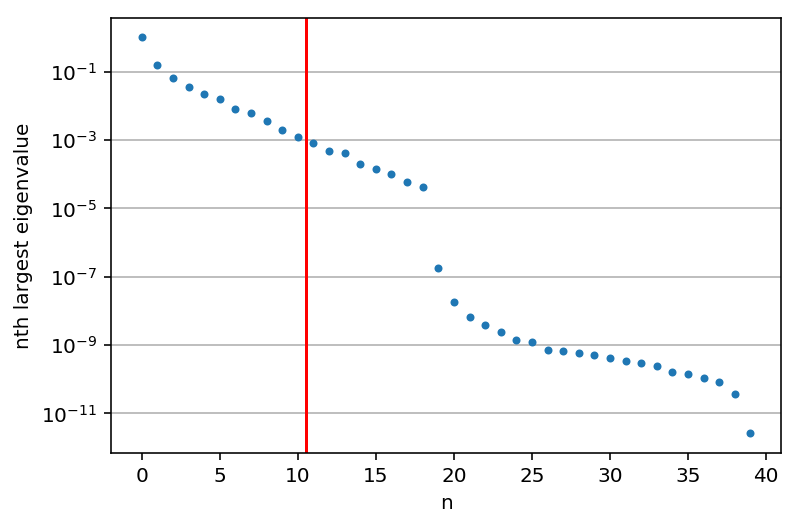

In [50]:
plt.semilogy()
eig_analysis(cov_wv)
plt.axvline(10.5,color='r')
inv_cov_wv = np.linalg.pinv(cov_wv,rcond=1e-3)

[  1.00000000e+00   1.55552983e-01   6.42570103e-02   3.43687061e-02
   2.14575722e-02   1.58900127e-02   7.86930231e-03   6.20926144e-03
   3.62974874e-03   1.97389664e-03   1.21681745e-03   8.10053299e-04
   4.84754385e-04   4.16582799e-04   1.95770991e-04   1.45578382e-04
   1.04439724e-04   5.87930284e-05   4.17046782e-05   1.70937258e-08
   3.86807560e-09   3.46615847e-09   3.22491918e-09   2.88413503e-09
   2.45161186e-09   2.29558597e-09   1.87480684e-09   1.53849178e-09
   1.48908386e-09   1.06767681e-09   9.52486956e-10   8.85931461e-10
   7.08491553e-10   5.61339999e-10   5.12799608e-10   4.22989980e-10
   3.78804823e-10   2.94337969e-10   2.32380466e-10   2.00032007e-10
   1.75225602e-10   1.48331094e-10   1.24586732e-10   1.01060600e-10
   9.02579167e-11   7.63219879e-11   6.39700128e-11   5.71318848e-11
   4.89282380e-11   4.58923968e-11   4.33534161e-11   3.67132833e-11
   3.19731338e-11   3.00225741e-11   2.68983611e-11   2.50122615e-11
   2.05493343e-11   1.35946569e-11

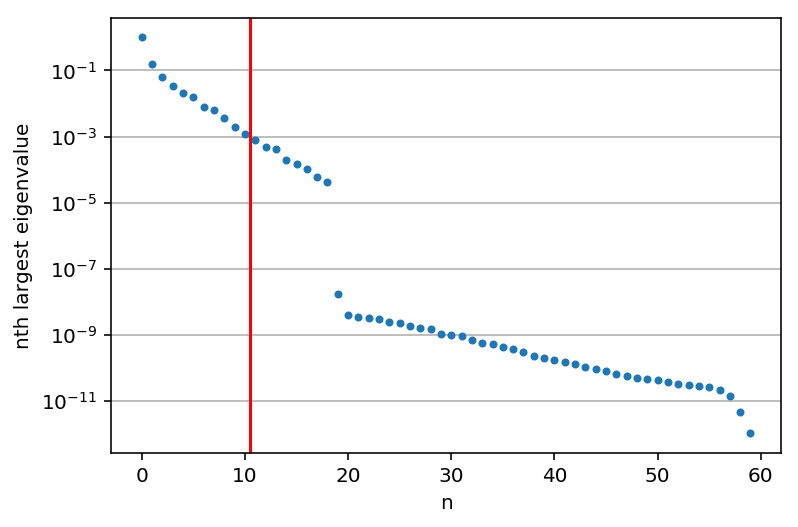

In [53]:
eig_analysis(cov_wc)
plt.semilogy()
plt.axvline(10.5,color='r')
inv_cov_wc = np.linalg.pinv(cov_wc,rcond=1e-3)

[  1.00000000e+00   1.55531911e-01   6.42583914e-02   3.43830214e-02
   2.14575623e-02   1.59226946e-02   7.88504973e-03   6.24866980e-03
   3.63744502e-03   1.98338538e-03   1.22804028e-03   1.00138638e-03
   8.07006234e-04   5.21122335e-04   4.49876100e-04   4.03567052e-04
   2.53415772e-04   1.97678471e-04   1.56911106e-04   1.25913404e-04
   1.03193177e-04   8.35842608e-05   6.05744341e-05   4.79296889e-05
   4.17346849e-05   3.13605476e-05   1.63543008e-05   8.21145415e-06
   5.87609217e-06   5.05183801e-06   2.14050924e-06   1.78064609e-06
   9.97145727e-07   8.46230673e-07   7.39841406e-07   5.94158133e-07
   3.26898185e-07   1.83894005e-07   1.54887757e-07   7.12672970e-08
   1.42287556e-08   5.95174981e-09   3.54061444e-09   2.25230524e-09
   1.36643085e-09   1.18639633e-09   6.88576605e-10   6.20316856e-10
   5.08136289e-10   4.65036800e-10   3.79194631e-10   3.19599465e-10
   2.53747833e-10   2.19358675e-10   1.49676183e-10   1.37231569e-10
   9.41212501e-11   7.86380939e-11

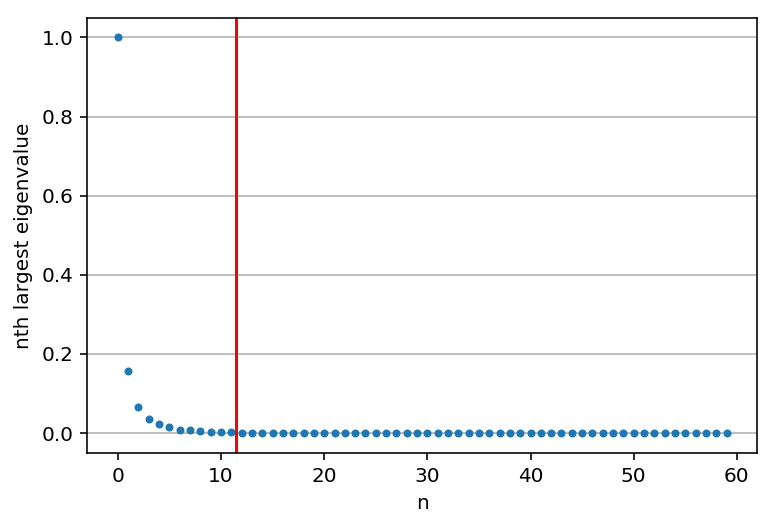

In [23]:
eig_analysis(cov_wdv)
plt.axvline(11.5,color='r')
inv_cov_wdv = np.linalg.pinv(cov_wdv,rcond=1e-3)

[  1.00000000e+00   1.55531903e-01   6.42583911e-02   3.43830124e-02
   2.14575556e-02   1.59226775e-02   7.88503711e-03   6.24866881e-03
   3.63744496e-03   1.98338136e-03   1.22803946e-03   1.00138114e-03
   8.07002366e-04   5.21122072e-04   4.49875960e-04   4.03561565e-04
   2.53412796e-04   1.97677976e-04   1.56898668e-04   1.25907217e-04
   1.03192768e-04   8.35792641e-05   6.05556766e-05   4.78943999e-05
   4.17331449e-05   3.13589508e-05   1.63543387e-05   8.21150812e-06
   5.87613571e-06   5.05117956e-06   2.14057994e-06   1.77874002e-06
   9.96166508e-07   8.45169210e-07   7.37915640e-07   5.93154882e-07
   3.26029292e-07   1.83617533e-07   1.49135338e-07   4.36421776e-09
   3.55501574e-09   3.10116746e-09   2.81049422e-09   2.52707915e-09
   2.24645201e-09   1.83180013e-09   1.68060162e-09   1.37563932e-09
   1.29010074e-09   9.78335934e-10   8.40590705e-10   7.39395882e-10
   6.30466639e-10   5.05899334e-10   5.02943011e-10   3.77090188e-10
   3.43950314e-10   2.80303683e-10

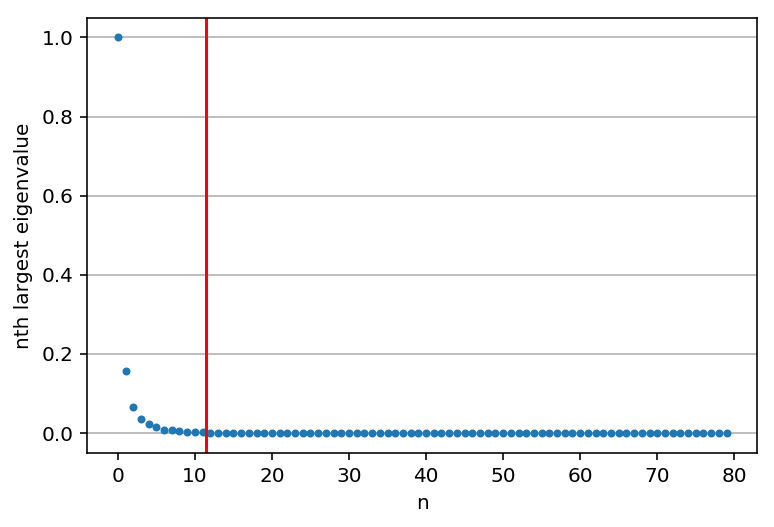

In [25]:
eig_analysis(cov_wdc)
plt.axvline(11.5,color='r')
inv_cov_wdc = np.linalg.pinv(cov_wdc,rcond=1e-3)

[  1.00000000e+00   1.55552992e-01   6.42570107e-02   3.43687164e-02
   2.14575796e-02   1.58900317e-02   7.86931525e-03   6.20926280e-03
   3.62974925e-03   1.97390095e-03   1.21681823e-03   8.10059016e-04
   4.84754602e-04   4.16583341e-04   1.95771483e-04   1.45578584e-04
   1.04440356e-04   5.88009737e-05   4.17052284e-05   1.91207866e-07
   2.06619703e-08   8.29965794e-09   6.10318140e-09   3.84985139e-09
   3.64832218e-09   3.31728700e-09   3.25130709e-09   2.76663821e-09
   2.56728334e-09   2.29384841e-09   2.16625798e-09   1.89730676e-09
   1.57500056e-09   1.50849700e-09   1.34242667e-09   1.19538741e-09
   1.01267066e-09   9.21565690e-10   8.89607625e-10   7.05191780e-10
   6.92726249e-10   6.06804359e-10   5.70908896e-10   5.20009244e-10
   4.78053324e-10   4.59573155e-10   4.22735480e-10   3.78290683e-10
   3.73765855e-10   3.24173885e-10   2.90749856e-10   2.67453852e-10
   2.36646067e-10   2.29417356e-10   1.95403146e-10   1.71794622e-10
   1.40808024e-10   1.39849274e-10

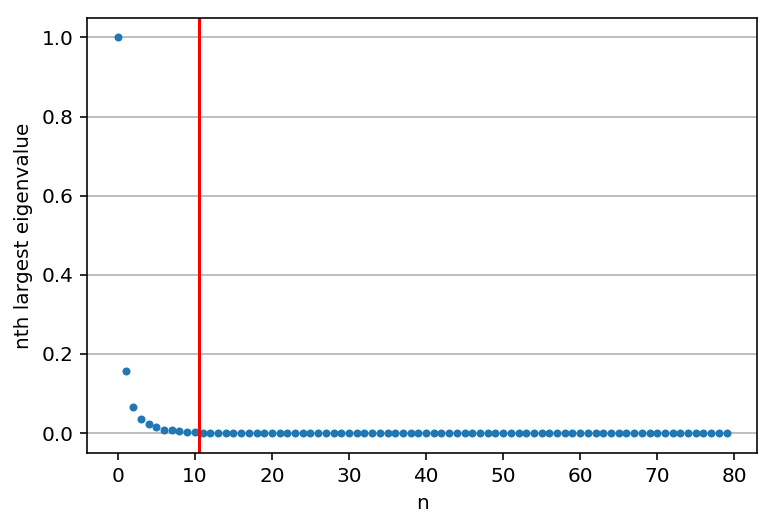

In [27]:
eig_analysis(cov_wvc)
plt.axvline(10.5,color='r')
inv_cov_wvc = np.linalg.pinv(cov_wvc,rcond=1e-3)

[  1.00000000e+00   1.55531911e-01   6.42583915e-02   3.43830228e-02
   2.14575630e-02   1.59226968e-02   7.88505026e-03   6.24867009e-03
   3.63744545e-03   1.98338622e-03   1.22804049e-03   1.00138706e-03
   8.07006481e-04   5.21122489e-04   4.49876317e-04   4.03568104e-04
   2.53416271e-04   1.97679217e-04   1.56912881e-04   1.25914158e-04
   1.03193499e-04   8.35851633e-05   6.05752653e-05   4.79348848e-05
   4.17352557e-05   3.13612432e-05   1.63556625e-05   8.21172722e-06
   5.87633765e-06   5.05191626e-06   2.14067779e-06   1.78077625e-06
   9.97343045e-07   8.46514398e-07   7.40031324e-07   5.94302807e-07
   3.27104278e-07   1.84139226e-07   1.55079392e-07   7.13712505e-08
   1.44391970e-08   6.26695086e-09   4.35258317e-09   3.55454458e-09
   3.43809877e-09   3.08158439e-09   2.85231917e-09   2.53279127e-09
   2.32102761e-09   2.19040737e-09   1.76494768e-09   1.74174147e-09
   1.39187750e-09   1.30297641e-09   1.27082835e-09   1.12313359e-09
   9.38039914e-10   8.54499202e-10

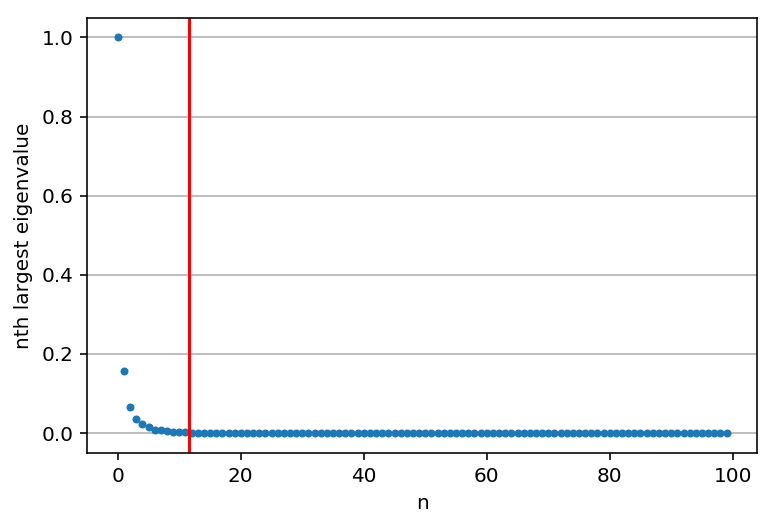

In [29]:
eig_analysis(cov_wdvc)
plt.axvline(11.5,color='r')
inv_cov_wdvc = np.linalg.pinv(cov_wdvc,rcond=1e-3)

In [32]:
dfdp = np.load('Run_062718/dfdp_bolp_20p0_um0_tcub_alpha07.npz')

In [33]:
dfdp.files

['dfdp_483', 'dfdp_236', 'dfdp_831', 'dfdp_518', 'dfdp_563']

In [34]:
def chop_dfdp(dfdp,comp):
    if comp=='w':
        return dfdp[:,:20]
    elif comp=='wd':
        return dfdp[:,:40]
    elif comp=='wv':
        return np.block([dfdp[:,:20],dfdp[:,40:60]])
    elif comp=='wc':
        return np.block([dfdp[:,:20],dfdp[:,60:]])
    elif comp=='wdv':
        return dfdp[:,:60]
    elif comp=='wdc':
        return np.block([dfdp[:,:40],dfdp[:,60:]])
    elif comp=='wvc':
        return np.block([dfdp[:,:20],dfdp[:,40:]])
    elif comp=='wdvc':
        return dfdp

In [35]:
def calc_fisher(dfdp, invcov):
    fmatrix = np.dot(dfdp,np.dot(invcov,dfdp.T))
    return fmatrix

In [36]:
def calc_1sigma(fisher):
    return np.sqrt(np.linalg.inv(fisher).diagonal())

In [37]:
def all_fisher(name):
    fisher_list = []
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'w'),inv_cov_w))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wd'),inv_cov_wd))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wv'),inv_cov_wv))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wc'),inv_cov_wc))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wdv'),inv_cov_wdv))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wdc'),inv_cov_wdc))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wvc'),inv_cov_wvc))
    fisher_list.append(calc_fisher(chop_dfdp(dfdp[name],'wdvc'),inv_cov_wdvc))
    return fisher_list

In [38]:
def all_1sigma(fisher_list):
    sigma_list = []
    for fisher in fisher_list:
        sigma_list.append(calc_1sigma(fisher))
    return np.array(sigma_list)

In [39]:
comb_list = [r'$w_p$',r'$w_p+\Delta\Sigma$',r'$w_p+vpf$',r'$w_p+P(N_{cic})$',\
             r'$w_p+\Delta\Sigma+vpf$',r'$w_p+\Delta\Sigma+P(N_{cic})$',r'$w_p+vpf+P(N_{cic})$',\
             r'$w_p+\Delta\Sigma+vpf+P(N_{cic})$']

In [40]:
param_list = [r'$\alpha$', r'$logM_1$', r'$\sigma_{logM}$', r'$logM_0$', r'$logM_{min}$', r'$A_{cen}$', r'$A_{sat}$']

In [41]:
all_1sigma_236 = all_1sigma(all_fisher('dfdp_236'))
all_1sigma_483 = all_1sigma(all_fisher('dfdp_483'))
all_1sigma_518 = all_1sigma(all_fisher('dfdp_518'))
all_1sigma_563 = all_1sigma(all_fisher('dfdp_563'))
all_1sigma_831 = all_1sigma(all_fisher('dfdp_831'))

In [49]:
all_1sigma_483

array([[ 0.06727373,  0.16725636,  0.37520083,  1.45592695,  0.19051667,
         0.55579832,  0.74626841],
       [ 0.04277792,  0.07992979,  0.36594804,  1.14217989,  0.18242357,
         0.54818648,  0.73113657],
       [ 0.06727205,  0.16724103,  0.37520237,  1.45581431,  0.19051192,
         0.55580023,  0.74627881],
       [ 0.06727366,  0.16725524,  0.37520082,  1.45592009,  0.19051632,
         0.55579847,  0.7462684 ],
       [ 0.04277831,  0.07993161,  0.36594729,  1.14217879,  0.18242428,
         0.54818238,  0.73114415],
       [ 0.04277807,  0.07993051,  0.36594749,  1.14218006,  0.18242397,
         0.54818645,  0.73113532],
       [ 0.06727197,  0.16723991,  0.37520236,  1.45580746,  0.19051156,
         0.55580038,  0.7462788 ],
       [ 0.04277846,  0.07993233,  0.36594674,  1.14217895,  0.18242468,
         0.54818236,  0.7311429 ]])

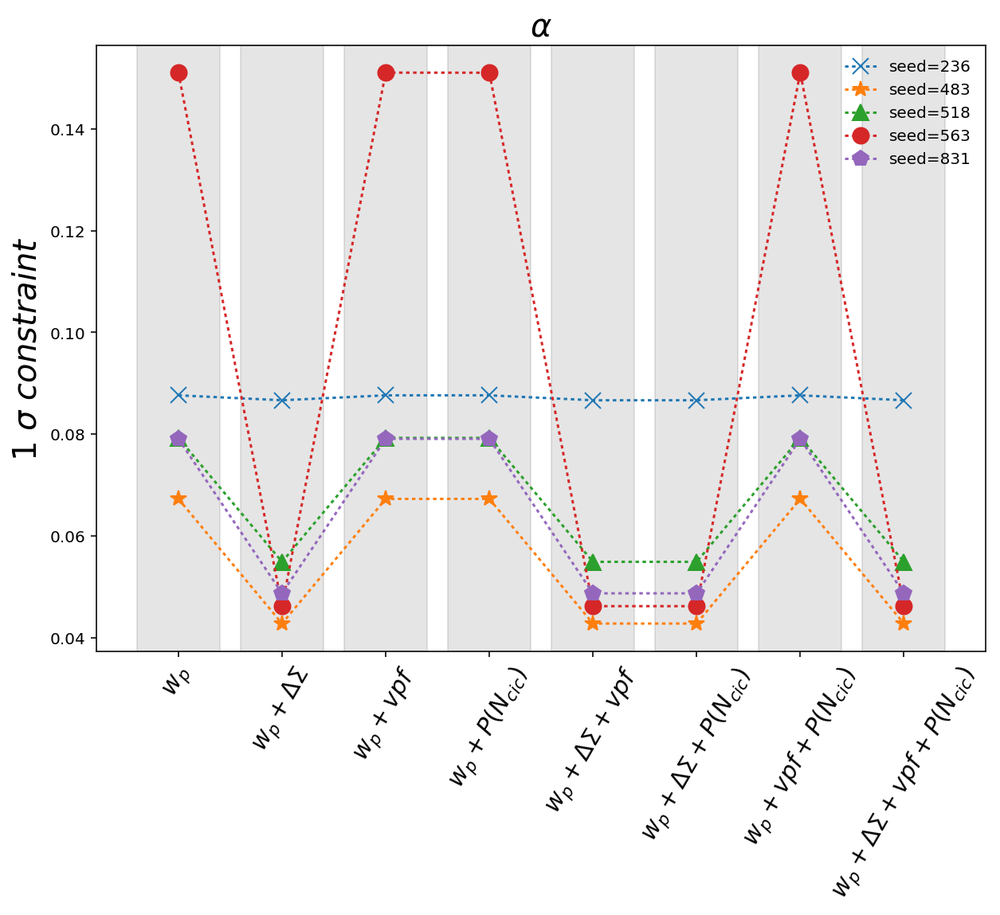

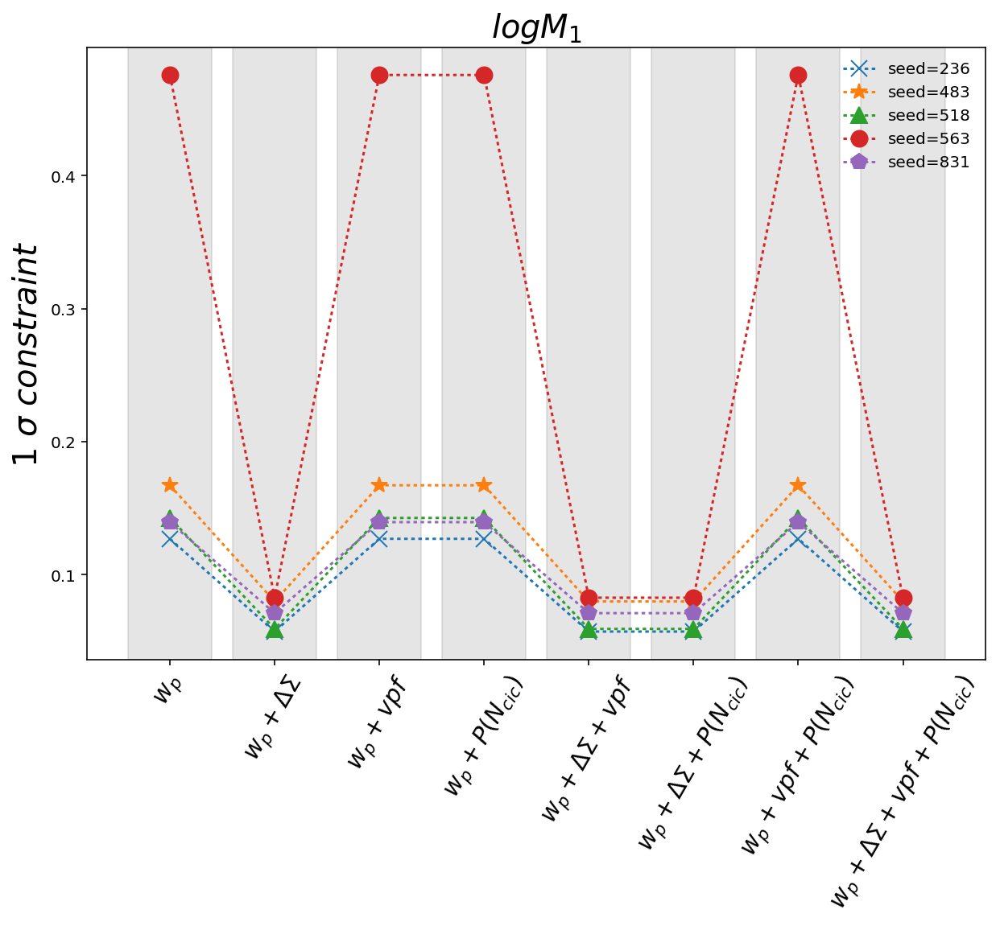

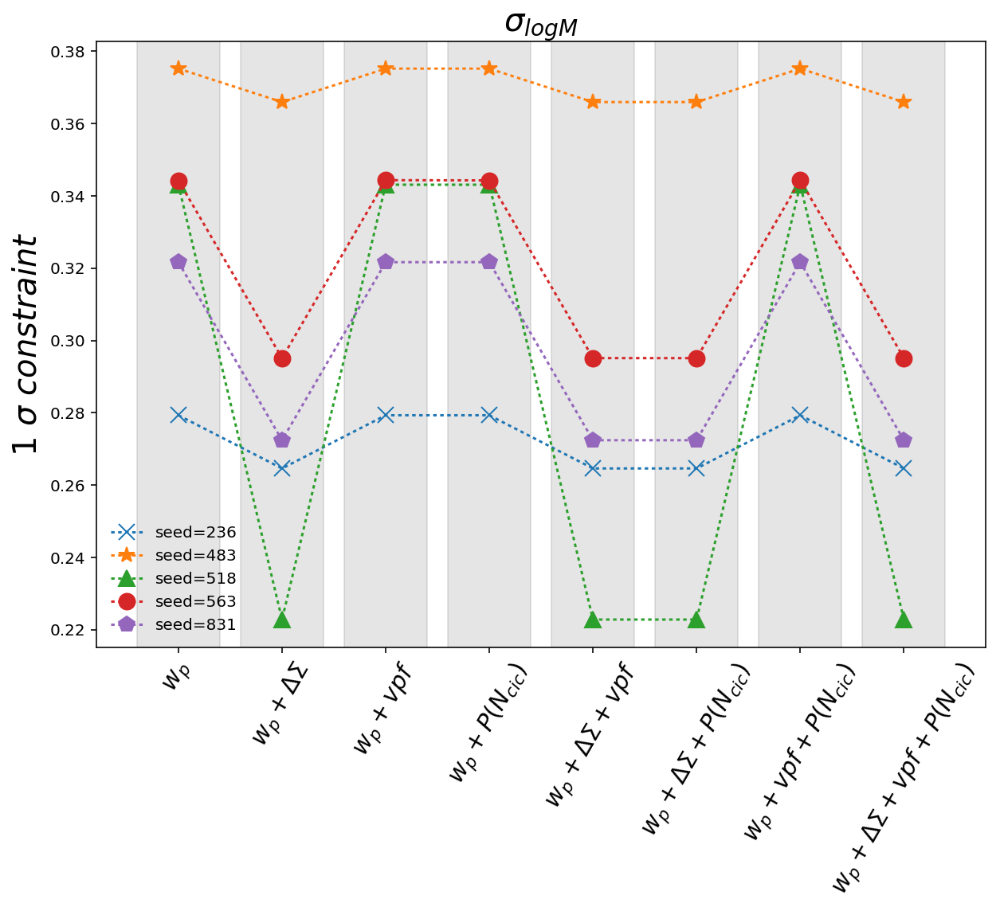

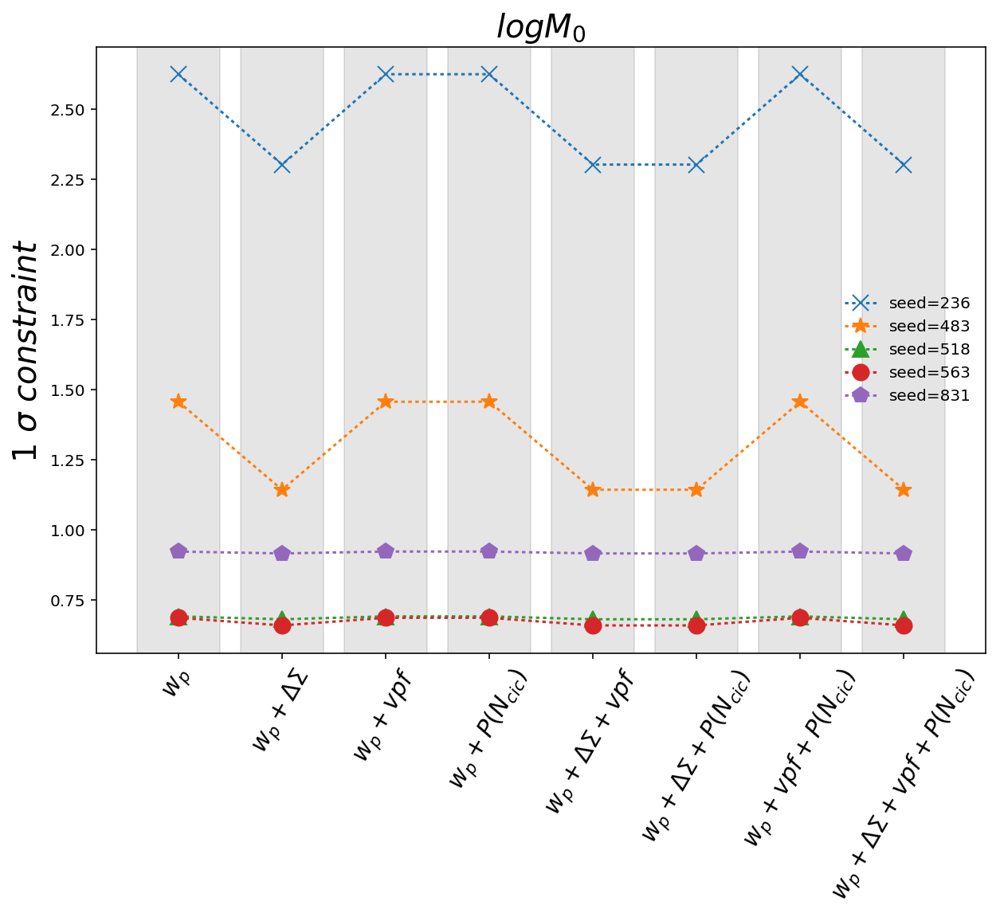

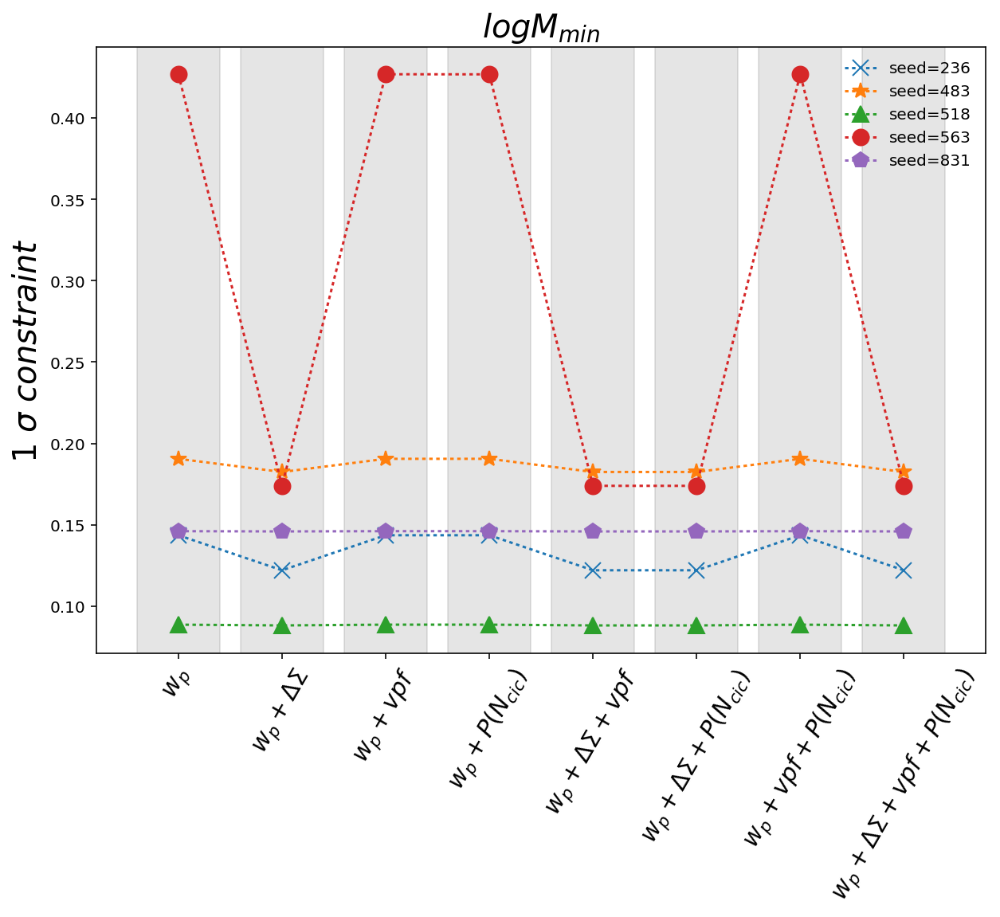

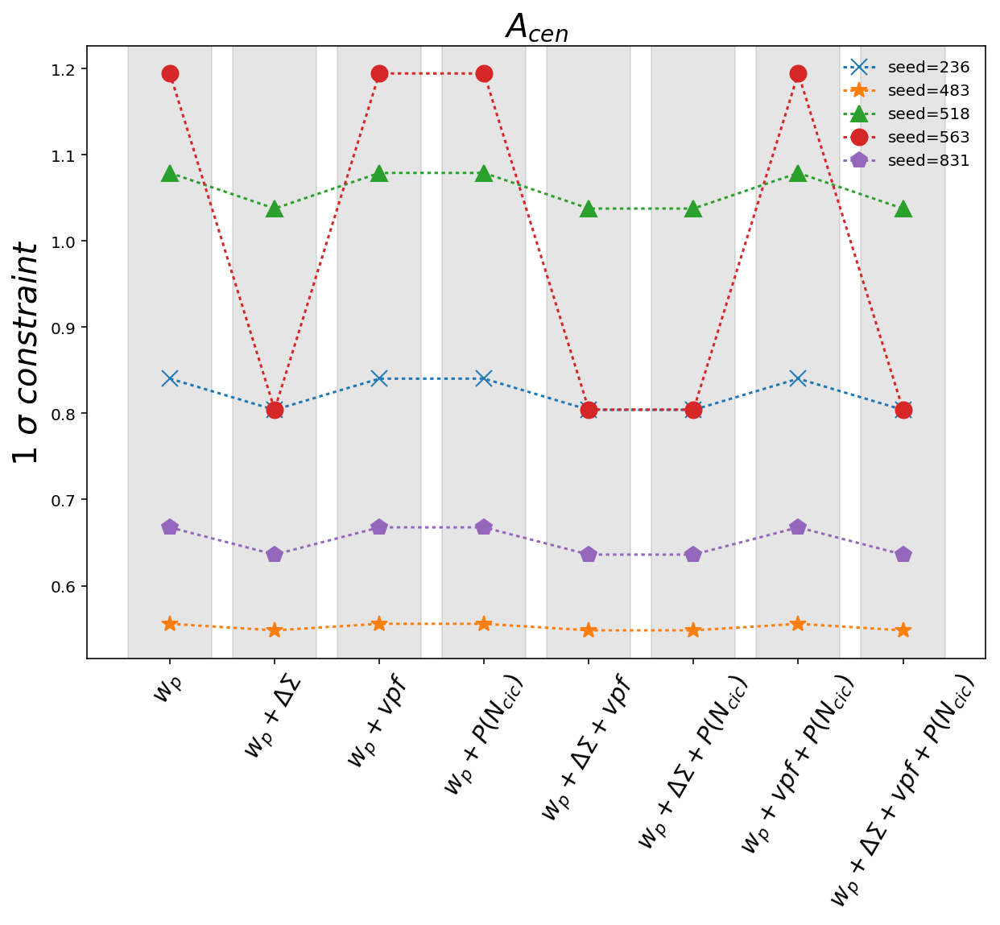

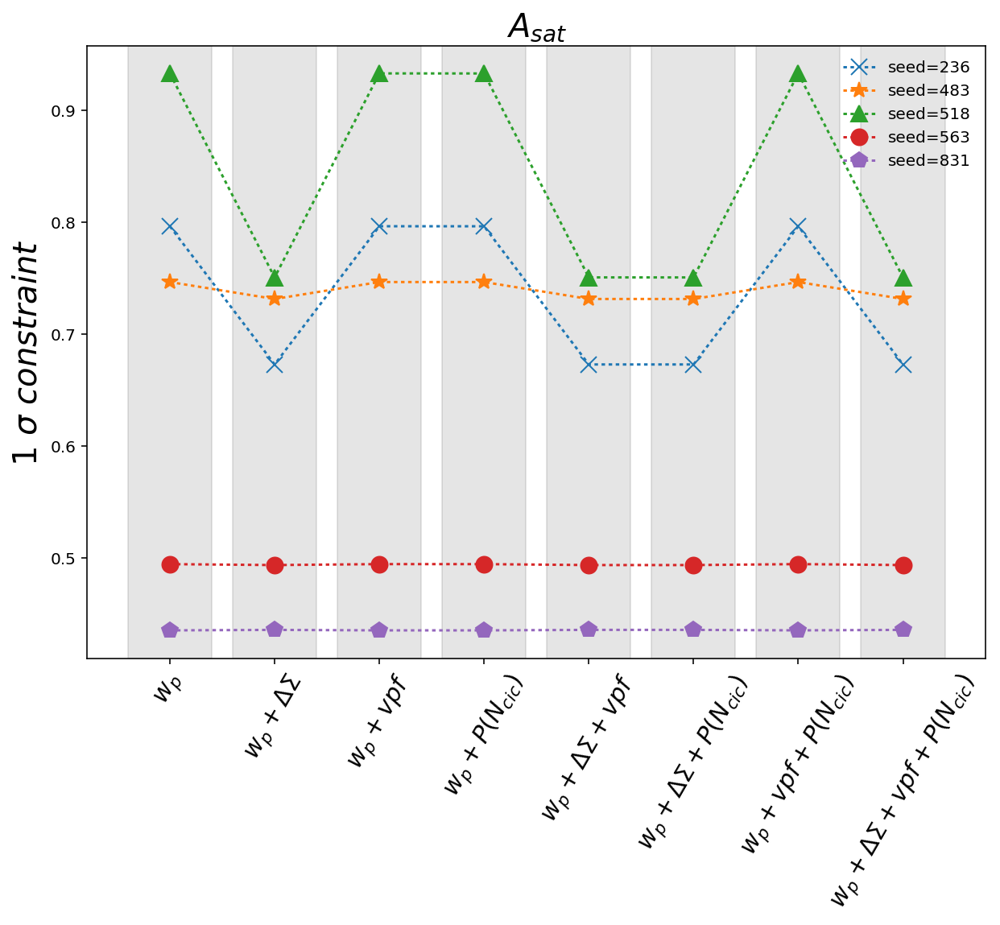

In [53]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236[:,i],'x:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483[:,i],'*:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518[:,i],'^:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563[:,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831[:,i],'p:',markersize=10,label='seed=831')
    plt.ylabel(r'$1\ \sigma\ constraint$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False)

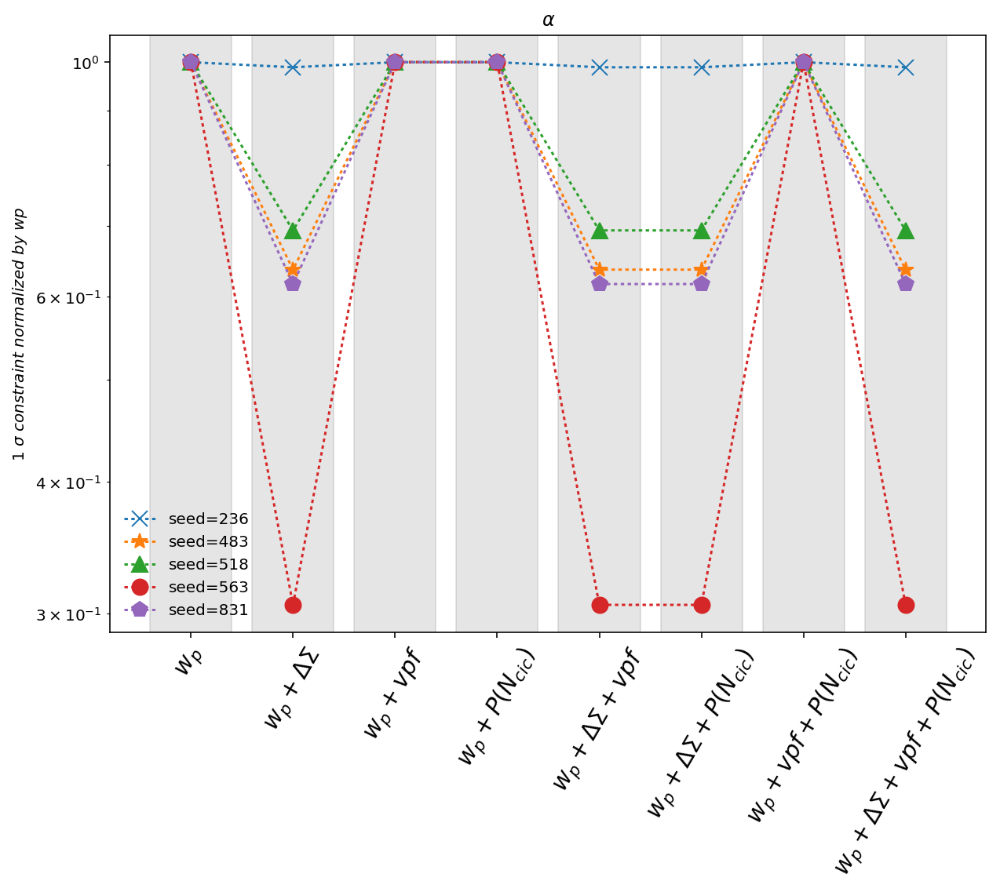

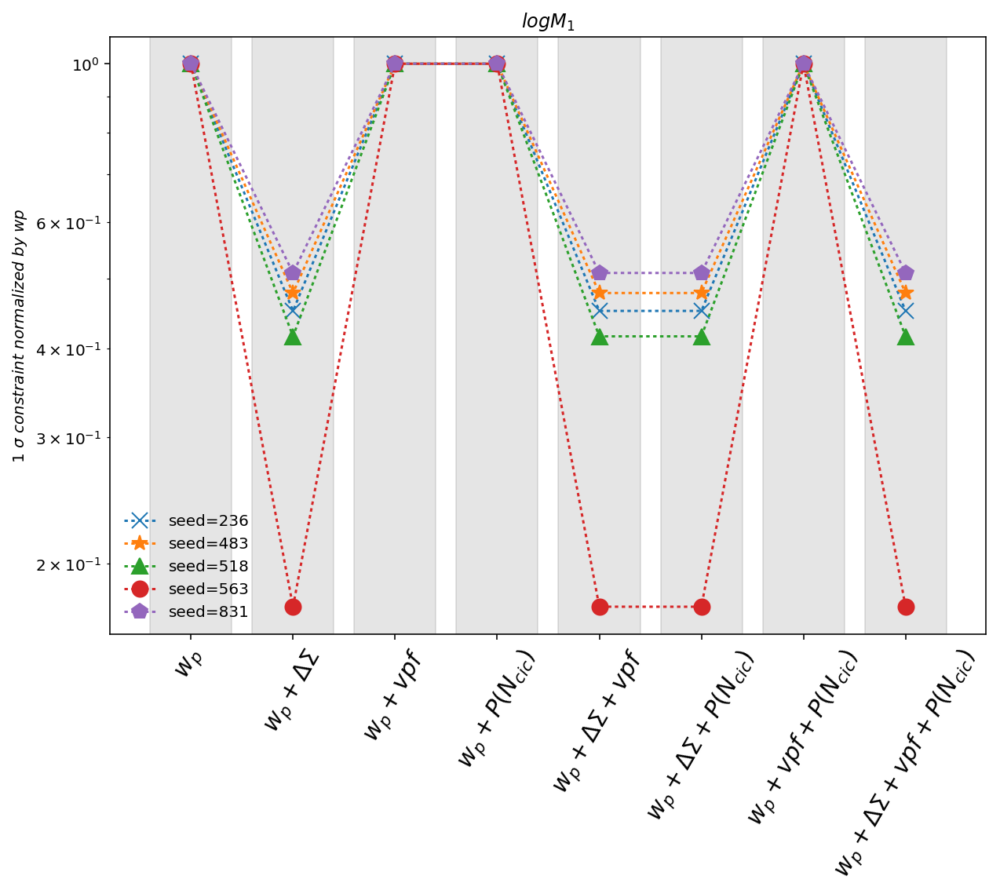

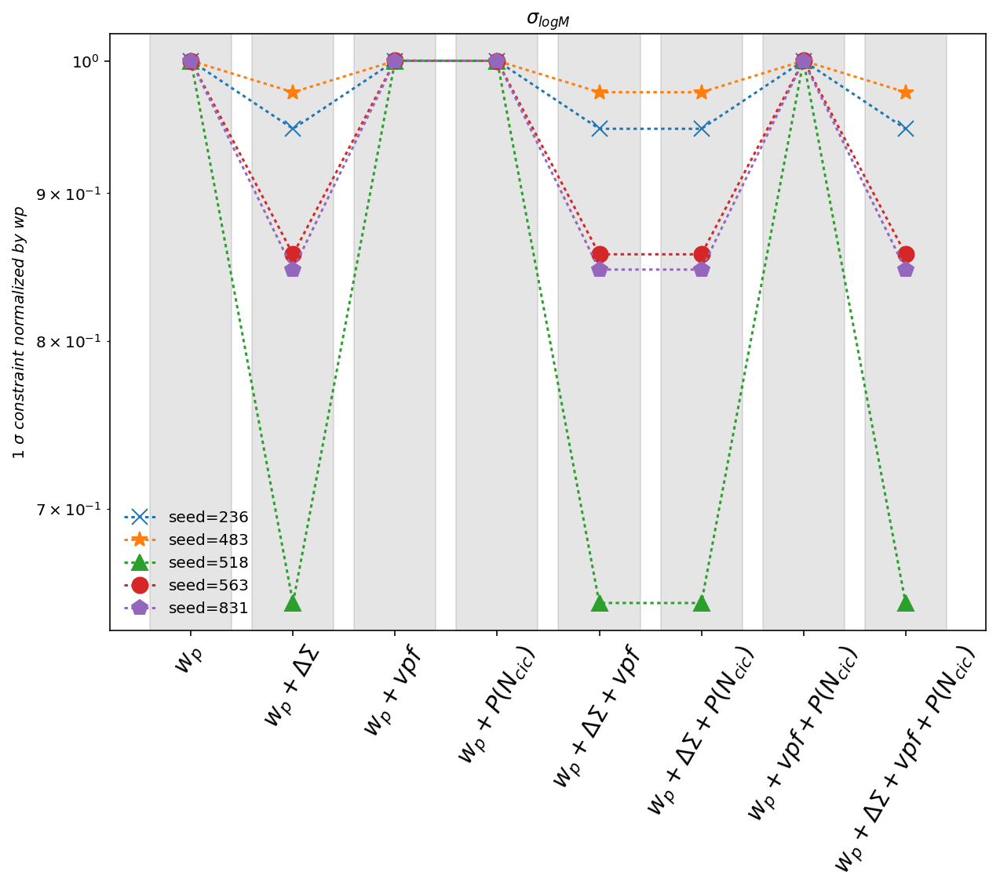

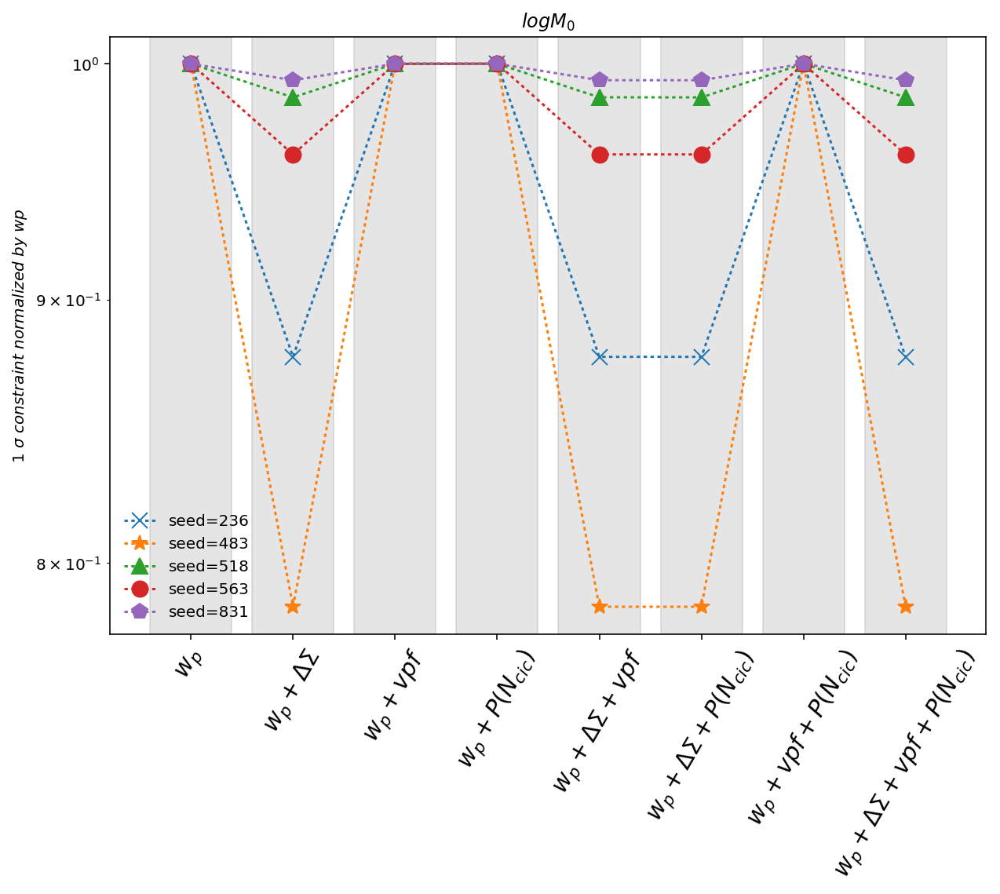

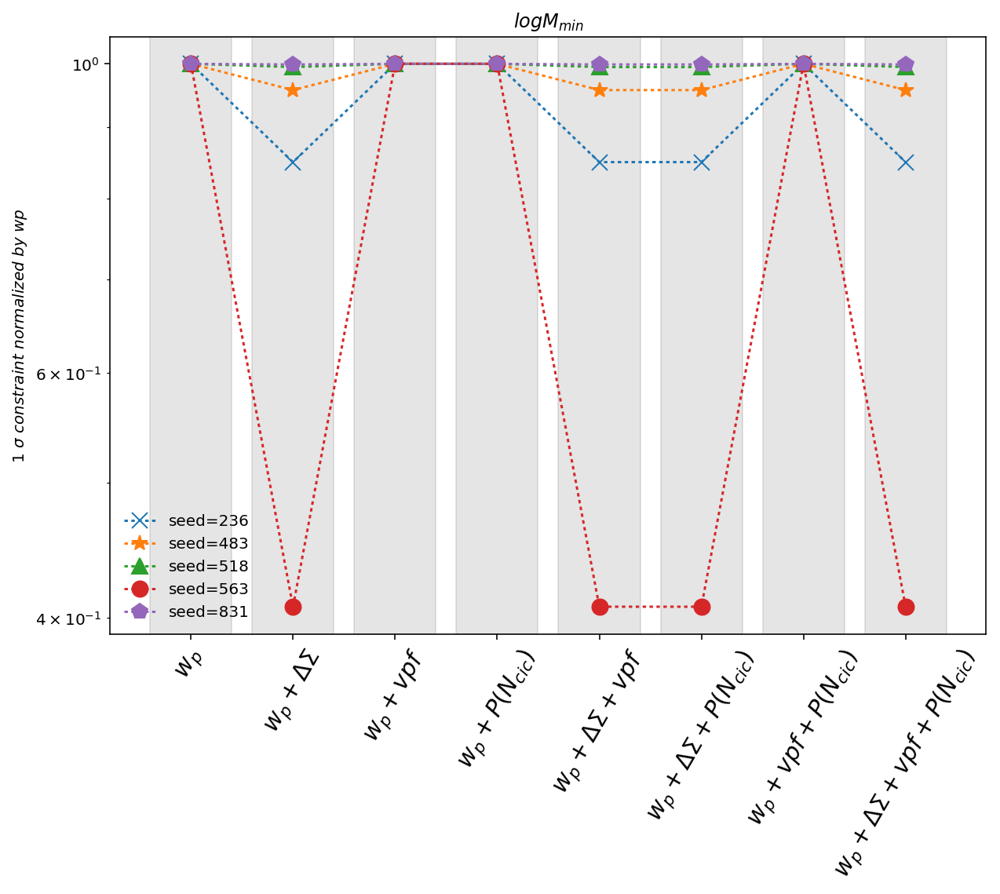

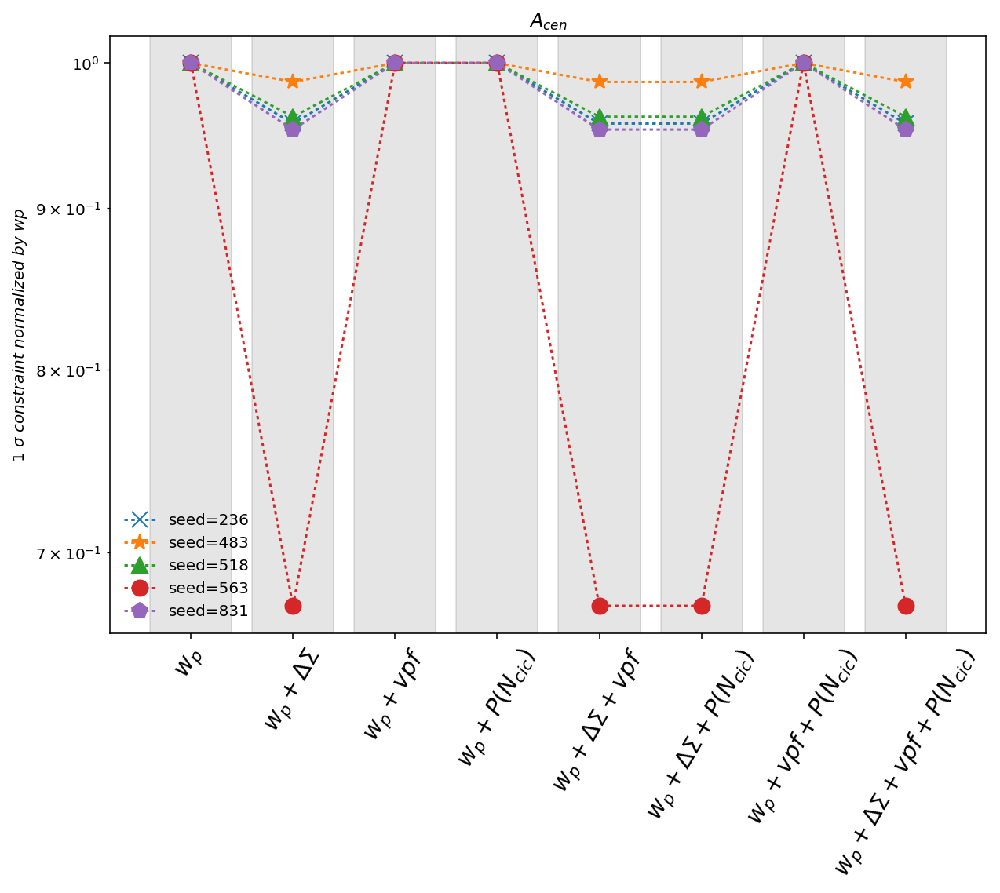

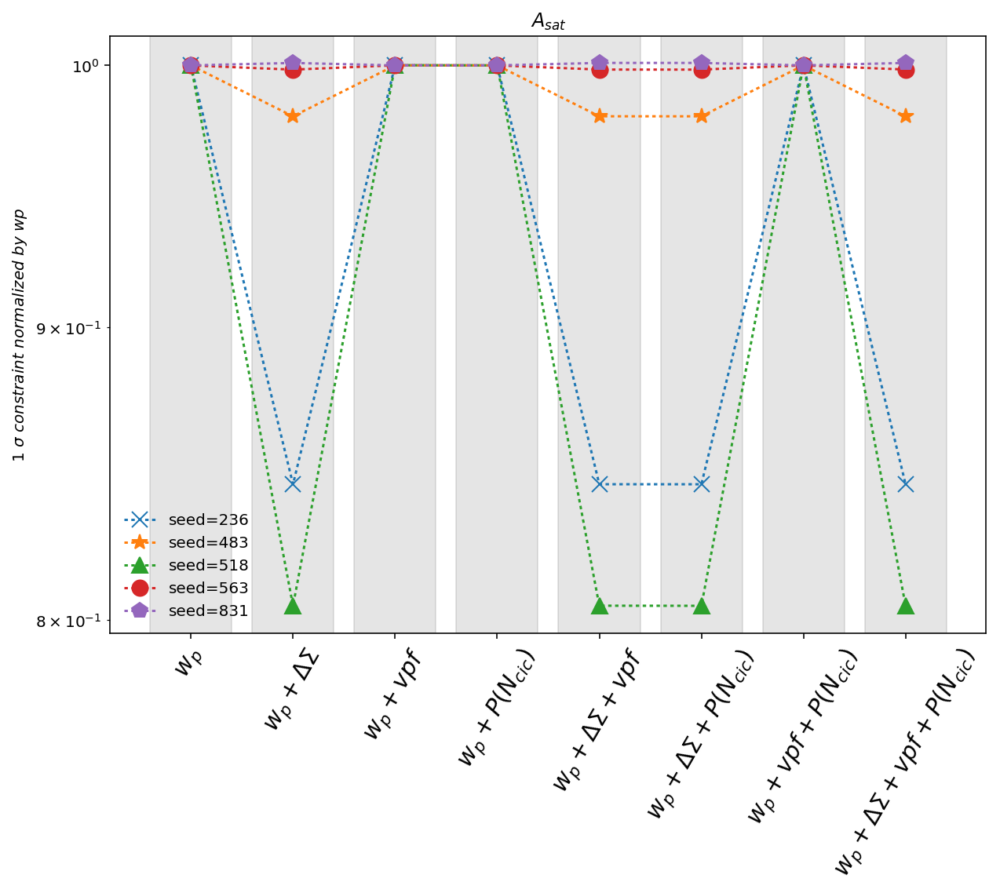

In [47]:
for i in range(7):
    plt.figure(figsize=(10,7))
    plt.title(param_list[i],fontsize=20)
    plt.xticks(range(1,9),comb_list,rotation=60,fontsize=15)
    plt.plot(range(1,9),all_1sigma_236[:,i]/all_1sigma_236[0,i],'x:',markersize=10,label='seed=236')
    plt.plot(range(1,9),all_1sigma_483[:,i]/all_1sigma_483[0,i],'*:',markersize=10,label='seed=483')
    plt.plot(range(1,9),all_1sigma_518[:,i]/all_1sigma_518[0,i],'^:',markersize=10,label='seed=518')
    plt.plot(range(1,9),all_1sigma_563[:,i]/all_1sigma_563[0,i],'o:',markersize=10,label='seed=563')
    plt.plot(range(1,9),all_1sigma_831[:,i]/all_1sigma_831[0,i],'p:',markersize=10,label='seed=831')
    plt.ylabel(r'$1\ \sigma\ constraint\ normalized\ by\ wp$',fontsize=20)
    plt.axvspan(0.6,1.4,color='grey',alpha=0.2)
    plt.axvspan(1.6,2.4,color='grey',alpha=0.2)
    plt.axvspan(2.6,3.4,color='grey',alpha=0.2)
    plt.axvspan(3.6,4.4,color='grey',alpha=0.2)
    plt.axvspan(4.6,5.4,color='grey',alpha=0.2)
    plt.axvspan(5.6,6.4,color='grey',alpha=0.2)
    plt.axvspan(6.6,7.4,color='grey',alpha=0.2)
    plt.axvspan(7.6,8.4,color='grey',alpha=0.2)
    plt.legend(frameon=False)
    plt.semilogy()